**Chadha SAKKA - M2 Calcul Haute Performance et simulation - 2024 / 2025**  

# Data & Apprentissage, M2CHPS 2023

## Assignments - Part 2

**Instructor:** [Argyris Kalogeratos](http://kalogeratos.com) (contact: argyris.kalogeratos@ens-paris-saclay.fr).  
**Sylabus:** [http://nvayatis.perso.math.cnrs.fr/CHPScourse.html](http://nvayatis.perso.math.cnrs.fr/CHPScourse.html)

The most updated version of this file can be found at instructor's webpage:  
[http://kalogeratos.com/MyCourses/DML-M2HPC/Assignments2.ipynb](http://kalogeratos.com/psite/files/MyCourses/DML-M2HPC/Assignments1.ipynb).

## 0. Before you start

* This assignement has already few exercises and  will be completed 2 weeks before the final deadline. You can start working on them and get any update as you go.
* Work on the assignment either alone or in a team of two (pair). Students that will work alone will benefit from a 15% bonus. Important: The point in working in a pair is not to split the work, but to collaborate!
* Prepare **a single jupiter notebook** in a report-like format for all the exercises. Use this notebook as a starting point and place your answers just below each exercise. Describe properly what you do in each step of your solution, followed by your well-commented code implementation that can automatically produce figures and numerical results. Results should also be well-commented and discussed. Your comments can be either in English or in French.
* If you need to provide mathematical expressions, incorporate all that in your notebook in a latex form (not handwritten!).
* Important: send your notebook that includes all your work and any additional files you used (e.g. datasets) at by email, with a title ``M2CHPS <year> - <Surname1> & <Surname2>``. The title of the notebook should have the surnames of the students. The body of the email should also mention the students' names and how they split the work; if you face difficulties in clarifying this with your classmate, please write separate emails with your views.
* Always use references for things you reuse (e.g. internet, forums, books, published papers, etc.)
* Do not copy-paste from the internet recipies that do the asked thing (or what is most usually observed: to use something relevant but not exactly what is asked). You need to understand what you use (sources should be properly referenced), adapt it to what each exercise asks for, and comment clearly the results. Poorly commented and explained pieces of work/code will not be taken seriously into account.
* Copying from one another is not acceptable. We are strict with that: cheating in even one exercise will incur **a zero to all projects** (not just one assignement) and possible disqualification from the exams. Your work will be cross-checked against anything similar submitted from past students of the course.
* The assignments will be examined orally at the end of the semester. Each group of students should be able to explain in about 10 mins all what they did, and answer short questions.
* **Deadline: midnight of Sunday 1/12.**
* **Late submissions:** the maximum possible grade is penalized by 5%/day. E.g. when delivering on time the best grade is 20/20, late submission by one day gets at best 19/20, for two days late of delay 18/20...  
* **Slot for questions: Friday 15/11 at 14h**. Zoom link: https://kalogeratos.com/zoom. Meeting ID: 243 940 6970 -- Passcode: 15881598

## Exercise 1 [15%]

A security system relies on a battery ($b$), two sensors ($c$ and $d$), and an alarm ($a$). The random variables $a$, $b$, $c$ are binary, and $a=1$ when the alarm fires, $b=1$ when the battery functions properly, and $c=1$ and $d=1$ when the respective sensor functions properly. Otherwise, each variable takes the value $0$.

The architecture of the system is as follows: the battery provides power with independent cables to the two sensors, and the sensors feed information to the alarm that can then fire to signify a threat. Each sensor can operate even with only its internal power source that it is equipped with, but in that case it becomes much more sensitive to fail compared to when the external battery is functioning normally.

The manual of the system says that the probability for the battery to fail is 0.1, and that each sensor fails with probability 0.01 when the battery is ok, and with 0.7 when the battery is not ok.

Additionally, the manual also informs us that if at least one sensor works fine, then the alarm fires with probability 0.02. Otherwise the alarm fires with 30 times higher probability.

**a)** Draw the graphical model of the system involving the random variables.

**b)** Compute the joint probabilities $p(a,b,c,d)$ and $p(a,c)$. Also check if $c$ and $d$ are independent.

**c)** Suppose **the alarm is silent** and that we check that **only the sensor $d$ works properly**. What is the posterior of having a disfunctioning battery?

**d)** Compute the probability for the alarm to be silent, $p(a=0)$.

**e)** We know that when at least one sensor works fine then the alarm fires with 0.02 (which let's suppose it is as much as as it is normal), otherwise with 0.6. We want to know how many sensors should the system have (connected like $c$ and $d$ in the initial design) such that the total probability $p(a=1) < 0.05$.

**f)** Suppose **we don't hear any alarm** (with good ears!) and **we have no information about the sensors** functioning. What is the probability for the battery to be disfunctioning?

**g)** Implement a function that generates observations from the probabilistic model at the top. Then make simulations to confirm empirically the estimations you calculated by hand.

## **Solution Exercise 1**
------
 **a) Drawing the Graphical Model**

 --------

**Dependencies:**

- The **battery b** affects both **sensors c** and **d**.
- The **alarm a** depends on the states of sensors **c** and **d**.

Graphical Model :

```
   b
  / \
 v   v
c     d
 \   /
  v v
   a
```
------
**b) Computing Joint Probabilities and Checking Independence between c and d :**

------
#### **Joint Probability $p(a, b, c, d)$:**

We use the chain rule for Bayesian network:

$p(a,b,c,d)=p(b)⋅p(c∣b)⋅p(d∣b)⋅p(a∣c,d)$

#### **Given Probabilities:**

   - Battery functions properly : $p(b = 1) = 0.9$
   - Battery fails : $p(b = 0) = 0.1$

   - When battery is ok b=1:
     - $p(c = 1 | b = 1) = 0.99$
     - $p(c = 0 | b = 1) = 0.01$
   - When battery fails:
     - $p(c = 1 | b = 0) = 0.3$
     - $p(c = 0 | b = 0) = 0.7$

 *Note :  Same probabilities apply for sensor d*

   - If **at least one sensor works** c = 1 or d =1:
     - $p(a = 1 | c  > =1, d >=1) = 0.02$
     - $p(a = 0 | c =0, d= 0) = 0.98$
   - If **both sensors fail** c = 0 and d = 0 :
     - $p(a = 1 | c = 0, d = 0) = 0.6$
     - $p(a = 0 | c = 0, d = 0) = 0.4$

#### **Computing $p(a = 1, b = 1, c = 1, d = 1)$ :**

We use the following probabilities:

$p(a=1 \mid c=1, d=1) = 0.02$

$p(c=1 \mid b=1) = 0.99$

$p(d=1 \mid b=1) = 0.99$

$p(b=1) = 0.9$

Using the formula for joint probability:

$p(a=1, b=1, c=1, d=1) = p(a=1 | c=1, d=1) \cdot p(c=1 | b=1) \cdot p(d=1 | b=1) \cdot p(b=1)$


We get :

\begin{align*}
p(a=1, b=1, c=1, d=1) = 0.02 \cdot 0.99 \cdot 0.99 \cdot 0.9
\end{align*}

\begin{align*}
p(a=1, b=1, c=1, d=1) = 0.0176
\end{align*}

Thus:

$p(a=1, b=1, c=1, d=1) \approx 0.0176$

## **Joint Probability Table:**

|  b |  c |  d |  a  |  p(a, b, c, d) |
|---------|---------|---------|---------|----------------------|
| 1       | 1       | 1       | 1       | 0.02 x 0.99 x 0.99 x 0.9 ≈ 0.0176  |
| 1       | 1       | 1       | 0       | 0.98 x 0.99 x 0.99 x 0.9 ≈ 0.8724 |
| 1       | 1       | 0       | 1       |  0.02 x 0.99 x 0.01 x 0.9 ≈ 0.0001782  |
| 1       | 1       | 0       | 0       |  0.98 x 0.99 x 0.01 x 0.9 ≈ 0.008762  |
| 1       | 0       | 1       | 1       | 0.02 x 0.01 x 0.99 x 0.9 ≈ 0.0001782 |
| 1       | 0       | 1       | 0       | 0.98 x 0.01 x 0.99 x 0.9 ≈ 0.008762 |
| 1       | 0       | 0       | 1       |  0.6 x 0.01 x 0.01 x 0.9 ≈ 0.000054  |
| 1       | 0       | 0       | 0       |  0.4 x 0.01 x 0.01 x 0.9 ≈ 0.000036 |
| 0       | 1       | 1       | 1       |  0.02 x 0.3 x 0.3 x 0.1 ≈ 0.0018  |
| 0       | 1       | 1       | 0       |  0.98 x 0.3 x 0.3 x 0.1 ≈ 0.00882 |
| 0       | 1       | 0       | 1       |  0.02 x 0.3 x 0.7 x 0.1 ≈ 0.00042  |
| 0       | 1       | 0       | 0       |  0.98 x 0.3 x 0.7 x 0.1 ≈ 0.02058  |
| 0       | 0       | 1       | 1       |  0.02 x 0.7 x 0.3 x 0.1 ≈ 0.00042  |
| 0       | 0       | 1       | 0       |  0.98 x 0.7 x 0.3 x 0.1 ≈ 0.02058  |
| 0       | 0       | 0       | 1       |  0.6 x 0.7 x 0.7 x 0.1 ≈ 0.0294  |
| 0       | 0       | 0       | 0       |  0.4 x 0.7 x 0.7 x 0.1 ≈ 0.0196  |



#### **Checking Independence of c and d :**

To check if c and d are independent, we compare $p(c, d)$ with $p(c).p(d)$.

\begin{align*}
p(c = 1) &= p(b = 1) \cdot p(c = 1 \mid b = 1) + p(b = 0) \cdot p(c = 1 \mid b = 0) \\
&= 0.9 \cdot 0.99 + 0.1 \cdot 0.3 \\
&= 0.891 + 0.03 = 0.921
\end{align*}

$p(d = 1) = p(c=1) = 0.921$


\begin{align*}
p(c = 1, d = 1) &= \sum_{b} p(b) \cdot p(c = 1 | b) \cdot p(d = 1 | b) \\
&= p(b = 1) \cdot 0.99 \cdot 0.99 + p(b = 0) \cdot 0.3 \cdot 0.3 \\
&= 0.9 \cdot 0.9801 + 0.1 \cdot 0.09 \\
&= 0.88209 + 0.009 = 0.89109
\end{align*}

$p(c = 1) \cdot p(d = 1) = 0.921 \cdot 0.921 = 0.848241$ **so c and d are not independent.**

-------
**c) Posterior Probability of a Dysfunctioning Battery Given Alarm is Silent and Only Sensor d Works**

-------

We want to compute the probability that the battery is malfunctioning $b = 0$ given that:

1. The alarm is silent $a = 0$.
2. Sensor d works $d = 1$.
3. Sensor c does not work $c = 0$.

This is written as $P(b=0 \mid a=0, d=1, c=0)$.

**Step 1: Bayes' Theorem**
\begin{align*}
P(b=0 \mid a=0, d=1, c=0) = \frac{P(a=0, d=1, c=0 \mid b=0) \cdot P(b=0)}{P(a=0, d=1, c=0)}
\end{align*}

**Step 2: Computing the Numerator**

$P(a=0, d=1, c=0 \mid b=0) = P(a=0 \mid d=1, c=0) \cdot P(d=1 \mid b=0) \cdot P(c=0 \mid b=0)$


- $P(a=0 \mid d=1, c=0) = 0.98$ (since at least one sensor works),
- $P(d=1 \mid b=0) = 0.3$,
- $P(c=0 \mid b=0) = 0.7$,
- $P(b=0) = 0.1$.

So, the numerator is:

$P(a=0, d=1, c=0 \mid b=0) \cdot P(b=0) = 0.98 \cdot 0.3 \cdot 0.7 \cdot 0.1 = 0.02058$

**Step 3: Computing the Denominator**

$P(a=0, d=1, c=0) = \sum_{b} P(a=0, d=1, c=0 \mid b) \cdot P(b)$

- For $b=1$:
  - $P(a=0 \mid d=1, c=0) = 0.98$,
  - $P(d=1 \mid b=1) = 0.99$,
  - $P(c=0 \mid b=1) = 0.01$,
  - $P(b=1) = 0.9$.

  So:

  $P(a=0, d=1, c=0 \mid b=1) \cdot P(b=1) = 0.98 \cdot 0.99 \cdot 0.01 \cdot 0.9 = 0.008762$

- For $b=0$:
  Already computed as $0.02058$.

So, the total denominator is:

$P(a=0, d=1, c=0) = 0.008762 + 0.02058 = 0.029342$

**Step 4: Computing the Posterior Probability**

Now:

$P(b=0 \mid a=0, d=1, c=0) = \frac{0.02058}{0.029342} \approx 0.701$

The probability that the battery is malfunctioning given that the alarm is silent and only sensor $d$ works is approximately **70.1%**.

------
**d) Calculating the Probability for the Alarm to be Silent $P(a = 0)$**


----


**Compute $P(\text{Both sensors fail})$ :**

$P(\text{Both fail}) = \sum_{b} P(b) \cdot P(c = 0 | b) \cdot P(d = 0 | b)$

**For b = 1 :**

\begin{align*}
P(b = 1) \cdot P(c = 0 | b = 1) \cdot P(d = 0 | b = 1) = 0.9 \cdot 0.01 \cdot 0.01 = 0.00009
\end{align*}

**For b = 0:**

\begin{align*}
P(b = 0) \cdot P(c = 0 | b = 0) \cdot P(d = 0 | b = 0) = 0.1 \cdot 0.7 \cdot 0.7 = 0.049
\end{align*}

**Total $P(\text{Both fail})$ :** $P_{\text{fail}} = 0.00009 + 0.049 = 0.04909$

**Compute $P(\text{At least one works})$:**

\begin{align*}
P_{\text{works}} = 1 - P_{\text{fail}} = 1 - 0.04909 = 0.95091
\end{align*}

 **Compute $P(a = 0)$:**

\begin{align*}
P(a = 0) &= P_{\text{works}} \cdot P(a = 0 \mid \text{At least one works}) + P_{\text{fail}} \cdot P(a = 0 \mid \text{Both fail}) \\
&= 0.95091 \cdot 0.98 + 0.04909 \cdot 0.4 \\
&= 0.931892 + 0.019636 = 0.951528
\end{align*}


**Answer:**

The probability that the alarm is silent is approximately **95.15%**.

-------
**e) Determining the Number of Sensors Needed such that $P(a = 1) < 0.05$**

-------------

**Step 1: Computing the Probability of a Sensor Failing:**

\begin{align*}
P(\text{Sensor fails}) &= P(b = 1) \cdot P(\text{Fails} \mid b = 1) + P(b = 0) \cdot P(\text{Fails} \mid b = 0) \\
&= 0.9 \cdot 0.01 + 0.1 \cdot 0.7 = 0.009 + 0.07 = 0.079
\end{align*}

**Step 2 :Computing $P(\text{All sensors fail})$:**

\begin{align*}
P_{\text{all fail}} = (P(\text{Sensor fails}))^n = (0.079)^n
\end{align*}

**Step 3 : Compute $P(a = 1)$:**

\begin{align*}
P(a = 1) = P_{\text{all fail}} \cdot 0.6 + (1 - P_{\text{all fail}}) \cdot 0.02 = 0.02 + 0.58 \cdot (0.079)^n
\end{align*}

**Step 4 : Set $P(a = 1) < 0.05$:**

\begin{align*}
0.02 + 0.58 \cdot (0.079)^n < 0.05
\end{align*}

*Subtract : 0.02*
\begin{align*}
0.58 \cdot (0.079)^n < 0.03
\end{align*}

*Divide:*

\begin{align*}
(0.079)^n < \frac{0.03}{0.58} \approx 0.051724
\end{align*}

*Take logarithms:*

\begin{align*}
n \cdot \ln(0.079) < \ln(0.051724)
\end{align*}

*Compute:*

- $ln(0.079) \approx -2.53897$
- $ln(0.051724) \approx -2.959$

\begin{align*}
n > \frac{2.959}{2.53897} \approx 1.1665
\end{align*}

**Answer:**

At least **2 sensors** are needed to ensure that $P(a = 1) < 0.05$.

---
**f) Calculating Probability of Battery Disfunction Given Silent Alarm $P(b = 0 | a = 0)$.**

-----

**Using Bayes' Theorem:**

\begin{align*}
P(b = 0 | a = 0) = \frac{P(a = 0 | b = 0) \cdot P(b = 0)}{P(a = 0)}
\end{align*}

We have $P(a = 0) = 0.951528$ from part **d**.

**Compute $P(a = 0 | b = 0)$:**

\begin{align*}
P(a = 0 | b = 0) = \sum_{c, d} P(c | b = 0) \cdot P(d | b = 0) \cdot P(a = 0 | c, d)
\end{align*}

**Compute probabilities for all combinations of c and d :**

- **When at least one sensor works $c + d \geq 1 $:**
  - $P(a = 0 \mid c, d) = 0.98$
- **When both sensors fail c = 0, d = 0:**
  - $P(a = 0 \mid c = 0, d = 0) = 0.4$

**Calculations:**

1. **c = 1, d = 1:**

   \begin{align*}
   P(c = 1 | b = 0) = 0.3, \quad P(d = 1 | b = 0) = 0.3
\\
   P = 0.3 \cdot 0.3 \cdot 0.98 = 0.0882
   \end{align*}

2. **c = 1, d = 0:**

   \begin{align*}
   P(c = 1 | b = 0) = 0.3, \quad P(d = 0 | b = 0) = 0.7
   \\
   P = 0.3 \cdot 0.7 \cdot 0.98 = 0.2058
   \end{align*}

3. **c = 0, d = 1:**

   \begin{align*}
   P(c = 0 | b = 0) = 0.7, \quad P(d = 1 \mid b = 0) = 0.3
   \\
   P = 0.7 \cdot 0.3 \cdot 0.98 = 0.2058
   \end{align*}

4. **c = 0, d = 0:**

   \begin{align*}
   P(c = 0 | b = 0) = 0.7, \quad P(d = 0 \mid b = 0) = 0.7
   \\
   P = 0.7 \cdot 0.7 \cdot 0.4 = 0.196
   \end{align*}

**Total $P(a = 0 | b = 0)$:**

\begin{align*}
P(a = 0 | b = 0) = 0.0882 + 0.2058 + 0.2058 + 0.196 = 0.6958
\end{align*}

#### **Compute $P(b = 0 | a = 0)$:**

\begin{align*}
P(b = 0 | a = 0) = \frac{0.6958 \cdot 0.1}{0.951528} \approx 0.07311
\end{align*}

**Answer:**

The probability that the battery is disfunctioning given that the alarm is silent is approximately **7.31%**.

---
**g) Implementing a Simulation Function**

--------

We will simulate the probabilistic model to confirm the calculated probabilities.

In [ ]:
import numpy as np

def simulate_security_system(num_trials=100000):
    # Probabilities
    P_b = 0.9  # P(b=1)
    P_c_given_b = {1: 0.99, 0: 0.3}  # P(c=1 | b)
    P_d_given_b = {1: 0.99, 0: 0.3}  # P(d=1 | b)
    P_a_given_sensors = lambda c, d: 0.02 if (c == 1 or d == 1) else 0.6

    # Initialize counters
    count_a0 = 0
    count_a1 = 0
    count_b0 = 0
    count_b1 = 0
    count_c0 = 0
    count_c1 = 0
    count_d0 = 0
    count_d1 = 0

    # Additional counters for specific parts
    # For Part c)
    count_a0_d1_c0_b0 = 0
    count_a0_d1_c0 = 0

    # For Part f)
    count_a0_b0 = 0
    count_a0 = 0

    for _ in range(num_trials):
        # Simulate battery
        b = np.random.choice([1, 0], p=[P_b, 1 - P_b])

        # Simulate sensors
        c = np.random.choice([1, 0], p=[P_c_given_b[b], 1 - P_c_given_b[b]])
        d = np.random.choice([1, 0], p=[P_d_given_b[b], 1 - P_d_given_b[b]])

        # Simulate alarm
        if c == 1 or d == 1:
            a = np.random.choice([1, 0], p=[0.02, 0.98])
        else:
            a = np.random.choice([1, 0], p=[0.6, 0.4])

        # Update counters
        if a == 0:
            count_a0 += 1
            if b == 0:
                count_a0_b0 += 1
            if d == 1 and c == 0:
                count_a0_d1_c0 += 1
                if b == 0:
                    count_a0_d1_c0_b0 += 1
        else:
            count_a1 += 1
        if b == 0:
            count_b0 += 1
        else:
            count_b1 += 1
        if c == 0:
            count_c0 += 1
        else:
            count_c1 += 1
        if d == 0:
            count_d0 += 1
        else:
            count_d1 += 1

    # Compute probabilities
    P_a0 = count_a0 / num_trials
    P_a1 = count_a1 / num_trials
    P_b0 = count_b0 / num_trials
    P_b1 = count_b1 / num_trials
    P_c0 = count_c0 / num_trials
    P_c1 = count_c1 / num_trials
    P_d0 = count_d0 / num_trials
    P_d1 = count_d1 / num_trials

    # For Part c): P(b=0 | a=0, d=1, c=0)
    P_b0_given_a0_d1_c0 = count_a0_d1_c0_b0 / count_a0_d1_c0 if count_a0_d1_c0 > 0 else 0

    # For Part f): P(b=0 | a=0)
    P_b0_given_a0 = count_a0_b0 / count_a0 if count_a0 > 0 else 0

    return {
        'P(a=0)': P_a0,
        'P(a=1)': P_a1,
        'P(b=0)': P_b0,
        'P(b=1)': P_b1,
        'P(c=0)': P_c0,
        'P(c=1)': P_c1,
        'P(d=0)': P_d0,
        'P(d=1)': P_d1,
        'P(b=0 | a=0, d=1, c=0)': P_b0_given_a0_d1_c0,
        'P(b=0 | a=0)': P_b0_given_a0
    }

# Run the simulation
results = simulate_security_system()

# Display results
print("Simulation Results:")
print(f"P(a=0) ≈ {results['P(a=0)']:.4f}")
print(f"P(a=1) ≈ {results['P(a=1)']:.4f}")
print(f"P(b=0) ≈ {results['P(b=0)']:.4f}")
print(f"P(b=1) ≈ {results['P(b=1)']:.4f}")
print(f"P(b=0 | a=0, d=1, c=0) ≈ {results['P(b=0 | a=0, d=1, c=0)']:.4f}")
print(f"P(b=0 | a=0) ≈ {results['P(b=0 | a=0)']:.4f}")


Simulation Results:
P(a=0) ≈ 0.9518
P(a=1) ≈ 0.0482
P(b=0) ≈ 0.0993
P(b=1) ≈ 0.9008
P(b=0 | a=0, d=1, c=0) ≈ 0.6818
P(b=0 | a=0) ≈ 0.0725


## Exercise 2 - [30%]

**Isolation Forests (IF)** are efficient in identifying global outliers. IF can provide with an outlier index for each datapoint included in a given dataset; let that be denoted by **IF_index**.

On the other hand, [**Local Outlier Factor (LOF)**](https://en.wikipedia.org/wiki/Local_outlier_factor) identifies efficiently local outliers, although it's computationally demanding for large datasets, and is theoretically weaker as dimensions grow larger due to relying on density-based calculations (recall the *curse of dimensionality*). Before giving the questions of the exercise, let's see the details of computing LOF (see the updated Lab3 file for technical explanations about how to compute LOF in practice).

For this exercise you are asked the following:

**a)** Implement your own version of LOF and demonstrate a comparison with the built-in version of scikit-learn using the example we saw in the lab. Plot in a meaningful way the differences between the LOF index you compute for each point and what the built-in version gives. (note: since there are different LOF variants, there is the possibility that your correct implementation may give slightly different index values, but this is ok).

**b)** Investigate and propose a way to combine LOF with IF. More specifically, a way to introduce to the computations of the LOF method the IF_index we mentioned at the top of the description.

**c)** Provide a meaningful demonstration with several examples that compare LOF, IF, and the hybrid LOF+IF.

**References:**
M.M. Breunig et al. [LOF: Identifying Density-Based Local Outliers](https://www.dbs.ifi.lmu.de/Publikationen/Papers/LOF.pdf), Proc. ACM SIGMOD Int. Conf. On Management of Data, 2000.

## **Solution Exercice 2 :**

-----
**a)** Implement your own version of LOF and demonstrate a comparison with the built-in version of scikit-learn using the example we saw in the lab. Plot in a meaningful way the differences between the LOF index you compute for each point and what the built-in version gives.

-----

 **Local Outlier Factor (LOF)** is a density-based method that identifies outliers by comparing the local density of a point to the densities of its neighbors. Points that have a significantly lower density than their neighbors are considered outliers.


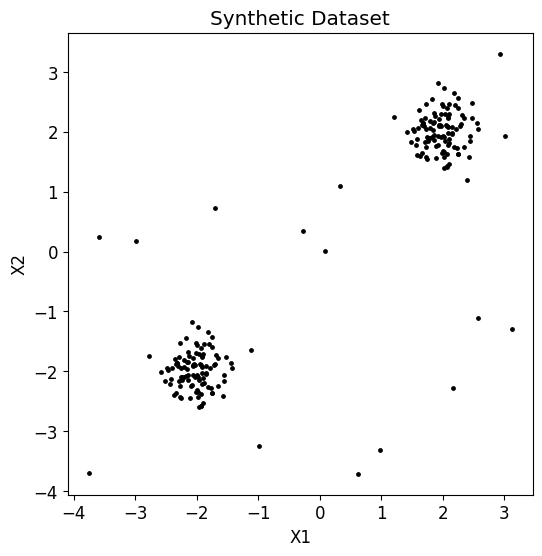

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Generate synthetic dataset
np.random.seed(42)

# Generate inliers
X_inliers = 0.3 * np.random.randn(100, 2)
X_inliers = np.r_[X_inliers + 2, X_inliers - 2]

# Generate outliers
X_outliers = np.random.uniform(low=-4, high=4, size=(20, 2))

# Combine the datasets
X = np.r_[X_inliers, X_outliers]

# Ground truth labels: 1 for inliers, -1 for outliers
n_outliers = len(X_outliers)
ground_truth = np.ones(len(X), dtype=int)
ground_truth[-n_outliers:] = -1

# Plot the dataset
plt.figure(figsize=(6, 6))
plt.title("Synthetic Dataset")
plt.scatter(X[:, 0], X[:, 1], s=6, color='k')
plt.xlabel('X1')
plt.ylabel('X2')
plt.show()


### **Understanding LOF: Step-by-Step :**

**1. k-Distance and k-Distance Neighborhood :**
For each point, identify its `k` nearest neighbors.

**2. Reachability Distance :**
For a point p and its neighbor o, the reachability distance is defined as:

\begin{align*}
\small
\text{reach-dist}_k(p, o) = \max \{ \text{k-distance}(o), \text{distance}(p, o) \}
\end{align*}
---

**3. Local Reachability Density (LRD) :**
The Local Reachability Density (LRD) is the inverse of the average reachability distance of a point p :

\begin{align*}
\text{LRD}_k(p) = \left( \frac{\sum_{o \in N_k(p)} \text{reach-dist}_k(p, o)}{|N_k(p)|} \right)^{-1}
\end{align*}

Where:
- $N_k(p)$ is the set of k-nearest neighbors of p.
- $\text{reach-dist}_k(p, o)$ is the reachability distance between p and its neighbor o.


**4. Local Outlier Factor LOF Score**
The Local Outlier Factor (LOF) Score compares the local reachability density of a point p with the local reachability densities of its neighbors:

\begin{align*}
\text{LOF}_k(p) = \frac{\sum_{o \in N_k(p)} \frac{\text{LRD}_k(o)}{\text{LRD}_k(p)}}{|N_k(p)|}
\end{align*}


**Interpretation of LOF Scores**
- $\text{LOF}_k(p) \sim 1$: The point p has a similar density as its neighbors (not an outlier).
- $\text{LOF}_k(p) < 1$: The point p has a higher density than its neighbors (inlier).
- $\text{LOF}_k(p) > 1$: The point p has a lower density than its neighbors (outlier).

----
The LOF algorithm detects local anomalies by:
1. Finding neighbors based on distance.
2. Measuring local density using reachability distances.
3. Comparing the density of each point to that of its neighbors.

----

**Manual Implementation from scratch of LOF**

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Compute pairwise Euclidean distances between points
def euclidean_distance_matrix(X):
    n = len(X)
    distances = np.zeros((n, n))
    for i in range(n):
        for j in range(i + 1, n):
            dist = np.linalg.norm(X[i] - X[j])
            distances[i, j] = dist
            distances[j, i] = dist
    return distances

# Find k-nearest neighbors and their distances
def compute_k_distance_and_neighbors(X, k):
    n = len(X)
    distances = euclidean_distance_matrix(X)
    noise = np.random.uniform(0, 1e-6, size=distances.shape)
    distances += noise  # Add small noise to break ties
    neighbors = np.argsort(distances, axis=1)[:, 1:k + 1]
    k_distances = np.take_along_axis(distances, neighbors, axis=1)[:, -1]
    return k_distances, neighbors

# Calculate reachability distances for neighbors
def compute_reachability_distance(distances, neighbors, k_distances):
    n = len(distances)
    reachability = np.zeros_like(distances)
    for i in range(n):
        for j in neighbors[i]:
            reachability[i, j] = max(k_distances[j], distances[i, j])
    return reachability

# Compute local reachability density
def compute_local_reachability_density(reachability, neighbors):
    n = len(reachability)
    lrd = np.zeros(n)
    for i in range(n):
        mean_reach_dist = np.mean(reachability[i, neighbors[i]])
        lrd[i] = 1.0 / (mean_reach_dist + 1e-10)
    return lrd

# Compute LOF scores
def compute_lof_scores(lrd, neighbors):
    lof_scores = []
    for i in range(len(lrd)):
        ratios = lrd[neighbors[i]] / lrd[i]
        lof_scores.append(np.mean(ratios))
    return np.array(lof_scores)

# Main function to compute LOF scores
def lof_from_scratch(X, k):
    k_distances, neighbors = compute_k_distance_and_neighbors(X, k)
    distances = euclidean_distance_matrix(X)
    reachability = compute_reachability_distance(distances, neighbors, k_distances)
    lrd = compute_local_reachability_density(reachability, neighbors)
    lof_scores = compute_lof_scores(lrd, neighbors)
    return lof_scores


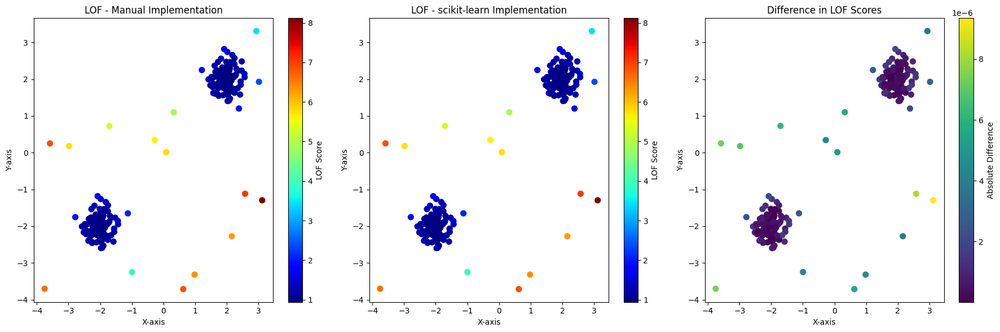

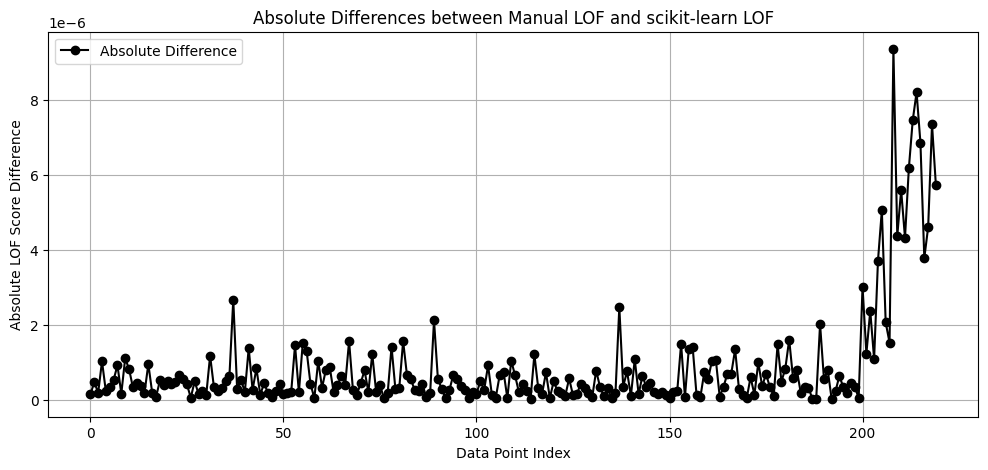

In [ ]:
import numpy as np
from sklearn.neighbors import LocalOutlierFactor
import matplotlib.pyplot as plt

# Set seed for consistent results
np.random.seed(42)

# Generate normal data around two centers
normal_data = 0.3 * np.random.randn(100, 2)
normal_data = np.vstack([normal_data + 2, normal_data - 2])

# Generate anomalies scattered randomly
anomalies = np.random.uniform(low=-4, high=4, size=(20, 2))

# Combine normal data and anomalies
X = np.vstack([normal_data, anomalies])

# Parameters for LOF
k = 20
contamination = 0.1  # 10% anomalies assumed

# Manual LOF calculation
lof_scores_manual = lof_from_scratch(X, k)

# scikit-learn LOF calculation
clf = LocalOutlierFactor(n_neighbors=k, contamination=contamination, algorithm='auto', metric='euclidean')
clf.fit(X)  # Fit the model to the dataset
lof_scores_sklearn = -clf.negative_outlier_factor_

# Plotting LOF scores from manual implementation and scikit-learn

plt.figure(figsize=(18, 6))

# Manual Implementation Visualization
plt.subplot(1, 3, 1)
plt.title("LOF - Manual Implementation")
scatter = plt.scatter(X[:, 0], X[:, 1], c=lof_scores_manual, cmap='jet', s=50)
plt.colorbar(scatter, label="LOF Score")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")

# scikit-learn Implementation Visualization
plt.subplot(1, 3, 2)
plt.title("LOF - scikit-learn Implementation")
scatter = plt.scatter(X[:, 0], X[:, 1], c=lof_scores_sklearn, cmap='jet', s=50)
plt.colorbar(scatter, label="LOF Score")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")

# Difference Visualization
differences = np.abs(lof_scores_manual - lof_scores_sklearn)
plt.subplot(1, 3, 3)
plt.title("Difference in LOF Scores")
scatter = plt.scatter(X[:, 0], X[:, 1], c=differences, cmap='viridis', s=50)
plt.colorbar(scatter, label="Absolute Difference")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")

plt.tight_layout()
plt.show()

# Additional Plot: Absolute Differences
plt.figure(figsize=(12, 5))
plt.plot(differences, marker='o', linestyle='-', color='k', label='Absolute Difference')
plt.title("Absolute Differences between Manual LOF and scikit-learn LOF")
plt.xlabel("Data Point Index")
plt.ylabel("Absolute LOF Score Difference")
plt.legend()
plt.grid(True)
plt.show()


### Results Analysis

The manual implementation of LOF closely matches the results from scikit-learn, as shown by the nearly identical patterns in the first two subplots, proving that it replicates the LOF method effectively. Minor differences in scores, visible in the third subplot and line plot, are due to added noise and small numerical variations but are generally insignificant. Both methods successfully detect outliers, with anomalies showing higher LOF scores. Overall, the manual implementation is accurate and performs almost the same as scikit-learn, with only slight variations from implementation details.

###### References

- **Lab 3 Materials:** Details on LOF computation.
- **Breunig et al.:** "LOF: Identifying Density-Based Local Outliers" (2000).
- **scikit-learn Documentation:** LocalOutlierFactor implementation and usage.


---
**b)** Investigate and propose a way to combine LOF with IF. More specifically, a way to introduce to the computations of the LOF method the IF_index we mentioned at the top of the description.

------

**Isolation Forest (IF):** This method finds anomalies with the logic that  : outliers are easier to isolate than normal points. It assigns each data point an anomaly index ( IF score),where a point with higher scores mean is more likely to be considered as an outlier.


**Objective:** We will integrate the global outlier detection capabilities of Isolation Forest (IF) into the Local Outlier Factor (LOF) method to improve anomaly detection.

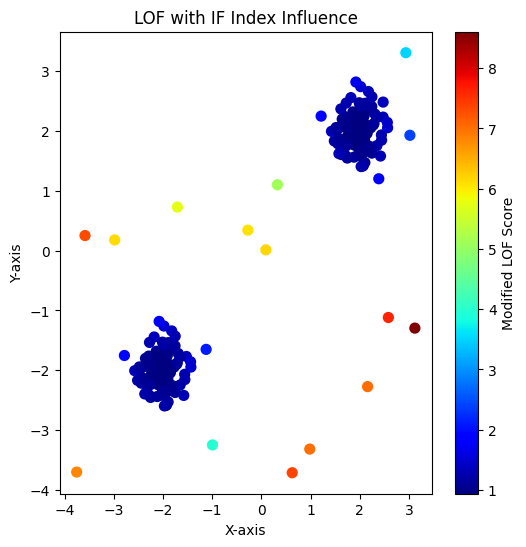

In [ ]:
import numpy as np
from sklearn.ensemble import IsolationForest
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

# Helper function to compute pairwise Euclidean distances
def euclidean_distance_matrix(X):
    n = len(X)
    distances = np.zeros((n, n))
    for i in range(n):
        for j in range(i + 1, n):  # Compute only the upper triangle
            dist = np.linalg.norm(X[i] - X[j])
            distances[i, j] = dist
            distances[j, i] = dist  # Symmetry
    return distances

# Compute neighbors and k-distances
def compute_k_distance_and_neighbors(X, k):
    distances = euclidean_distance_matrix(X)
    distances += np.random.uniform(0, 1e-6, size=distances.shape)  # Add noise
    neighbors = np.argsort(distances, axis=1)[:, 1:k + 1]
    k_distances = np.take_along_axis(distances, neighbors, axis=1)[:, -1]
    return distances, k_distances, neighbors

# Reachability distances adjusted for k-distance
def compute_reachability_distance(distances, neighbors, k_distances):
    reachability = np.zeros_like(distances)
    for i in range(len(distances)):
        for j in neighbors[i]:
            reachability[i, j] = max(k_distances[j], distances[i, j])
    return reachability

# Compute Local Reachability Density (LRD)
def compute_local_reachability_density(reachability, neighbors):
    lrd = np.zeros(len(reachability))
    for i in range(len(reachability)):
        mean_reach_dist = np.mean(reachability[i, neighbors[i]])
        lrd[i] = 1.0 / (mean_reach_dist + 1e-10)  # Avoid division by zero
    return lrd

# Compute LOF scores
def compute_lof_scores(lrd, neighbors):
    return np.array([np.mean(lrd[neighbors[i]] / lrd[i]) for i in range(len(lrd))])

# Compute Isolation Forest (IF) index
def compute_if_index(X, contamination_fraction):
    iso_forest = IsolationForest(contamination=contamination_fraction, random_state=42)
    iso_forest.fit(X)
    if_index = -iso_forest.decision_function(X)
    return (if_index - if_index.min()) / (if_index.max() - if_index.min())  # Normalize

# Modify reachability distances using IF index
def compute_modified_reachability_distance(reachability, neighbors, if_index, gamma):
    modified_reachability = np.zeros_like(reachability)
    for i in range(len(reachability)):
        for j in neighbors[i]:
            modified_reachability[i, j] = reachability[i, j] * (1 + gamma * if_index[j])
    return modified_reachability

# LOF with IF influence
def lof_with_if(X, k, gamma, contamination_fraction):
    if_index = compute_if_index(X, contamination_fraction)  # Step 1: Compute IF index
    distances, k_distances, neighbors = compute_k_distance_and_neighbors(X, k)  # Step 2
    reachability = compute_reachability_distance(distances, neighbors, k_distances)  # Step 3
    reachability_modified = compute_modified_reachability_distance(reachability, neighbors, if_index, gamma)  # Step 4
    lrd = compute_local_reachability_density(reachability_modified, neighbors)  # Step 5
    return compute_lof_scores(lrd, neighbors)  # Step 6

# Main execution and visualization
if __name__ == "__main__":
    np.random.seed(42)

    # Generate synthetic data
    normal_data = 0.3 * np.random.randn(100, 2)
    normal_data = np.vstack([normal_data + 2, normal_data - 2])
    anomalies = np.random.uniform(low=-4, high=4, size=(20, 2))
    X = np.vstack([normal_data, anomalies])

    # Parameters for LOF with IF
    k = 20
    gamma = 0.5
    contamination_fraction = 0.1

    # Compute LOF scores with IF influence
    lof_scores = lof_with_if(X, k, gamma, contamination_fraction)

    # Plot results
    plt.figure(figsize=(6, 6))
    plt.title("LOF with IF Index Influence")
    scatter = plt.scatter(X[:, 0], X[:, 1], c=lof_scores, cmap='jet', s=50)
    plt.colorbar(scatter, label='Modified LOF Score')
    plt.xlabel("X-axis")
    plt.ylabel("Y-axis")
    plt.show()


-----
**c)** Demonstration Comparing LOF, IF, and the Hybrid LOF+IF
Objective

--------

We will:
- Use synthetic datasets with different characteristics.
- Apply each method to detect outliers.
- Visualize and compare the results.
- Analyze the performance and behavior of each method.


**Dataset 1 : Two Clusters with Outliers**

Processing Dataset 1 : Two culsters with outliers 


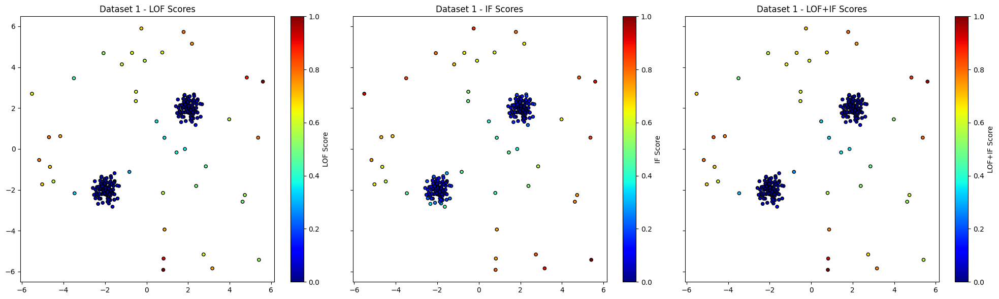

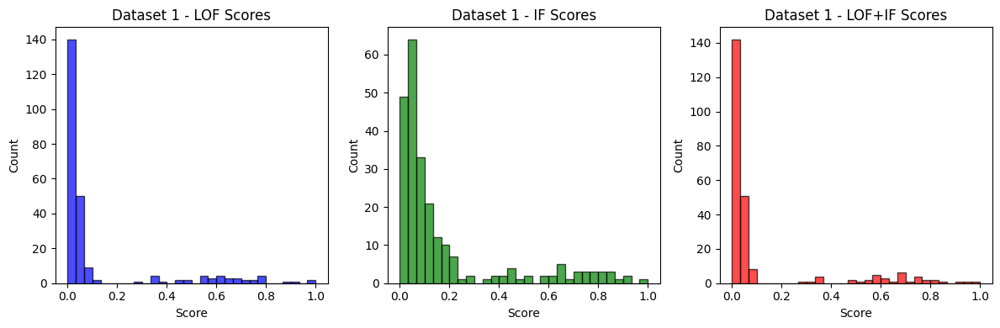

In [ ]:

# Dataset 1
print("Processing Dataset 1 : Two culsters with outliers ")

# Generate data for Dataset 1
X1_inliers = 0.3 * np.random.randn(100, 2)
X1_inliers = np.vstack([X1_inliers + 2, X1_inliers - 2])
X1_outliers = np.random.uniform(low=-6, high=6, size=(40, 2))
X1 = np.vstack([X1_inliers, X1_outliers])

# Scale the dataset
scaler1 = StandardScaler()
X1_scaled = scaler1.fit_transform(X1)

# LOF scores
lof1 = LocalOutlierFactor(n_neighbors=20, contamination=0.1)
lof1.fit(X1_scaled)
lof_scores1 = -lof1.negative_outlier_factor_

# IF scores
iso_forest1 = IsolationForest(contamination=0.1, random_state=42)
iso_forest1.fit(X1_scaled)
if_scores1 = -iso_forest1.decision_function(X1_scaled)

# Combined LOF+IF scores
lof_if_scores1 = lof_with_if(X1_scaled, k=20, gamma=0.5, contamination_fraction=0.1)

# Normalize scores for visualization
lof_scores1_norm = (lof_scores1 - lof_scores1.min()) / (lof_scores1.max() - lof_scores1.min())
if_scores1_norm = (if_scores1 - if_scores1.min()) / (if_scores1.max() - if_scores1.min())
lof_if_scores1_norm = (lof_if_scores1 - lof_if_scores1.min()) / (lof_if_scores1.max() - lof_if_scores1.min())

# Scatter plots for each score type
fig, axes = plt.subplots(1, 3, figsize=(20, 6), sharex=True, sharey=True)

# LOF Scores
scatter1 = axes[0].scatter(X1[:, 0], X1[:, 1], c=lof_scores1_norm, cmap="jet", s=20, edgecolor="k")
axes[0].set_title("Dataset 1 - LOF Scores")
plt.colorbar(scatter1, ax=axes[0], label="LOF Score")

# IF Scores
scatter2 = axes[1].scatter(X1[:, 0], X1[:, 1], c=if_scores1_norm, cmap="jet", s=20, edgecolor="k")
axes[1].set_title("Dataset 1 - IF Scores")
plt.colorbar(scatter2, ax=axes[1], label="IF Score")

# LOF+IF Scores
scatter3 = axes[2].scatter(X1[:, 0], X1[:, 1], c=lof_if_scores1_norm, cmap="jet", s=20, edgecolor="k")
axes[2].set_title("Dataset 1 - LOF+IF Scores")
plt.colorbar(scatter3, ax=axes[2], label="LOF+IF Score")

plt.tight_layout()
plt.show()

# Histograms for each score type
plt.figure(figsize=(12, 4))

# LOF Scores Histogram
plt.subplot(1, 3, 1)
plt.hist(lof_scores1_norm, bins=30, color="blue", alpha=0.7, edgecolor="black")
plt.title("Dataset 1 - LOF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

# IF Scores Histogram
plt.subplot(1, 3, 2)
plt.hist(if_scores1_norm, bins=30, color="green", alpha=0.7, edgecolor="black")
plt.title("Dataset 1 - IF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

# LOF+IF Scores Histogram
plt.subplot(1, 3, 3)
plt.hist(lof_if_scores1_norm, bins=30, color="red", alpha=0.7, edgecolor="black")
plt.title("Dataset 1 - LOF+IF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

plt.tight_layout()
plt.show()


**Dataset 2 : Two Intersecting Circles with Outliers**

Processing Dataset 3: Two Intersecting Circles with Outliers


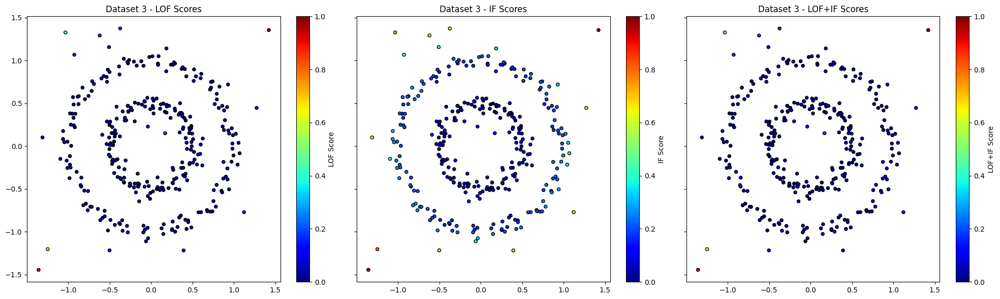

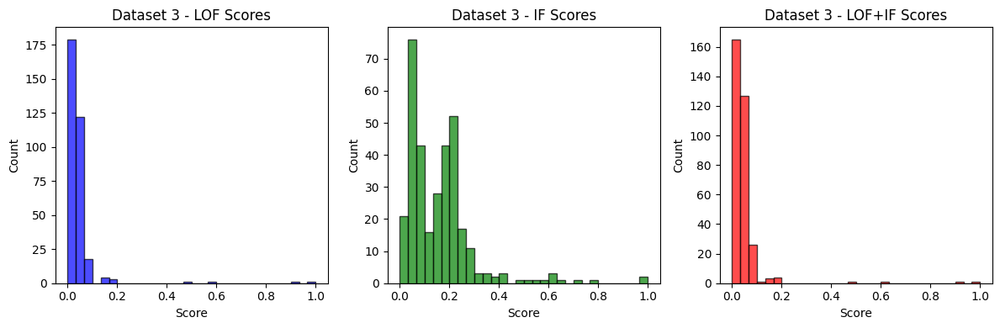

In [ ]:
from sklearn.datasets import make_circles

# Dataset 3
print("Processing Dataset 3: Two Intersecting Circles with Outliers")

# Generate data for Dataset 3
X3_inliers, _ = make_circles(n_samples=300, noise=0.05, factor=0.5, random_state=42)
X3_outliers = np.random.uniform(low=-1.5, high=1.5, size=(30, 2))
X3 = np.vstack([X3_inliers, X3_outliers])

# Scale the dataset
scaler3 = StandardScaler()
X3_scaled = scaler3.fit_transform(X3)

# LOF scores
lof3 = LocalOutlierFactor(n_neighbors=20, contamination=0.1)
lof3.fit(X3_scaled)
lof_scores3 = -lof3.negative_outlier_factor_

# IF scores
iso_forest3 = IsolationForest(contamination=0.1, random_state=42)
iso_forest3.fit(X3_scaled)
if_scores3 = -iso_forest3.decision_function(X3_scaled)

# Combined LOF+IF scores
lof_if_scores3 = lof_with_if(X3_scaled, k=20, gamma=0.5, contamination_fraction=0.1)

# Normalize scores for visualization
lof_scores3_norm = (lof_scores3 - lof_scores3.min()) / (lof_scores3.max() - lof_scores3.min())
if_scores3_norm = (if_scores3 - if_scores3.min()) / (if_scores3.max() - if_scores3.min())
lof_if_scores3_norm = (lof_if_scores3 - lof_if_scores3.min()) / (lof_if_scores3.max() - lof_if_scores3.min())

# Scatter plots for each score type
fig, axes = plt.subplots(1, 3, figsize=(20, 6), sharex=True, sharey=True)

# LOF Scores
scatter1 = axes[0].scatter(X3[:, 0], X3[:, 1], c=lof_scores3_norm, cmap="jet", s=20, edgecolor="k")
axes[0].set_title("Dataset 3 - LOF Scores")
plt.colorbar(scatter1, ax=axes[0], label="LOF Score")

# IF Scores
scatter2 = axes[1].scatter(X3[:, 0], X3[:, 1], c=if_scores3_norm, cmap="jet", s=20, edgecolor="k")
axes[1].set_title("Dataset 3 - IF Scores")
plt.colorbar(scatter2, ax=axes[1], label="IF Score")

# LOF+IF Scores
scatter3 = axes[2].scatter(X3[:, 0], X3[:, 1], c=lof_if_scores3_norm, cmap="jet", s=20, edgecolor="k")
axes[2].set_title("Dataset 3 - LOF+IF Scores")
plt.colorbar(scatter3, ax=axes[2], label="LOF+IF Score")

plt.tight_layout()
plt.show()

# Histograms for each score type
plt.figure(figsize=(12, 4))

# LOF Scores Histogram
plt.subplot(1, 3, 1)
plt.hist(lof_scores3_norm, bins=30, color="blue", alpha=0.7, edgecolor="black")
plt.title("Dataset 3 - LOF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

# IF Scores Histogram
plt.subplot(1, 3, 2)
plt.hist(if_scores3_norm, bins=30, color="green", alpha=0.7, edgecolor="black")
plt.title("Dataset 3 - IF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

# LOF+IF Scores Histogram
plt.subplot(1, 3, 3)
plt.hist(lof_if_scores3_norm, bins=30, color="red", alpha=0.7, edgecolor="black")
plt.title("Dataset 3 - LOF+IF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

plt.tight_layout()
plt.show()


**Dataset 3 :  Multiple Clusters with Outliers**

Processing Dataset 3 :  Multiple Clusters with Outliers


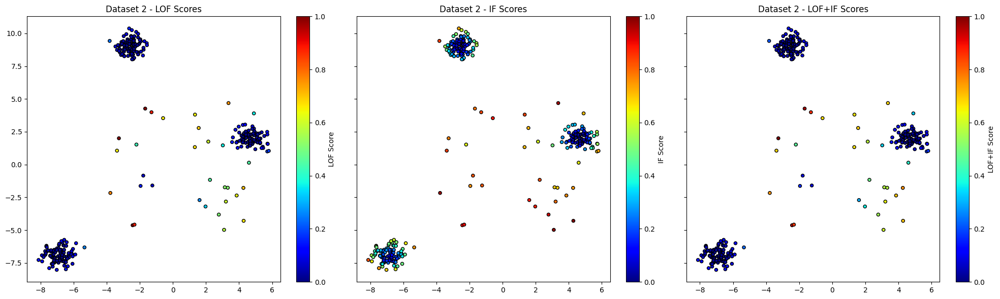

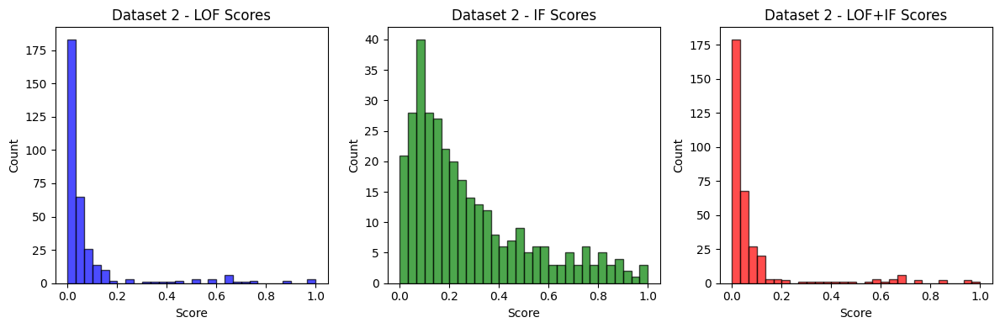

In [ ]:
from sklearn.preprocessing import StandardScaler

# Dataset 2
print("Processing Dataset 3 :  Multiple Clusters with Outliers")

from sklearn.datasets import make_blobs

# Generate data for Dataset 2
X2_clusters, _ = make_blobs(n_samples=300, centers=3, cluster_std=0.5, random_state=42)
X2_outliers = np.random.uniform(low=-5, high=5, size=(30, 2))
X2 = np.vstack((X2_clusters, X2_outliers))

# Scale the dataset
scaler2 = StandardScaler()
X2_scaled = scaler2.fit_transform(X2)

# LOF scores
lof2 = LocalOutlierFactor(n_neighbors=20, contamination=0.1)
lof2.fit(X2_scaled)
lof_scores2 = -lof2.negative_outlier_factor_

# IF scores
iso_forest2 = IsolationForest(contamination=0.1, random_state=42)
iso_forest2.fit(X2_scaled)
if_scores2 = -iso_forest2.decision_function(X2_scaled)

# Combined LOF+IF scores
lof_if_scores2 = lof_with_if(X2_scaled, k=20, gamma=0.5, contamination_fraction=0.1)

# Normalize scores for visualization
lof_scores2_norm = (lof_scores2 - lof_scores2.min()) / (lof_scores2.max() - lof_scores2.min())
if_scores2_norm = (if_scores2 - if_scores2.min()) / (if_scores2.max() - if_scores2.min())
lof_if_scores2_norm = (lof_if_scores2 - lof_if_scores2.min()) / (lof_if_scores2.max() - lof_if_scores2.min())

# Scatter plots for each score type
fig, axes = plt.subplots(1, 3, figsize=(20, 6), sharex=True, sharey=True)

# LOF Scores
scatter1 = axes[0].scatter(X2[:, 0], X2[:, 1], c=lof_scores2_norm, cmap="jet", s=20, edgecolor="k")
axes[0].set_title("Dataset 2 - LOF Scores")
plt.colorbar(scatter1, ax=axes[0], label="LOF Score")

# IF Scores
scatter2 = axes[1].scatter(X2[:, 0], X2[:, 1], c=if_scores2_norm, cmap="jet", s=20, edgecolor="k")
axes[1].set_title("Dataset 2 - IF Scores")
plt.colorbar(scatter2, ax=axes[1], label="IF Score")

# LOF+IF Scores
scatter3 = axes[2].scatter(X2[:, 0], X2[:, 1], c=lof_if_scores2_norm, cmap="jet", s=20, edgecolor="k")
axes[2].set_title("Dataset 2 - LOF+IF Scores")
plt.colorbar(scatter3, ax=axes[2], label="LOF+IF Score")

plt.tight_layout()
plt.show()

# Histograms for each score type
plt.figure(figsize=(12, 4))

# LOF Scores Histogram
plt.subplot(1, 3, 1)
plt.hist(lof_scores2_norm, bins=30, color="blue", alpha=0.7, edgecolor="black")
plt.title("Dataset 2 - LOF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

# IF Scores Histogram
plt.subplot(1, 3, 2)
plt.hist(if_scores2_norm, bins=30, color="green", alpha=0.7, edgecolor="black")
plt.title("Dataset 2 - IF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

# LOF+IF Scores Histogram
plt.subplot(1, 3, 3)
plt.hist(lof_if_scores2_norm, bins=30, color="red", alpha=0.7, edgecolor="black")
plt.title("Dataset 2 - LOF+IF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

plt.tight_layout()
plt.show()


Processing Dataset 4: Two Moons with Outliers


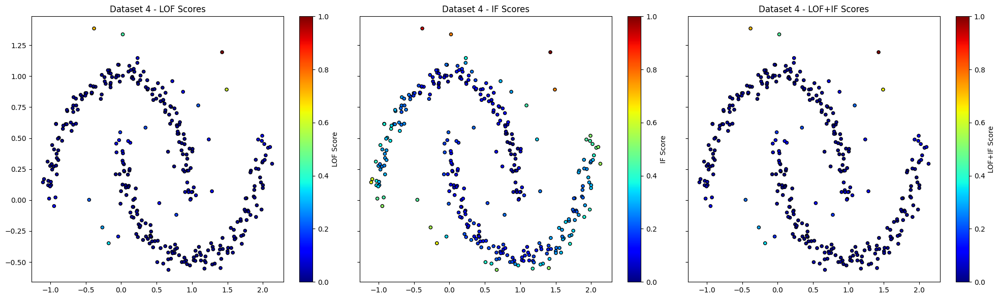

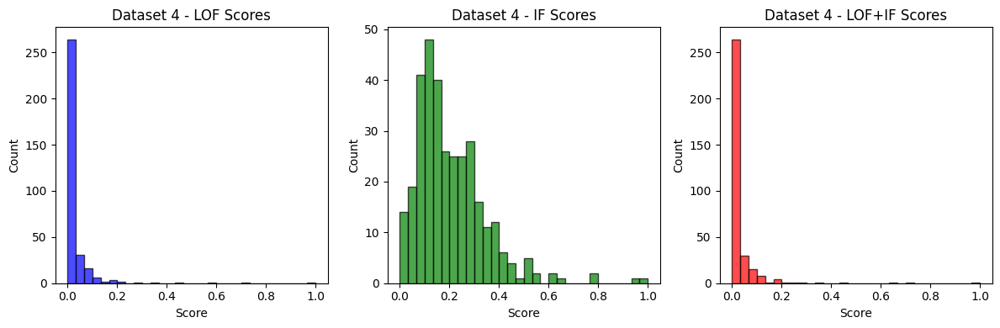

In [ ]:
from sklearn.datasets import make_moons

# Dataset 4
print("Processing Dataset 4: Two Moons with Outliers")

# Generate data for Dataset 4
X4_inliers, _ = make_moons(n_samples=300, noise=0.05, random_state=42)
X4_outliers = np.random.uniform(low=-0.5, high=1.5, size=(30, 2))
X4 = np.vstack([X4_inliers, X4_outliers])

# Scale the dataset
scaler4 = StandardScaler()
X4_scaled = scaler4.fit_transform(X4)

# LOF scores
lof4 = LocalOutlierFactor(n_neighbors=20, contamination=0.1)
lof4.fit(X4_scaled)
lof_scores4 = -lof4.negative_outlier_factor_

# IF scores
iso_forest4 = IsolationForest(contamination=0.1, random_state=42)
iso_forest4.fit(X4_scaled)
if_scores4 = -iso_forest4.decision_function(X4_scaled)

# Combined LOF+IF scores
lof_if_scores4 = lof_with_if(X4_scaled, k=20, gamma=0.5, contamination_fraction=0.1)

# Normalize scores for visualization
lof_scores4_norm = (lof_scores4 - lof_scores4.min()) / (lof_scores4.max() - lof_scores4.min())
if_scores4_norm = (if_scores4 - if_scores4.min()) / (if_scores4.max() - if_scores4.min())
lof_if_scores4_norm = (lof_if_scores4 - lof_if_scores4.min()) / (lof_if_scores4.max() - lof_if_scores4.min())

# Scatter plots for each score type
fig, axes = plt.subplots(1, 3, figsize=(20, 6), sharex=True, sharey=True)

# LOF Scores
scatter1 = axes[0].scatter(X4[:, 0], X4[:, 1], c=lof_scores4_norm, cmap="jet", s=20, edgecolor="k")
axes[0].set_title("Dataset 4 - LOF Scores")
plt.colorbar(scatter1, ax=axes[0], label="LOF Score")

# IF Scores
scatter2 = axes[1].scatter(X4[:, 0], X4[:, 1], c=if_scores4_norm, cmap="jet", s=20, edgecolor="k")
axes[1].set_title("Dataset 4 - IF Scores")
plt.colorbar(scatter2, ax=axes[1], label="IF Score")

# LOF+IF Scores
scatter3 = axes[2].scatter(X4[:, 0], X4[:, 1], c=lof_if_scores4_norm, cmap="jet", s=20, edgecolor="k")
axes[2].set_title("Dataset 4 - LOF+IF Scores")
plt.colorbar(scatter3, ax=axes[2], label="LOF+IF Score")

plt.tight_layout()
plt.show()

# Histograms for each score type
plt.figure(figsize=(12, 4))

# LOF Scores Histogram
plt.subplot(1, 3, 1)
plt.hist(lof_scores4_norm, bins=30, color="blue", alpha=0.7, edgecolor="black")
plt.title("Dataset 4 - LOF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

# IF Scores Histogram
plt.subplot(1, 3, 2)
plt.hist(if_scores4_norm, bins=30, color="green", alpha=0.7, edgecolor="black")
plt.title("Dataset 4 - IF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

# LOF+IF Scores Histogram
plt.subplot(1, 3, 3)
plt.hist(lof_if_scores4_norm, bins=30, color="red", alpha=0.7, edgecolor="black")
plt.title("Dataset 4 - LOF+IF Scores")
plt.xlabel("Score")
plt.ylabel("Count")

plt.tight_layout()
plt.show()


## Exercise 4 - [45%]

As opposed to bottom-up clustering approaches, a top-down method starts with one cluster -a model with one component- and tries incrementally to increase the number of clusters by introducing and fitting more components in the model. The general algorithm goes as follows:

* **Initialization:** start with $k$=1 component model, $M_k$
* **Step 1:** fit the model $M_k$
* **Step 2:** find a good way to introduce and initialize a new component; set $k=k+1$ and go to Step 1

There are many ways to make more specific the steps of this process.

**Model:** one can pick a cluster model, e.g. a centroid-based like that of k-means, or a probabilistic model like the Gaussian Mixture Models (GMM). In both cases an iterative approach takes place when fitting such a model.

**Incremental step:** Most importantly, one needs to decide about how Step 2 operates. Indicative options originally expressed using $k$-means are:
* **Bisecting:** This approach chooses one cluster and splits it in two parts. The criterion of which cluster to pick varies; one simple way is to choose the cluster with the largest error (or average error). In the case of k-means, which uses a hard assignment of points to clusters, this is:
    - B1) Initialize a second centroid using a random point of the cluster.
    - B2) Run a 2-means inside the cluster using only the points of that cluster.
    - B3) (Optionally) A full k-means fine-tuning to update all the $k+1$ clusters can be performed.
    Note that, if step B3 is not involved, 2 of the centroids are the product of the cluster splitting, while the rest come untouched from the previous $k$-order solution.
* **Global:** In its greedy version (see if needed the reference), this approach examines as the ($k+1$)-th centroid every of the $N$ points of the dataset, and in each case it fits a different $k+1$ model with ($k+1$)-means. Out of all the $N$ trials, it chooses the model that produced the maximal reduction of the clustering error (in fact it doesn't need to store the models, but only to rerun the best case found).
* **Fast Global:** It is a variation of Global k-means that initializes the $k+1$-th centroid with the point that achieves the largest reduction of error only after one k-means update, i.e. after considering it as new centroid and looking which other points would be assigned to that new cluster, and without iterating further till convergence.
* **Global++:** Instead of checking all $N$ points as candidates for initializing the $k+1$-th centroid, here the k-means++ principle is used. Specifically, the $k+1$ centroid is initialized by choosing at random one point based on the distribution of the inverse sum of distances of each point to the $k$ computed centroids. This should be repeated $m<N$ times (where $m$ is a parameter, e.g. $m=\lfloor 0.1*N \rfloor$) and pick the best choice.

**Recipe to prepare**

Consider that the final number of clusters $k^*$ is known in each case. First, use $k$-means as base algorithm, then extend to GMM as described below.

**a)** Implement the greedy global incremental, the fast global, and the global++ variations.

**b)** Which property of the solution produced by the bisecting variation does not hold any more, when including Step B3 and after applying it? Compare with the global incremental approach with regards to the same property?

**c)** Run experiments for the color clustering application we saw in the course (with given $k^*$ as in that example).

**d)** Construct a random synthetic dataset as follows. Consider a 5-by-5 2D grid arrangement of 25 clusters: i.e. the mean of the 1st cluster will be at (0,5), the 2nd at (1,5),..., the 6th at (0,4),..., the 25th at (5,0)). Each cluster will have $N=50$ points in 2D generated by a Gaussian distribution, with fixed $\sigma$ for all clusters (test values $\sigma = ${0.1, 0.5, 0.7, 1}). Run experiments with all your implementations (i.e. flat GMM training with fixed $k$; incremental GMM training with bisecting splits; incremental GMM training based on the global principle). Provide summaries of results about the clustering error and detailed comments with your observations/interpretations about the performance of the methods.

**e)** Now, extend your toolbox by also considering the GMM as base algorithm. You will need a piece of code implementing the GMM training with a fixed $k$ using the Expectation-Maximization (EM) algorithm.

**f)** What is the main problem of applying the bisecting principle in the GMM case? Find a heuristic workaround to adapt it to this probabilistic cluster model.

**References:**
- A. Likas et al., [The global k-means algorithm](https://hal.inria.fr/inria-00321515/document). Pattern Recognition, 2003.
- G. Vardakas et al., [Global k-means++: an effective relaxation of the global k-means clustering algorithm](https://arxiv.org/pdf/2211.12271), 2022.

## **Solution Exercice 4 :**

-----
 **a) Implementing Greedy Global Incremental, Fast Global, and Global++ Variations**

------
We will implement the following variations based on the k-means algorithm:

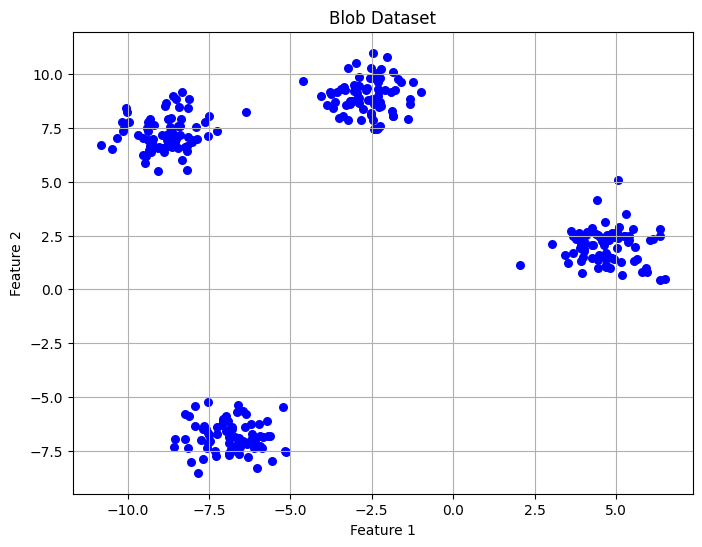

Initial clustering error: 637.22
Final clustering error: 362.47


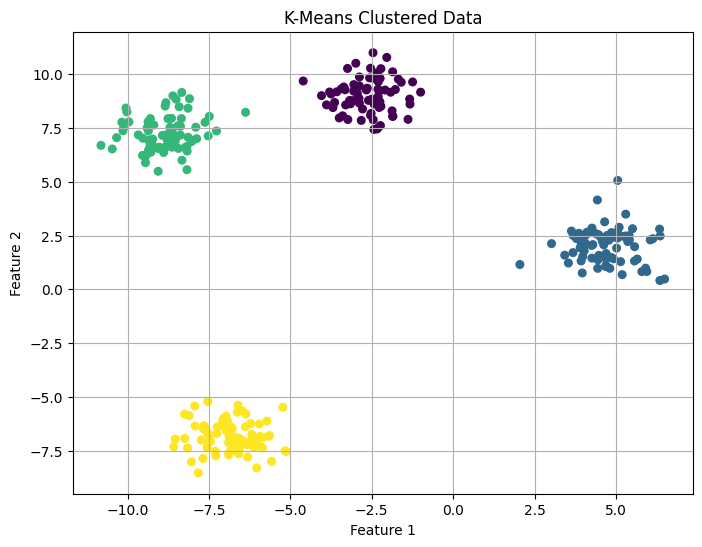

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from copy import deepcopy

# Function to generate and plot blob-shaped data
def generate_blob_data(sample_count=300, n_clusters=5, cluster_std=1.0, random_state=42):

    data_points, true_labels = make_blobs(
        n_samples=sample_count,
        centers=n_clusters,
        cluster_std=cluster_std,
        random_state=random_state
    )
    return data_points, true_labels

def plot_data(data, labels=None, title='Dataset'):
    plt.figure(figsize=(8, 6))
    if labels is not None:
        plt.scatter(data[:, 0], data[:, 1], s=30, c=labels, cmap='viridis')  # Color by labels
    else:
        plt.scatter(data[:, 0], data[:, 1], s=30, c='blue')  # Default color
    plt.title(title)
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.grid(True)
    plt.show()

# Function to calculate clustering error (Sum of Squared Errors)
def calculate_clustering_error(data, cluster_centers, cluster_assignments):
    total_error = np.sum(
        np.linalg.norm(data - cluster_centers[cluster_assignments], axis=1) ** 2
    )
    return total_error

# Function to assign clusters based on the nearest centroid
def allocate_clusters(data, cluster_centers):
    distances = np.linalg.norm(data[:, np.newaxis] - cluster_centers, axis=2)
    cluster_assignments = np.argmin(distances, axis=1)
    return cluster_assignments

# Function to recalculate centroids based on cluster assignments
def recalculate_centroids(data, assignments, num_clusters):
    new_centroids = np.zeros((num_clusters, data.shape[1]))
    for cluster_idx in range(num_clusters):
        cluster_points = data[assignments == cluster_idx]
        if len(cluster_points) > 0:
            new_centroids[cluster_idx] = cluster_points.mean(axis=0)
        else:
            # Handle empty clusters by assigning a random data point
            new_centroids[cluster_idx] = data[np.random.randint(0, len(data))]
    return new_centroids

# Perform k-means clustering
def perform_kmeans(data, start_centers, max_iterations=100):
    current_centroids = deepcopy(start_centers)

    # Compute initial clustering error
    cluster_assignments = allocate_clusters(data, current_centroids)
    initial_error = calculate_clustering_error(data, current_centroids, cluster_assignments)
    print(f"Initial clustering error: {initial_error:.2f}")

    for iteration in range(max_iterations):
        # Assign each point to the nearest cluster
        cluster_assignments = allocate_clusters(data, current_centroids)

        # Recompute the centroids based on the current assignments
        updated_centroids = recalculate_centroids(data, cluster_assignments, len(current_centroids))

        # Check for convergence
        if np.allclose(current_centroids, updated_centroids):
            break

        current_centroids = updated_centroids

    # Compute the final clustering error
    total_error = calculate_clustering_error(data, current_centroids, cluster_assignments)
    return current_centroids, cluster_assignments, initial_error, total_error

# Main block to execute the program
if __name__ == "__main__":
    # Generate and plot blob-shaped data
    blob_data, blob_labels = generate_blob_data(sample_count=300, n_clusters=4, cluster_std=0.8)
    plot_data(blob_data, title='Blob Dataset')

    # Initialize centroids randomly
    num_clusters = 4
    initial_centroids = blob_data[np.random.choice(len(blob_data), num_clusters, replace=False)]

    # Perform k-means clustering
    final_centroids, assignments, initial_error, final_error = perform_kmeans(blob_data, initial_centroids)

    # Output results
    print(f"Final clustering error: {final_error:.2f}")
    plot_data(blob_data, labels=assignments, title="K-Means Clustered Data")



**1. Greedy Global Incremental k-means**



Added Cluster 2, Current Error: 9211.21
Added Cluster 3, Current Error: 1919.36
Added Cluster 4, Current Error: 362.47
Added Cluster 5, Current Error: 327.66


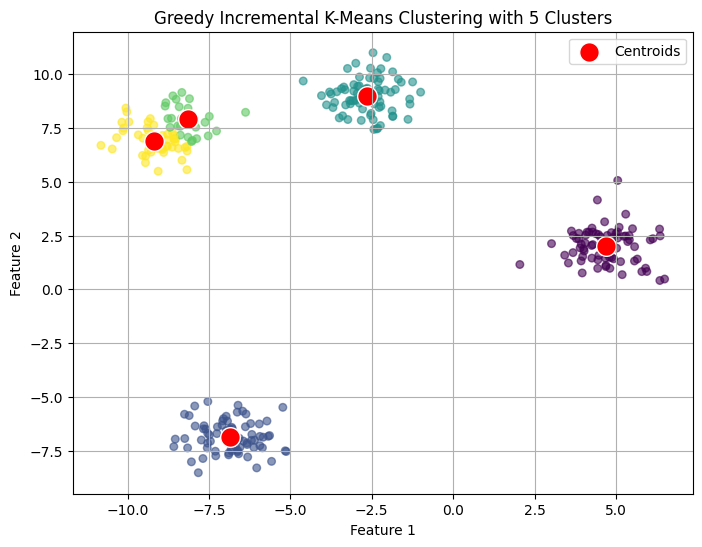

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from copy import deepcopy

# Assign clusters based on the nearest centroid
def allocate_clusters(data, centroids):
    distances = np.linalg.norm(data[:, np.newaxis] - centroids, axis=2)
    labels = np.argmin(distances, axis=1)
    return labels

# Calculate clustering error (Sum of Squared Errors)
def calculate_clustering_error(data, centroids, labels):
    squared_distances = np.sum((data - centroids[labels]) ** 2, axis=1)
    total_error = np.sum(squared_distances)
    return total_error

# Perform k-means clustering
def perform_kmeans(data, initial_centroids, max_iterations=100, tol=1e-4):
    centroids = deepcopy(initial_centroids)
    for iteration in range(max_iterations):
        # Assign clusters
        labels = allocate_clusters(data, centroids)
        # Recalculate centroids
        new_centroids = np.array([
            data[labels == i].mean(axis=0) if np.any(labels == i) else centroids[i]
            for i in range(len(centroids))
        ])
        # Check for convergence
        if np.all(np.linalg.norm(new_centroids - centroids, axis=1) <= tol):
            break
        centroids = new_centroids
    # Calculate final error
    total_error = calculate_clustering_error(data, centroids, labels)
    return centroids, labels, total_error

# Greedy incremental clustering
def greedy_incremental_clustering(data, target_clusters):
    num_data_points = len(data)
    active_clusters = 1
    # Initialize with the mean of all data points
    initial_centroid = np.mean(data, axis=0)
    centroid_list = [initial_centroid]
    cluster_labels = np.zeros(num_data_points, dtype=int)
    error_progression = []

    def add_new_centroid(existing_centroids, data_point):
        candidate_centroids = np.vstack([existing_centroids, data_point])
        return perform_kmeans(data, candidate_centroids)

    while active_clusters < target_clusters:
        best_error = float('inf')
        best_centroids = None
        best_labels = None

        # Test each point as a potential new centroid
        for idx in range(num_data_points):
            trial_centroids, trial_labels, trial_error = add_new_centroid(centroid_list, data[idx])
            if trial_error < best_error:
                best_error = trial_error
                best_centroids = trial_centroids
                best_labels = trial_labels

        # Update the centroids and labels
        centroid_list = best_centroids
        cluster_labels = best_labels
        error_progression.append(best_error)
        active_clusters += 1

        print(f"Added Cluster {active_clusters}, Current Error: {best_error:.2f}")

    return np.array(centroid_list), cluster_labels, error_progression

# Plot clusters and centroids
def plot_clusters(data, centroids, labels, title='Greedy Incremental K-Means Clustering'):
    plt.figure(figsize=(8, 6))
    plt.scatter(data[:, 0], data[:, 1], c=labels, cmap='viridis', s=30, alpha=0.6)
    plt.scatter(centroids[:, 0], centroids[:, 1], c='red', s=200, edgecolors='white', label='Centroids')
    plt.title(title)
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.legend()
    plt.grid(True)
    plt.show()



# Main block for demonstration
if __name__ == "__main__":
    # Generate synthetic data
    data_points, true_labels = make_blobs(n_samples=300, centers=4, cluster_std=0.8, random_state=42)

    # Define target number of clusters
    target_k = 5

    # Run greedy incremental clustering
    final_centroids, final_labels, error_progression = greedy_incremental_clustering(data_points, target_k)

    # Visualize the final clustering
    plot_clusters(data_points, final_centroids, final_labels,
                  title=f'Greedy Incremental K-Means Clustering with {target_k} Clusters')



**2. Fast Global k-means Algorithm Overview:**

Similar to the greedy global k-means but simplifies the selection of the new centroid by considering only one k-means update (assignment step) without full convergence.µ

Added Cluster 2, Error: 11853.56
Added Cluster 3, Error: 6876.95
Added Cluster 4, Error: 1983.54
Added Cluster 5, Error: 894.70


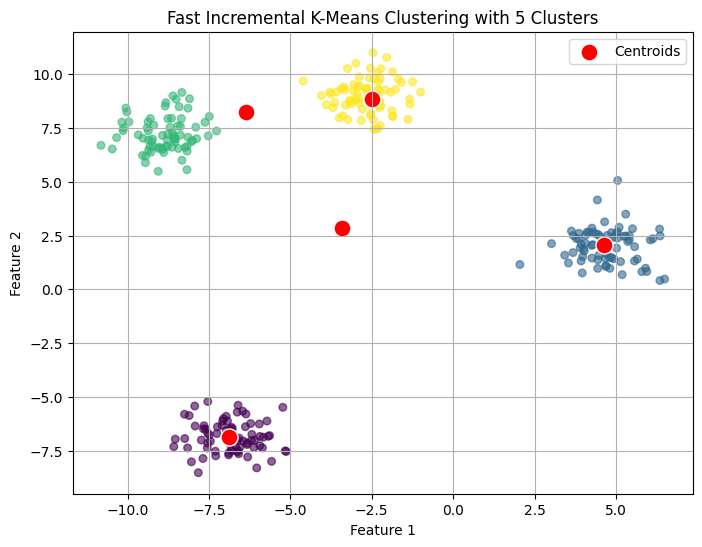

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs

# Assign clusters based on the nearest centroid
def allocate_clusters(data, centroids):
    distances = np.linalg.norm(data[:, np.newaxis] - centroids, axis=2)
    labels = np.argmin(distances, axis=1)
    return labels

# Calculate clustering error (Sum of Squared Errors)
def calculate_clustering_error(data, centroids, labels):
    squared_distances = np.sum((data - centroids[labels]) ** 2, axis=1)
    total_error = np.sum(squared_distances)
    return total_error

# Fast incremental k-means clustering
def fast_incremental_kmeans(data, target_k):
    N = len(data)
    # Initialize with the mean of all data points
    centroids = [np.mean(data, axis=0)]
    labels = np.zeros(N, dtype=int)
    errors = []

    while len(centroids) < target_k:
        best_error = float('inf')
        best_point = None

        # Iterate over all points to find the best new centroid
        for i in range(N):
            # Temporarily add the point as a new centroid
            trial_centroids = np.vstack([centroids, data[i]])
            # Assign clusters based on trial centroids
            trial_labels = allocate_clusters(data, trial_centroids)
            # Compute error without further iterations
            trial_error = calculate_clustering_error(data, trial_centroids, trial_labels)
            # Check if this configuration has the lowest error
            if trial_error < best_error:
                best_error = trial_error
                best_point = data[i]
                best_labels = trial_labels

        # Add the best point found as a new centroid
        centroids.append(best_point)
        labels = best_labels
        errors.append(best_error)
        print(f"Added Cluster {len(centroids)}, Error: {best_error:.2f}")

    return np.array(centroids), labels, errors

# Plot clusters and centroids
def plot_clusters(data, centroids, labels, title='Fast Incremental K-Means Clustering'):
    plt.figure(figsize=(8, 6))
    plt.scatter(data[:, 0], data[:, 1], c=labels, cmap='viridis', s=30, alpha=0.6)
    plt.scatter(centroids[:, 0], centroids[:, 1], c='red', s=150, edgecolors='white', label='Centroids')
    plt.title(title)
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.legend()
    plt.grid(True)
    plt.show()


# Main block for demonstration
if __name__ == "__main__":
    # Generate synthetic data
    data_points, true_labels = make_blobs(n_samples=300, centers=4, cluster_std=0.8, random_state=42)

    # Define target number of clusters
    target_k = 5

    # Run fast incremental k-means
    final_centroids, final_labels, error_progress = fast_incremental_kmeans(data_points, target_k)

    # Visualize the final clustering
    plot_clusters(data_points, final_centroids, final_labels,
                  title=f'Fast Incremental K-Means Clustering with {target_k} Clusters')


**3. Global++ k-means**

Instead of examining all data points, we select a subset of
$m$ candidate points using a probability distribution inspired by $k-means++$ initialization.


Added Cluster 2, Error: 9211.21
Added Cluster 3, Error: 1919.36
Added Cluster 4, Error: 362.47
Added Cluster 5, Error: 327.83


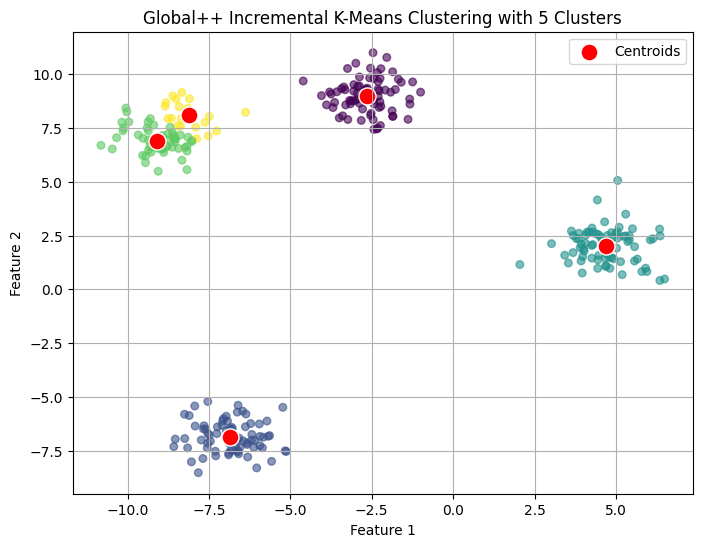

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs

# Assign clusters based on the nearest centroid
def allocate_clusters(data, centroids):
    distances = np.linalg.norm(data[:, np.newaxis] - centroids, axis=2)
    labels = np.argmin(distances, axis=1)
    return labels

# Calculate clustering error (Sum of Squared Errors)
def calculate_clustering_error(data, centroids, labels):
    squared_distances = np.sum((data - centroids[labels]) ** 2, axis=1)
    total_error = np.sum(squared_distances)
    return total_error

# Perform k-means clustering with initialization
def perform_kmeans(data, initial_centroids, max_iterations=100):
    centroids = initial_centroids.copy()
    for iteration in range(max_iterations):
        # Assign clusters
        labels = allocate_clusters(data, centroids)
        # Recalculate centroids
        new_centroids = np.array([
            data[labels == i].mean(axis=0) if np.any(labels == i) else centroids[i]
            for i in range(len(centroids))
        ])
        # Check for convergence
        if np.allclose(centroids, new_centroids):
            break
        centroids = new_centroids
    # Calculate final error
    total_error = calculate_clustering_error(data, centroids, labels)
    return centroids, labels, total_error

# Global++ incremental k-means clustering
def global_pp_incremental_kmeans(data, target_k, m=None):
    N = len(data)
    if m is None:
        m = max(1, N // 10)  # Default value for candidate sampling

    # Initialize with the mean of all data points
    centroids = [np.mean(data, axis=0)]
    labels = np.zeros(N, dtype=int)
    errors = []

    while len(centroids) < target_k:
        # Compute distances to the closest centroid
        distances = np.min(np.linalg.norm(data[:, np.newaxis] - np.array(centroids), axis=2), axis=1)
        # Compute probabilities proportional to squared distances
        probabilities = distances ** 2 / np.sum(distances ** 2)

        best_error = float('inf')
        best_centroids = None
        best_labels = None

        # Sample m candidate centroids based on probabilities
        candidate_indices = np.random.choice(N, size=m, replace=False, p=probabilities)
        for idx in candidate_indices:
            # Add candidate to the centroids and perform k-means
            trial_centroids = np.vstack([centroids, data[idx]])
            trial_centroids, trial_labels, trial_error = perform_kmeans(data, trial_centroids)
            if trial_error < best_error:
                best_error = trial_error
                best_centroids = trial_centroids
                best_labels = trial_labels

        # Update centroids and labels
        centroids = best_centroids
        labels = best_labels
        errors.append(best_error)
        print(f"Added Cluster {len(centroids)}, Error: {best_error:.2f}")

    return np.array(centroids), labels, errors

# Plot clusters and centroids
def plot_clusters(data, centroids, labels, title='Global++ Incremental K-Means Clustering'):
    plt.figure(figsize=(8, 6))
    plt.scatter(data[:, 0], data[:, 1], c=labels, cmap='viridis', s=30, alpha=0.6)
    plt.scatter(centroids[:, 0], centroids[:, 1], c='red', s=150, edgecolors='white', label='Centroids')
    plt.title(title)
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.legend()
    plt.grid(True)
    plt.show()


# Main block for demonstration
if __name__ == "__main__":
    # Generate synthetic data
    data_points, true_labels = make_blobs(n_samples=300, centers=4, cluster_std=0.8, random_state=42)

    # Define target number of clusters
    target_k = 5
    m = 30  # Number of candidates to sample

    # Run global++ incremental k-means
    final_centroids, final_labels, error_progress = global_pp_incremental_kmeans(data_points, target_k, m)

    # Visualize the final clustering
    plot_clusters(data_points, final_centroids, final_labels,
                  title=f'Global++ Incremental K-Means Clustering with {target_k} Clusters')

Generating synthetic data...

Running Greedy Incremental K-Means...
Added Cluster 2, Current Error: 9211.21
Added Cluster 3, Current Error: 1919.36
Added Cluster 4, Current Error: 362.47
Added Cluster 5, Current Error: 327.66

Running Fast Incremental K-Means...
Added Cluster 2, Error: 11853.56
Added Cluster 3, Error: 6876.95
Added Cluster 4, Error: 1983.54
Added Cluster 5, Error: 894.70

Running Global++ Incremental K-Means...
Added Cluster 2, Error: 9211.21
Added Cluster 3, Error: 1919.36
Added Cluster 4, Error: 362.47
Added Cluster 5, Error: 327.83

Comparing error reduction across methods...


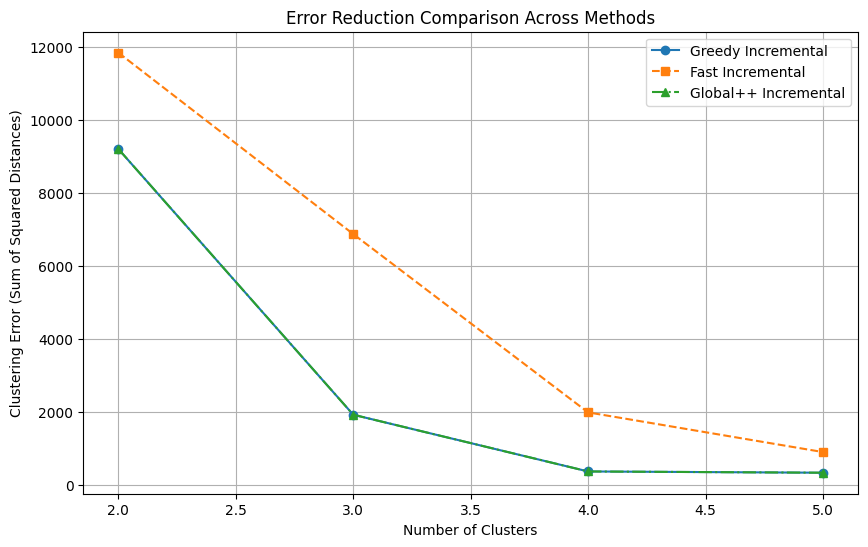

In [ ]:
def plot_error_comparison(errors_greedy, errors_fast, errors_global, method_names=None):

    if method_names is None:
        method_names = ["Greedy Incremental", "Fast Incremental", "Global++ Incremental"]

    plt.figure(figsize=(10, 6))
    cluster_numbers_greedy = np.arange(2, len(errors_greedy) + 2)
    cluster_numbers_fast = np.arange(2, len(errors_fast) + 2)
    cluster_numbers_global = np.arange(2, len(errors_global) + 2)

    plt.plot(cluster_numbers_greedy, errors_greedy, marker='o', linestyle='-', label=method_names[0])
    plt.plot(cluster_numbers_fast, errors_fast, marker='s', linestyle='--', label=method_names[1])
    plt.plot(cluster_numbers_global, errors_global, marker='^', linestyle='-.', label=method_names[2])

    plt.title('Error Reduction Comparison Across Methods')
    plt.xlabel('Number of Clusters')
    plt.ylabel('Clustering Error (Sum of Squared Distances)')
    plt.legend()
    plt.grid(True)
    plt.show()

if __name__ == "__main__":
    # Generate synthetic data
    print("Generating synthetic data...")
    data_points, true_labels = make_blobs(n_samples=300, centers=4, cluster_std=0.8, random_state=42)

    # Define target number of clusters
    target_k = 5
    m = 30  # Number of candidates to sample for Global++

    # Run Greedy Incremental K-Means
    print("\nRunning Greedy Incremental K-Means...")
    centroids_greedy, labels_greedy, errors_greedy = greedy_incremental_clustering(data_points, target_k)

    # Run Fast Incremental K-Means
    print("\nRunning Fast Incremental K-Means...")
    centroids_fast, labels_fast, errors_fast = fast_incremental_kmeans(data_points, target_k)

    # Run Global++ Incremental K-Means
    print("\nRunning Global++ Incremental K-Means...")
    centroids_global, labels_global, errors_global = global_pp_incremental_kmeans(data_points, target_k, m)

    # Compare error reduction across methods
    print("\nComparing error reduction across methods...")
    plot_error_comparison(errors_greedy, errors_fast, errors_global)


### **4. Comparison of Results:**

In comparing the three incremental k-means methods **Greedy, Fast Incremental, and Global++** we see that Greedy and Global++ produce very similar results. Both start with an error of around 9211 and progressively reduce it, reaching around 327 after five clusters.However, the Fast Incremental method starts with a higher error of 11853 but still shows steady improvement, ending with a final error of 894. In short, Greedy and Global++ perform almost identically, with Greedy slightly ahead, while Fast Incremental is less efficient but still effective at reducing error.

**why greedy and Global++ methods have similar results ?**
It is possible that in this case, both the greedy and Global++ methods are finding similar centroids because the dataset is simple or well-separated. Increasing m in Global++ or experimenting with more complex datasets may help observe the differences between these methods more clearly.

-----
**b) Which property of the solution produced by the bisecting variation does not hold any more, when including Step B3 and after applying it? Compare with the global incremental approach with regards to the same property?**

------

In the bisecting method, Step B3 changes the rule that the centroids of the existing clusters stay fixed. Normally, when you bisect a cluster, only the new cluster gets updated, and the existing clusters' centroids remain unchanged. However, when Step B3 is applied, K-Means is run again on all centroids, meaning all centroids are updated, not just the one being split. This breaks the stability of the original centroids.

In the global incremental approaches (like greedy, fast, and Global++), the same thing happens. Every time a new centroid is added, all centroids are recalculated and updated. This means the clusters are constantly being adjusted, and the original structure of the clusters is not preserved.

So, both the bisecting method with Step B3 and the global incremental methods lose the property that existing cluster centroids stay fixed. They both adjust all centroids as new clusters are added.

-------
 **c) Experiments with Color Clustering Application**

-----
We will apply the implemented algorithms to the color quantization task, which involves reducing the number of colors in an image by clustering similar colors.

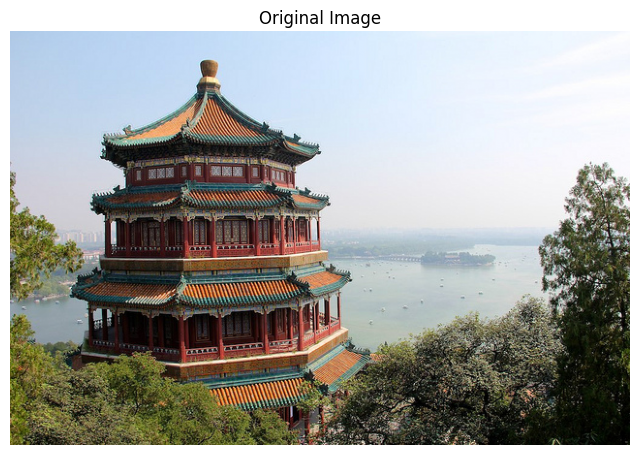

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import load_sample_image

# Load the sample image (China)
image = load_sample_image("china.jpg")

# Normalize the image to the range [0, 1] and convert to float
image = image.astype(np.float64) / 255

# Get the dimensions and reshape the image into a 2D array
w, h, d = image.shape
assert d == 3, "The image must have 3 color channels (RGB)."
image_array = image.reshape((w * h, d))

# Display the original image
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Original Image')
plt.imshow(image)
plt.show()


Executing Optimized Global++ Incremental K-Means for color quantization...
Cluster 11 added, Error: 75.36
Cluster 21 added, Error: 43.52
Cluster 31 added, Error: 31.30
Cluster 41 added, Error: 24.75
Cluster 51 added, Error: 20.97
Cluster 61 added, Error: 18.18
Cluster 64 added, Error: 17.52
Completed in 8.45 seconds.


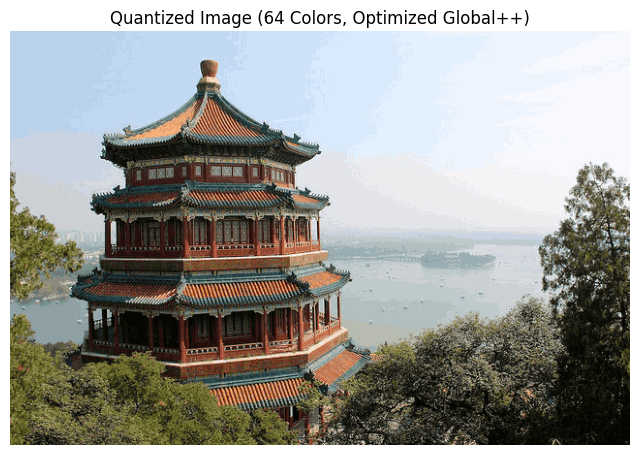

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import load_sample_image
from sklearn.cluster import KMeans
from time import time

# Load and normalize the image
image = load_sample_image("china.jpg")
image = np.array(image, dtype=np.float64) / 255
w, h, d = original_shape = image.shape
assert d == 3
image_array = image.reshape((w * h, d))

# Function to sample pixels from the image
def sample_image_pixels(image_array, sample_size):
    if sample_size < len(image_array):
        indices = np.random.choice(len(image_array), size=sample_size, replace=False)
        return image_array[indices]
    return image_array

# Function for assigning labels to points based on centroids
def assign_labels(X, centroids):
    distances = np.linalg.norm(X[:, np.newaxis] - centroids, axis=2)
    return np.argmin(distances, axis=1)

# Optimized Global++ Incremental K-Means for Color Quantization
def optimized_global_pp_incremental_kmeans_color(X, k_star, sample_size=10000, m=20):
    X_sample = sample_image_pixels(X, sample_size)
    centroids = [X_sample[np.random.randint(0, len(X_sample))]]
    errors = []

    for k in range(1, k_star):
        distances = np.linalg.norm(X_sample - centroids[-1], axis=1)
        probabilities = distances**2 / np.sum(distances**2) if np.sum(distances**2) > 0 else np.full(len(X_sample), 1 / len(X_sample))
        candidates_indices = np.random.choice(len(X_sample), size=m, replace=False, p=probabilities)
        candidates = X_sample[candidates_indices]

        min_error, best_centroids = np.inf, None
        for candidate in candidates:
            init_centroids = np.vstack([centroids, candidate])
            kmeans = KMeans(n_clusters=k + 1, init=init_centroids, n_init=1, max_iter=1, random_state=42)
            kmeans.fit(X_sample)
            if kmeans.inertia_ < min_error:
                min_error = kmeans.inertia_
                best_centroids = kmeans.cluster_centers_

        if best_centroids is not None:
            centroids = best_centroids
            errors.append(min_error)
            if k % 10 == 0 or k == k_star - 1:
                print(f"Cluster {k + 1} added, Error: {min_error:.2f}")
        else:
            print("No improvement in error. Stopping the algorithm.")
            break

    labels = assign_labels(X, centroids)
    return centroids, labels, errors

# Number of desired colors
k_star = 64

# Execute the optimized Global++ Incremental K-Means
print("Executing Optimized Global++ Incremental K-Means for color quantization...")
start_time = time()
centroids_pp, labels_pp, errors_pp = optimized_global_pp_incremental_kmeans_color(image_array, k_star)
print(f"Completed in {time() - start_time:.2f} seconds.")

# Recreate the quantized image
def recreate_image(codebook, labels, w, h):
    return codebook[labels].reshape((w, h, -1))

quantized_image_pp = recreate_image(centroids_pp, labels_pp, w, h)

# Display the quantized image
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title(f'Quantized Image ({k_star} Colors, Optimized Global++)')
plt.imshow(quantized_image_pp)
plt.show()


**Experiments with Synthetic Dataset**

------
**d) Construct a random synthetic dataset as follows. Consider a 5-by-5 2D grid arrangement of 25 clusters: i.e. the mean of the 1st cluster will be at (0,5), the 2nd at (1,5),..., the 6th at (0,4),..., the 25th at (5,0)). Each cluster will have $N=50$ points in 2D generated by a Gaussian distribution, with fixed $\sigma$ for all clusters (test values $\sigma = ${0.1, 0.5, 0.7, 1}). Run experiments with all your implementations (i.e. flat GMM training with fixed $k$; incremental GMM training with bisecting splits; incremental GMM training based on the global principle). Provide summaries of results about the clustering error and detailed comments with your observations/interpretations about the performance of the methods.**

---

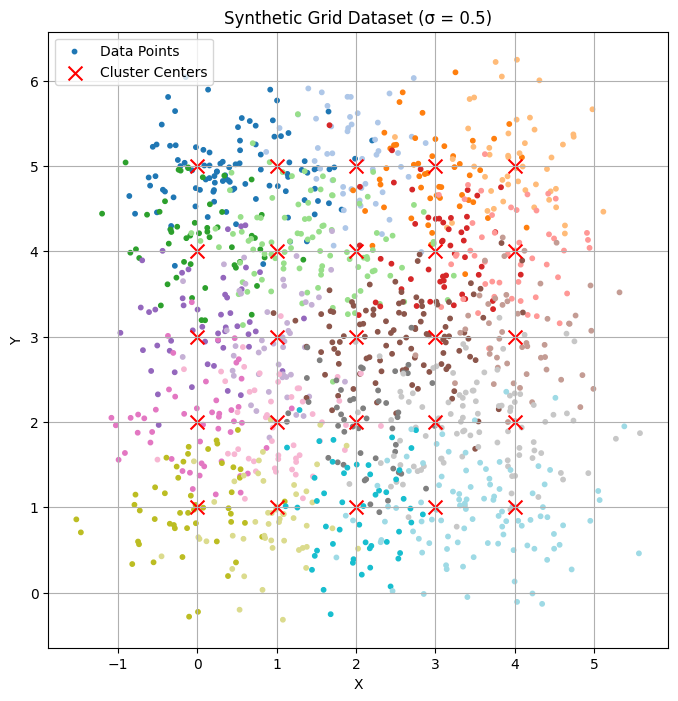

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def create_synthetic_grid_data(points_per_cluster=50, sigma=0.1, grid_size=(5, 5)):
    rows, cols = grid_size
    centers = np.array([[x, y] for y in range(rows, 0, -1) for x in range(cols)])

    # Generate points for each cluster
    data = []
    labels = []
    for cluster_id, center in enumerate(centers):
        # Add Gaussian noise around each cluster center
        cluster_points = np.random.normal(loc=center, scale=sigma, size=(points_per_cluster, 2))
        data.append(cluster_points)
        labels.extend([cluster_id] * points_per_cluster)

    return np.vstack(data), np.array(labels), centers

# Example Usage
N = 50  # Points per cluster
sigma = 0.5  # Standard deviation for Gaussian noise
data, labels, centers = create_synthetic_grid_data(points_per_cluster=N, sigma=sigma)

# Visualizing the dataset
plt.figure(figsize=(8, 8))
plt.scatter(data[:, 0], data[:, 1], c=labels, cmap='tab20', s=10, label='Data Points')
plt.scatter(centers[:, 0], centers[:, 1], c='red', marker='x', s=100, label='Cluster Centers')
plt.title(f"Synthetic Grid Dataset (σ = {sigma})")
plt.xlabel("X")
plt.ylabel("Y")
plt.legend()
plt.grid(True)
plt.show()


#### **1. Flat GMM with Fixed Number of Clusters k=25**

In [ ]:
from sklearn.mixture import GaussianMixture

def flat_gmm(X, n_components=25):
    gmm = GaussianMixture(n_components=n_components, random_state=42)
    gmm.fit(X)
    return gmm.predict(X), gmm

# Run flat GMM for each sigma
flat_gmm_results = {}
for sigma in sigma_values:
    X, true_labels, _ = synthetic_data[sigma]
    predicted_labels, gmm_model = flat_gmm(X, n_components=25)
    ari = adjusted_rand_score(true_labels, predicted_labels)
    flat_gmm_results[sigma] = ari
    print(f"Flat GMM (Sigma={sigma}) - ARI: {ari:.4f}")




Flat GMM (Sigma=0.1) - ARI: 1.0000
Flat GMM (Sigma=0.5) - ARI: 0.3008
Flat GMM (Sigma=0.7) - ARI: 0.1770
Flat GMM (Sigma=1) - ARI: 0.1052


####  **2. Incremental GMM with Bisecting Divisions**

In [ ]:
import numpy as np
from sklearn.mixture import GaussianMixture

def bisecting_gmm_clustering(X, k_star=25, covariance_type='full', random_state=42):

    n_samples = len(X)
    # Initialize with one cluster, keeping track of data indices
    gmm = GaussianMixture(
        n_components=1,
        covariance_type=covariance_type,
        random_state=random_state
    )
    gmm.fit(X)
    clusters = [{'data': X, 'indices': np.arange(n_samples), 'gmm': gmm}]

    while len(clusters) < k_star:
        # Find the cluster with the highest error
        errors = [
            -cluster['gmm'].score(cluster['data']) * len(cluster['data'])
            for cluster in clusters
        ]
        idx_to_split = np.argmax(errors)
        cluster_to_split = clusters.pop(idx_to_split)
        data = cluster_to_split['data']
        data_indices = cluster_to_split['indices']

        # Split the selected cluster into two
        gmm_split = GaussianMixture(
            n_components=2,
            covariance_type=covariance_type,
            random_state=random_state
        )
        gmm_split.fit(data)
        labels_split = gmm_split.predict(data)

        for i in range(2):
            subcluster_data = data[labels_split == i]
            subcluster_indices = data_indices[labels_split == i]
            if len(subcluster_data) > 0:
                gmm_i = GaussianMixture(
                    n_components=1,
                    covariance_type=covariance_type,
                    random_state=random_state
                )
                gmm_i.fit(subcluster_data)
                clusters.append({
                    'data': subcluster_data,
                    'indices': subcluster_indices,
                    'gmm': gmm_i
                })
            else:
                print("Encountered an empty sub-cluster and ignored it.")

    # Collect final results
    labels = np.zeros(n_samples, dtype=int)
    means = []
    total_error = 0.0
    for idx, cluster in enumerate(clusters):
        indices = cluster['indices']
        labels[indices] = idx
        means.append(cluster['gmm'].means_[0])
        total_error += -cluster['gmm'].score(cluster['data']) * len(cluster['data'])

    means = np.array(means)
    return labels, means, total_error


In [ ]:
from sklearn.cluster import KMeans
import numpy as np
from sklearn.mixture import GaussianMixture

def bisecting_gmm(X, n_clusters=25, max_iter=10):
    # Initialize using k-means with 2 clusters
    kmeans = KMeans(n_clusters=2, random_state=42).fit(X)
    centroids = kmeans.cluster_centers_
    labels = kmeans.labels_

    # Bisecting split and continue iterating
    for _ in range(max_iter):
        # Split the cluster with the highest variance
        cluster_variance = [np.var(X[labels == i], axis=0).sum() for i in range(2)]
        split_cluster = np.argmax(cluster_variance)

        # Fit GMM on this cluster
        cluster_points = X[labels == split_cluster]
        gmm = GaussianMixture(n_components=2, random_state=42)
        gmm.fit(cluster_points)

        # Reassign the labels
        new_labels = gmm.predict(cluster_points)
        labels[labels == split_cluster] = new_labels

    return labels

# Run bisecting GMM for each sigma
bisecting_gmm_results = {}
for sigma in sigma_values:
    X, true_labels, _ = synthetic_data[sigma]
    predicted_labels = bisecting_gmm(X, n_clusters=25)
    ari = adjusted_rand_score(true_labels, predicted_labels)
    bisecting_gmm_results[sigma] = ari
    print(f"Bisecting GMM (Sigma={sigma}) - ARI: {ari:.4f}")


Bisecting GMM (Sigma=0.1) - ARI: 0.0537
Bisecting GMM (Sigma=0.5) - ARI: 0.0441
Bisecting GMM (Sigma=0.7) - ARI: 0.0386
Bisecting GMM (Sigma=1) - ARI: 0.0312


#### **3. Incremental GMM Based on the Global Principle**

In [ ]:
import numpy as np
from sklearn.mixture import GaussianMixture


def global_incremental_gmm_clustering(X, k_star=25, candidate_size=100, covariance_type='full', random_state=42):

    gmm = GaussianMixture(
        n_components=1,
        covariance_type=covariance_type,
        random_state=random_state
    )
    gmm.fit(X)
    labels = gmm.predict(X)
    initial_error = -gmm.score(X) * len(X)
    errors = [initial_error]

    while len(errors) < k_star:
        min_error = np.inf
        best_gmm = None
        # Sample candidate points
        candidate_indices = np.random.choice(len(X), size=candidate_size, replace=False)
        for idx in candidate_indices:
            n_components_new = len(errors) + 1
            new_gmm = GaussianMixture(
                n_components=n_components_new,
                covariance_type=covariance_type,
                random_state=random_state
            )
            means_init = np.vstack([gmm.means_, X[idx]])
            new_gmm.means_init = means_init
            new_gmm.fit(X)
            new_error = -new_gmm.score(X) * len(X)
            if new_error < min_error:
                min_error = new_error
                best_gmm = new_gmm
        if best_gmm is not None:
            gmm = best_gmm
            labels = gmm.predict(X)
            errors.append(min_error)
            print(f"Components: {len(errors)}, Error: {min_error:.2f}")
        else:
            print("No candidate improved the error. Stopping the algorithm.")
            break

    return labels, gmm.means_, errors



 *** Processing for σ = 0.1 ***
Method 1: Flat GMM
Method 2: Bisecting GMM
Method 3: Global Incremental GMM
Components: 2, Error: 4298.91
Components: 3, Error: 4022.28
Components: 4, Error: 3541.88
Components: 5, Error: 3088.89
Components: 6, Error: 3002.82
Components: 7, Error: 2931.77
Components: 8, Error: 2912.90
Components: 9, Error: 2861.43
Components: 10, Error: 2799.54
Components: 11, Error: 2786.10
Components: 12, Error: 2662.08
Components: 13, Error: 2667.43
Components: 14, Error: 2625.44
Components: 15, Error: 2519.80
Components: 16, Error: 2470.62
Components: 17, Error: 2429.39
Components: 18, Error: 2355.69
Components: 19, Error: 2264.49
Components: 20, Error: 2164.25
Components: 21, Error: 2104.57
Components: 22, Error: 2014.20
Components: 23, Error: 1927.97
Components: 24, Error: 1840.82
Components: 25, Error: 1754.15

 *** Processing for σ = 0.5 ***
Method 1: Flat GMM
Method 2: Bisecting GMM
Method 3: Global Incremental GMM
Components: 2, Error: 4489.55
Components: 3, E

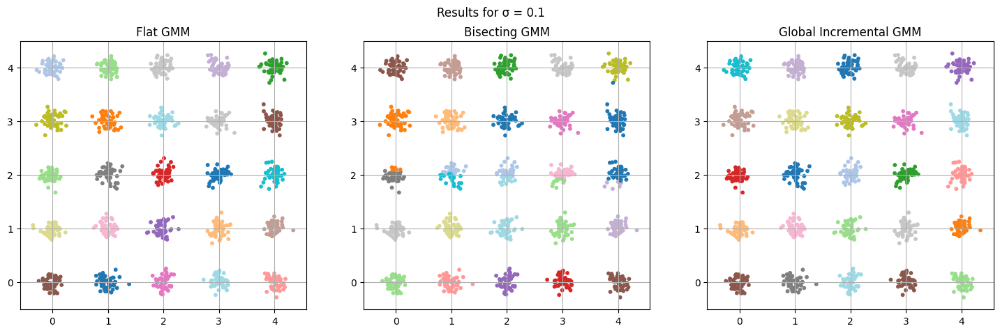

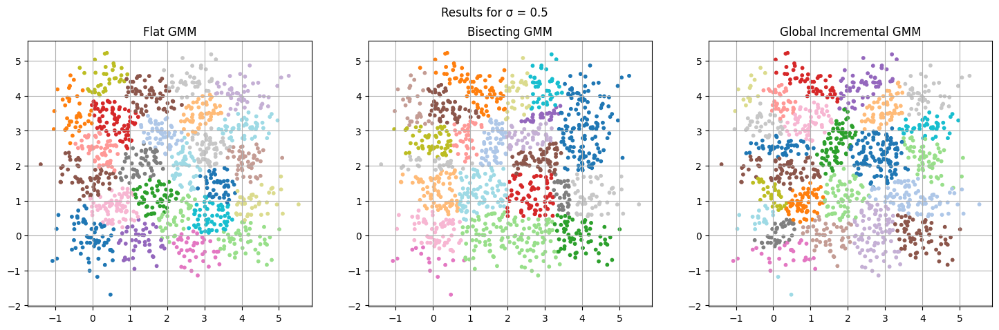

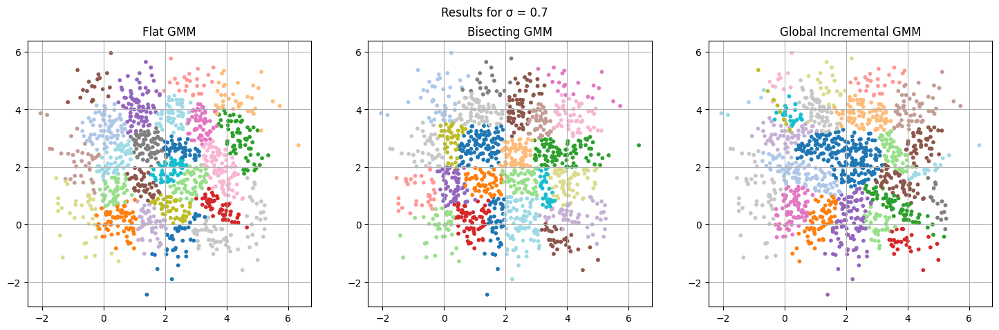

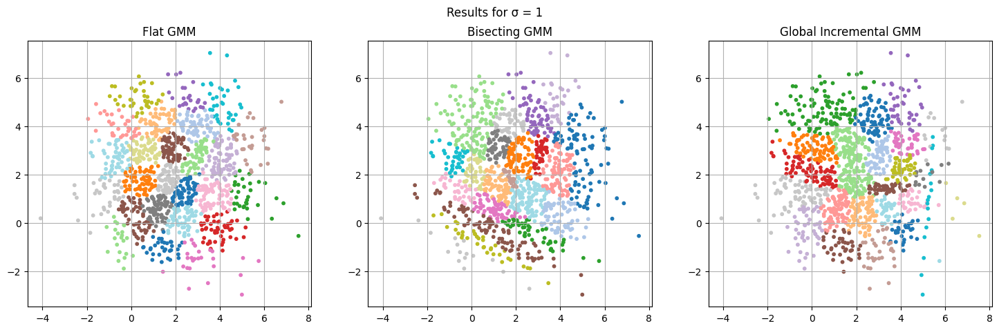

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture

# Define your data generation function
def generate_grid_data(grid_size=5, N=50, sigma=0.1):
    centers = np.array([[i, grid_size - j - 1] for i in range(grid_size) for j in range(grid_size)])
    X = np.vstack([np.random.normal(loc=center, scale=sigma, size=(N, 2)) for center in centers])
    y = np.hstack([[idx] * N for idx in range(len(centers))])
    return X, y, centers

# Define your clustering functions (as corrected above)
# - flat_gmm_clustering
# - bisecting_gmm_clustering
# - global_incremental_gmm_clustering

# Initialize parameters
sigma_values = [0.1, 0.5, 0.7, 1]
results = {}
k_star = 25

# Run clustering methods and store results
for sigma in sigma_values:
    print(f"\n *** Processing for σ = {sigma} ***")
    X, y_true, centers = generate_grid_data(N=50, sigma=sigma)

    # Method 1: Flat GMM
    print("Method 1: Flat GMM")
    labels_flat, means_flat, error_flat = flat_gmm_clustering(X, n_components=k_star)

    # Method 2: Bisecting GMM
    print("Method 2: Bisecting GMM")
    labels_bisect, means_bisect, error_bisect = bisecting_gmm_clustering(X, k_star=k_star)

    # Method 3: Global Incremental GMM
    print("Method 3: Global Incremental GMM")
    labels_global, means_global, errors_global = global_incremental_gmm_clustering(X, k_star=k_star, candidate_size=100)
    error_global = errors_global[-1]

    # Store results
    results[sigma] = {
        'flat': {'labels': labels_flat, 'means': means_flat, 'error': error_flat},
        'bisect': {'labels': labels_bisect, 'means': means_bisect, 'error': error_bisect},
        'global': {'labels': labels_global, 'means': means_global, 'error': error_global},
        'true_labels': y_true,
        'X': X
    }

# Summary of Clustering Errors
print("\n *** Summary of Clustering Errors ***")
print("σ\tFlat GMM\tBisecting GMM\tGlobal Incremental GMM")
for sigma in sigma_values:
    error_flat = results[sigma]['flat']['error']
    error_bisect = results[sigma]['bisect']['error']
    error_global = results[sigma]['global']['error']
    print(f"{sigma}\t{error_flat:.2f}\t\t{error_bisect:.2f}\t\t{error_global:.2f}")

# Visualize the clustering results for each sigma
for sigma in sigma_values:
    X = results[sigma]['X']
    y_true = results[sigma]['true_labels']
    labels_flat = results[sigma]['flat']['labels']
    labels_bisect = results[sigma]['bisect']['labels']
    labels_global = results[sigma]['global']['labels']

    fig, axs = plt.subplots(1, 3, figsize=(18, 5))
    fig.suptitle(f"Results for σ = {sigma}")

    axs[0].scatter(X[:, 0], X[:, 1], c=labels_flat, cmap='tab20', s=10)
    axs[0].set_title("Flat GMM")
    axs[0].grid(True)

    axs[1].scatter(X[:, 0], X[:, 1], c=labels_bisect, cmap='tab20', s=10)
    axs[1].set_title("Bisecting GMM")
    axs[1].grid(True)

    axs[2].scatter(X[:, 0], X[:, 1], c=labels_global, cmap='tab20', s=10)
    axs[2].set_title("Global Incremental GMM")
    axs[2].grid(True)

    plt.show()


**Sigma = 0.1**:  
The clusters are clearly separated, so Flat GMM and Global Incremental GMM perform the same. GMM Bisecting does even better, showing it handles clear clusters very well.

**Sigma = 0.5**:  
With some overlap between clusters, GMM Bisecting achieves the best results. Flat GMM and Global Incremental GMM have similar, higher errors, struggling a bit more with the overlap.

**Sigma = 0.7**:  
The overlap increases, making clustering harder. GMM Bisecting still performs best, handling the challenge well, while Flat GMM and Global Incremental GMM struggle and show much higher errors.

**Sigma = 1.0**:  
Heavy overlap makes it tough for all methods. Errors go up significantly, but GMM Bisecting stays the most reliable, producing better results than the other two methods.

 As $(\sigma)$ increases and clusters become harder to distinguish, GMM Bisecting proves more robust, handling the overlap better than the other methods.

- **Best Method:** GMM Bisecting stands out as the most effective approach, consistently achieving the lowest clustering errors across the synthetic dataset.  
- **Flat vs. Global Incremental GMM:** Both methods show nearly identical results, indicating that the incremental addition of global components does not offer a meaningful improvement over the flat GMM.  


**Extending to Gaussian Mixture Models (GMM)**

---
**e)** Now, extend your toolbox by also considering the GMM as base algorithm. You will need a piece of code implementing the GMM training with a fixed $k$ using the Expectation-Maximization (EM) algorithm.


---


We will now consider **GMMs** as the base algorithm and implement the **EM algorithm** for training with a fixed $k$.

**Steps of the EM Algorithm for GMM:**

1. **Initialization:** Set initial values for the model parameters, including weights, means, and covariances for each Gaussian component.  
2. **E-Step (Expectation):** Compute the responsibilities, which represent the probabilities that each data point belongs to each Gaussian component.  
3. **M-Step (Maximization):** Update the model parameters (weights, means, covariances) to maximize the likelihood based on the computed responsibilities.  
4. **Convergence Check:** Calculate the log-likelihood and verify if its change falls below a predefined tolerance threshold, signaling convergence.

In [ ]:
import numpy as np

def initialize_gmm(X, num_components):
    num_samples, num_features = X.shape
    # Uniformly distribute weights
    component_weights = np.full(num_components, 1 / num_components)
    # Randomly sample initial means from the data
    indices = np.random.choice(num_samples, size=num_components, replace=False)
    component_means = X[indices]
    # Initialize covariances with a small regularization for numerical stability
    component_covariances = np.array([np.cov(X.T) + 1e-6 * np.eye(num_features) for _ in range(num_components)])
    return component_weights, component_means, component_covariances

def multivariate_gaussian(X, mean, covariance):
    num_samples, num_features = X.shape
    diff = X - mean
    # Compute the Gaussian probability density function
    exponent = np.einsum('ij,ij->i', diff @ np.linalg.inv(covariance), diff)
    normalization = np.sqrt((2 * np.pi) ** num_features * np.linalg.det(covariance))
    probabilities = np.exp(-0.5 * exponent) / normalization
    return probabilities

def expectation(X, weights, means, covariances):
    num_samples, num_components = X.shape[0], len(weights)
    responsibilities = np.zeros((num_samples, num_components))
    for component in range(num_components):
        probabilities = multivariate_gaussian(X, means[component], covariances[component])
        responsibilities[:, component] = weights[component] * probabilities
    # Normalize responsibilities to sum to 1 for each sample
    responsibilities /= responsibilities.sum(axis=1, keepdims=True) + 1e-8
    return responsibilities

def maximization(X, responsibilities):
    num_samples, num_features = X.shape
    num_components = responsibilities.shape[1]
    component_sums = responsibilities.sum(axis=0)
    updated_weights = component_sums / num_samples
    updated_means = np.zeros((num_components, num_features))
    updated_covariances = np.zeros((num_components, num_features, num_features))
    for component in range(num_components):
        resp = responsibilities[:, [component]]
        updated_means[component] = (resp * X).sum(axis=0) / component_sums[component]
        centered_diff = X - updated_means[component]
        updated_covariances[component] = (resp * centered_diff).T @ centered_diff / component_sums[component]
        updated_covariances[component] += 1e-6 * np.eye(num_features)  # Regularization
    return updated_weights, updated_means, updated_covariances

def calculate_log_likelihood(X, weights, means, covariances):
    num_samples = X.shape[0]
    num_components = len(weights)
    likelihoods = np.zeros(num_samples)
    for component in range(num_components):
        probabilities = multivariate_gaussian(X, means[component], covariances[component])
        likelihoods += weights[component] * probabilities
    log_likelihood = np.log(likelihoods + 1e-8).sum()  # Add small value to avoid log(0)
    return log_likelihood

def gmm_em(X, num_components, max_iterations=100, tolerance=1e-4):
    weights, means, covariances = initialize_gmm(X, num_components)
    previous_log_likelihood = None
    for iteration in range(max_iterations):
        # E-step: Compute responsibilities
        responsibilities = expectation(X, weights, means, covariances)
        # M-step: Update model parameters
        weights, means, covariances = maximization(X, responsibilities)
        # Compute log-likelihood to check convergence
        current_log_likelihood = calculate_log_likelihood(X, weights, means, covariances)
        if previous_log_likelihood is not None and abs(current_log_likelihood - previous_log_likelihood) < tolerance:
            print(f"Converged at iteration {iteration}")
            break
        previous_log_likelihood = current_log_likelihood
    return weights, means, covariances, responsibilities


In [ ]:
# Example dataset
np.random.seed(42)
X = np.random.randn(300, 2)

# Apply the GMM EM algorithm
k = 3  # Number of components
weights, means, covariances, responsibilities = gmm_em(X, k)
print("Final Weights:", weights)
print("Final Means:", means)


Final Weights: [0.24583965 0.37583596 0.37832388]
Final Means: [[-0.84347039  0.38300773]
 [-0.07943227 -0.58790628]
 [ 0.59850172  0.29219162]]


#### **1. Flat GMM with EM**

In [ ]:
def flat_gmm_clustering_em(X, num_components=25):
    weights, means, covariances, responsibilities = gmm_em(X, num_components)
    labels = responsibilities.argmax(axis=1)
    error = -compute_log_likelihood(X, weights, means, covariances)  # Negative log-likelihood
    return labels, means, error


#### **2. Bisecting GMM with EM**

In [ ]:
def bisecting_gmm_clustering_em(X, target_components=25):
    # Start with one Gaussian component
    clusters = [{'data': X, **gmm_em(X, k=1)}]

    while len(clusters) < target_components:
        # Select the cluster with the highest error
        errors = [
            -compute_log_likelihood(cluster['data'], cluster['weights'], cluster['means'], cluster['covariances'])
            for cluster in clusters
        ]
        idx_to_split = np.argmax(errors)
        cluster_to_split = clusters.pop(idx_to_split)
        data = cluster_to_split['data']

        # Split the selected cluster into two components
        weights, means, covariances, responsibilities = gmm_em(data, k=2)
        split_labels = responsibilities.argmax(axis=1)

        for i in range(2):
            cluster_data = data[split_labels == i]
            if len(cluster_data) > 0:
                clusters.append({
                    'data': cluster_data,
                    'weights': [weights[i]],
                    'means': means[[i]],
                    'covariances': covariances[[i]]
                })

    # Combine results from all clusters
    labels = np.zeros(len(X), dtype=int)
    final_means = []
    total_error = 0
    for label, cluster in enumerate(clusters):
        data = cluster['data']
        indices = np.isin(X, data).all(axis=1)
        labels[indices] = label
        final_means.append(cluster['means'][0])
        total_error += -compute_log_likelihood(data, cluster['weights'], cluster['means'], cluster['covariances'])

    return labels, np.array(final_means), total_error


#### **3. Global Incremental GMM with EM**

In [ ]:
def global_incremental_gmm_clustering_em(X, target_components=25, candidate_size=50):
    # Start with a single Gaussian component
    weights, means, covariances, responsibilities = gmm_em(X, k=1)
    best_model = {'weights': weights, 'means': means, 'covariances': covariances}
    errors = [-compute_log_likelihood(X, weights, means, covariances)]

    while len(best_model['weights']) < target_components:
        min_error = np.inf
        best_candidate = None

        # Evaluate candidate points for adding a new component
        candidates = np.random.choice(len(X), size=candidate_size, replace=False)
        for candidate_idx in candidates:
            k_new = len(best_model['weights']) + 1
            means_init = np.vstack([best_model['means'], X[candidate_idx]])
            weights_init = np.full(k_new, 1 / k_new)
            covariances_init = np.array(
                list(best_model['covariances']) + [np.cov(X.T) + 1e-6 * np.eye(X.shape[1])]
            )
            candidate_weights, candidate_means, candidate_covariances, _ = gmm_em(X, k_new, max_iters=10)
            error = -compute_log_likelihood(X, candidate_weights, candidate_means, candidate_covariances)

            if error < min_error:
                min_error = error
                best_candidate = {
                    'weights': candidate_weights,
                    'means': candidate_means,
                    'covariances': candidate_covariances
                }

        if best_candidate:
            best_model = best_candidate
            errors.append(min_error)
            print(f"Components: {len(best_model['weights'])}, Error: {min_error:.2f}")
        else:
            print("No candidate improved the error. Stopping.")
            break

    final_labels = expectation_step(X, best_model['weights'], best_model['means'], best_model['covariances']).argmax(axis=1)
    return final_labels, best_model['means'], errors[-1]



--- Processing for σ = 0.1 ---
Method 1: Flat GMM with EM
Flat GMM Error: 2487.99
Method 2: Bisecting GMM with EM
Bisecting GMM Error: -821.81
Method 3: Global Incremental GMM with EM
Initial Components: 1, Error: 4413.24
Components: 2, Error: 4289.66
Components: 3, Error: 4203.84
Components: 4, Error: 4165.67
Components: 5, Error: 4116.65
Components: 6, Error: 4093.88
Components: 7, Error: 4066.66
Components: 8, Error: 4012.01
Components: 9, Error: 3910.50
Components: 10, Error: 3922.67
Components: 11, Error: 3893.35
Components: 12, Error: 3785.28
Components: 13, Error: 3772.12
Components: 14, Error: 3729.33
Components: 15, Error: 3670.97
Components: 16, Error: 3706.36
Components: 17, Error: 3752.59
Components: 18, Error: 3807.04
Components: 19, Error: 3666.80
Components: 20, Error: 3608.70
Components: 21, Error: 3636.37
Components: 22, Error: 3672.81
Components: 23, Error: 3730.30
Components: 24, Error: 3692.38
Components: 25, Error: 3723.82
Global Incremental GMM Error: 3723.82

--

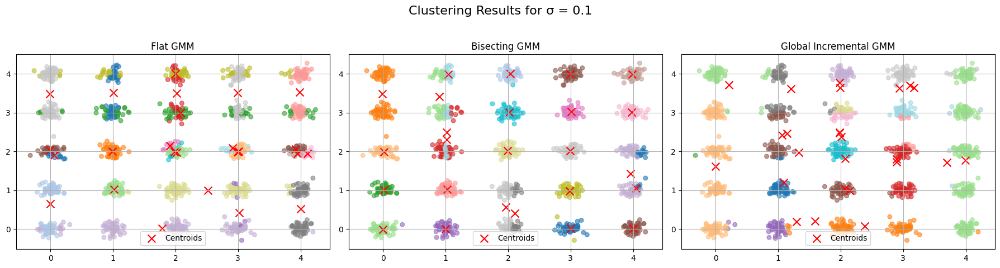

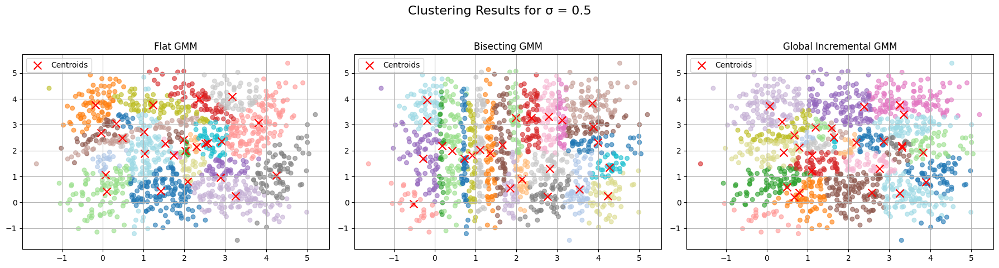

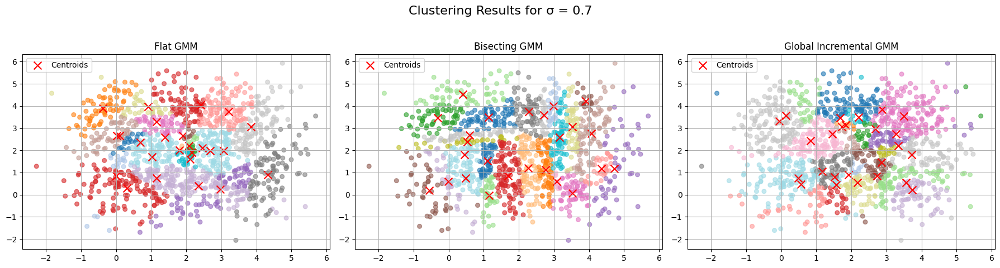

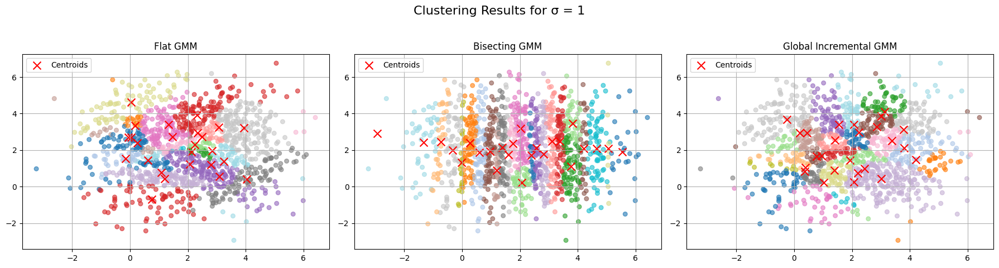

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import entropy
from sklearn.metrics import adjusted_rand_score

# -------------------------
# Data Generation Function
# -------------------------
def generate_grid_data(grid_size=5, points_per_cluster=50, sigma=0.1, random_state=None):
    """
    Generate a synthetic 2D dataset with clusters arranged in a grid.

    Parameters:
        grid_size (int): Number of clusters along each axis (total clusters = grid_size^2).
        points_per_cluster (int): Number of points per cluster.
        sigma (float): Standard deviation for Gaussian clusters.
        random_state (int, optional): Seed for reproducibility.

    Returns:
        X (ndarray): Data points of shape (grid_size^2 * points_per_cluster, 2).
        y (ndarray): True labels of shape (grid_size^2 * points_per_cluster,).
        centers (ndarray): Cluster centers of shape (grid_size^2, 2).
    """
    if random_state is not None:
        np.random.seed(random_state)

    centers = []
    for i in range(grid_size):
        for j in range(grid_size):
            center = [i, grid_size - j - 1]
            centers.append(center)
    centers = np.array(centers)

    X = []
    y = []
    for idx, center in enumerate(centers):
        points = np.random.normal(loc=center, scale=sigma, size=(points_per_cluster, 2))
        X.append(points)
        y.extend([idx] * points_per_cluster)
    X = np.vstack(X)
    y = np.array(y)
    return X, y, centers

# ---------------------------------
# GMM EM Algorithm Helper Functions
# ---------------------------------
def initialize_gmm(X, num_components):
    """
    Initialize GMM parameters.

    Parameters:
        X (ndarray): Data points of shape (n_samples, n_features).
        num_components (int): Number of GMM components.

    Returns:
        weights (ndarray): Initial weights of shape (num_components,).
        means (ndarray): Initial means of shape (num_components, n_features).
        covariances (ndarray): Initial covariances of shape (num_components, n_features, n_features).
    """
    num_samples, num_features = X.shape
    weights = np.full(num_components, 1 / num_components)
    random_indices = np.random.choice(num_samples, size=num_components, replace=False)
    means = X[random_indices]
    empirical_cov = np.cov(X.T) + 1e-6 * np.eye(num_features)
    covariances = np.array([empirical_cov.copy() for _ in range(num_components)])
    return weights, means, covariances

def multivariate_gaussian_pdf(X, mean, covariance):
    """
    Compute the multivariate Gaussian probability density function.

    Parameters:
        X (ndarray): Data points of shape (n_samples, n_features).
        mean (ndarray): Mean of shape (n_features,).
        covariance (ndarray): Covariance matrix of shape (n_features, n_features).

    Returns:
        pdf (ndarray): Probability densities of shape (n_samples,).
    """
    n_features = X.shape[1]
    diff = X - mean
    try:
        inv_cov = np.linalg.inv(covariance)
        det_cov = np.linalg.det(covariance)
    except np.linalg.LinAlgError:
        inv_cov = np.linalg.pinv(covariance)
        det_cov = np.linalg.det(covariance + 1e-6 * np.eye(n_features))
    exponent = np.einsum('ij,jk,ik->i', diff, inv_cov, diff)
    denominator = np.sqrt((2 * np.pi) ** n_features * det_cov + 1e-8)
    pdf = np.exp(-0.5 * exponent) / denominator
    return pdf

def expectation_step(X, weights, means, covariances):
    """
    E-Step of EM algorithm: compute responsibilities.

    Parameters:
        X (ndarray): Data points of shape (n_samples, n_features).
        weights (ndarray): GMM weights of shape (num_components,).
        means (ndarray): GMM means of shape (num_components, n_features).
        covariances (ndarray): GMM covariances of shape (num_components, n_features, n_features).

    Returns:
        responsibilities (ndarray): Responsibilities of shape (n_samples, num_components).
    """
    num_samples = X.shape[0]
    num_components = len(weights)
    responsibilities = np.zeros((num_samples, num_components))

    for i in range(num_components):
        responsibilities[:, i] = weights[i] * multivariate_gaussian_pdf(X, means[i], covariances[i])

    responsibilities_sum = responsibilities.sum(axis=1, keepdims=True) + 1e-8
    responsibilities /= responsibilities_sum
    return responsibilities

def maximization_step(X, responsibilities):
    """
    M-Step of EM algorithm: update GMM parameters.

    Parameters:
        X (ndarray): Data points of shape (n_samples, n_features).
        responsibilities (ndarray): Responsibilities of shape (n_samples, num_components).

    Returns:
        weights (ndarray): Updated weights of shape (num_components,).
        means (ndarray): Updated means of shape (num_components, n_features).
        covariances (ndarray): Updated covariances of shape (num_components, n_features, n_features).
    """
    num_samples, num_features = X.shape
    num_components = responsibilities.shape[1]
    Nk = responsibilities.sum(axis=0) + 1e-8
    weights = Nk / num_samples
    means = np.zeros((num_components, num_features))
    covariances = np.zeros((num_components, num_features, num_features))

    for i in range(num_components):
        resp = responsibilities[:, i].reshape(-1, 1)
        means[i] = (resp * X).sum(axis=0) / Nk[i]
        diff = X - means[i]
        covariances[i] = (resp * diff).T @ diff / Nk[i]
        covariances[i] += 1e-6 * np.eye(num_features)

    return weights, means, covariances

def compute_log_likelihood(X, weights, means, covariances):
    """
    Compute the log-likelihood of the data under the current GMM parameters.

    Parameters:
        X (ndarray): Data points of shape (n_samples, n_features).
        weights (ndarray): GMM weights of shape (num_components,).
        means (ndarray): GMM means of shape (num_components, n_features).
        covariances (ndarray): GMM covariances of shape (num_components, n_features, n_features).

    Returns:
        log_likelihood (float): Total log-likelihood.
    """
    num_samples = X.shape[0]
    total_pdf = np.zeros(num_samples)

    for i in range(len(weights)):
        total_pdf += weights[i] * multivariate_gaussian_pdf(X, means[i], covariances[i])

    log_likelihood = np.log(total_pdf + 1e-8).sum()
    return log_likelihood

def gmm_em_algorithm(X, num_components, max_iterations=100, tolerance=1e-4):
    """
    Perform the EM algorithm for GMM.

    Parameters:
        X (ndarray): Data points of shape (n_samples, n_features).
        num_components (int): Number of GMM components.
        max_iterations (int): Maximum number of EM iterations.
        tolerance (float): Convergence threshold for log-likelihood improvement.

    Returns:
        weights (ndarray): GMM weights of shape (num_components,).
        means (ndarray): GMM means of shape (num_components, n_features).
        covariances (ndarray): GMM covariances of shape (num_components, n_features, n_features).
        responsibilities (ndarray): Responsibilities of shape (n_samples, num_components).
    """
    weights, means, covariances = initialize_gmm(X, num_components)
    log_likelihood_prev = None

    for _ in range(max_iterations):
        responsibilities = expectation_step(X, weights, means, covariances)
        weights, means, covariances = maximization_step(X, responsibilities)
        log_likelihood = compute_log_likelihood(X, weights, means, covariances)
        if log_likelihood_prev is not None:
            if abs(log_likelihood - log_likelihood_prev) < tolerance:
                break
        log_likelihood_prev = log_likelihood

    return weights, means, covariances, responsibilities

# ---------------------------------
# Clustering Methods
# ---------------------------------
def flat_gmm_clustering_em(X, num_components=25):
    """
    Perform flat GMM clustering using the EM algorithm.

    Parameters:
        X (ndarray): Data points of shape (n_samples, n_features).
        num_components (int): Number of GMM components.

    Returns:
        labels (ndarray): Cluster assignments of shape (n_samples,).
        means (ndarray): Cluster means of shape (num_components, n_features).
        error (float): Negative log-likelihood error.
    """
    weights, means, covariances, responsibilities = gmm_em_algorithm(X, num_components)
    labels = responsibilities.argmax(axis=1)
    error = -compute_log_likelihood(X, weights, means, covariances)  # Negative log-likelihood
    return labels, means, error

def bisecting_gmm_clustering_em(X, target_components=25):
    """
    Perform bisecting GMM clustering using the EM algorithm.

    Parameters:
        X (ndarray): Data points of shape (n_samples, n_features).
        target_components (int): Desired number of GMM components.

    Returns:
        labels (ndarray): Cluster assignments of shape (n_samples,).
        means_all (ndarray): Cluster means of shape (target_components, n_features).
        total_error (float): Total negative log-likelihood error.
    """
    num_samples = X.shape[0]
    # Start with one Gaussian component
    weights, means, covariances, responsibilities = gmm_em_algorithm(X, num_components=1)
    clusters = [{'data': X, 'indices': np.arange(num_samples), 'weights': weights, 'means': means, 'covariances': covariances}]

    while len(clusters) < target_components:
        # Compute errors for each cluster
        errors = [
            -compute_log_likelihood(cluster['data'], cluster['weights'], cluster['means'], cluster['covariances'])
            for cluster in clusters
        ]
        # Identify the cluster with the highest error
        idx_to_split = np.argmax(errors)
        cluster_to_split = clusters.pop(idx_to_split)
        data = cluster_to_split['data']
        indices = cluster_to_split['indices']

        # Split the selected cluster into two using EM with k=2
        weights_split, means_split, covariances_split, responsibilities_split = gmm_em_algorithm(data, num_components=2)
        split_labels = responsibilities_split.argmax(axis=1)

        # Create two new clusters from the split
        for i in range(2):
            cluster_data = data[split_labels == i]
            cluster_indices = indices[split_labels == i]
            if len(cluster_data) > 0:
                cluster_weights = np.array([weights_split[i]])
                cluster_means = means_split[[i]]
                cluster_covariances = covariances_split[[i]]
                clusters.append({
                    'data': cluster_data,
                    'indices': cluster_indices,
                    'weights': cluster_weights,
                    'means': cluster_means,
                    'covariances': cluster_covariances
                })
            else:
                print("Encountered an empty sub-cluster and ignored it.")

    # Assign labels based on final clusters
    labels = np.zeros(num_samples, dtype=int)
    means_all = []
    total_error = 0.0
    for cluster_idx, cluster in enumerate(clusters):
        indices = cluster['indices']
        labels[indices] = cluster_idx
        means_all.append(cluster['means'][0])
        total_error += -compute_log_likelihood(cluster['data'], cluster['weights'], cluster['means'], cluster['covariances'])

    means_all = np.array(means_all)
    return labels, means_all, total_error

def global_incremental_gmm_clustering_em(X, target_components=25, candidate_size=50):
    """
    Perform global incremental GMM clustering using the EM algorithm.

    Parameters:
        X (ndarray): Data points of shape (n_samples, n_features).
        target_components (int): Desired number of GMM components.
        candidate_size (int): Number of candidate points to consider for new components.

    Returns:
        labels (ndarray): Cluster assignments of shape (n_samples,).
        means (ndarray): Cluster means of shape (target_components, n_features).
        final_error (float): Final clustering error (negative log-likelihood).
    """
    # Start with one component
    weights, means, covariances, responsibilities = gmm_em_algorithm(X, num_components=1)
    best_model = {'weights': weights, 'means': means, 'covariances': covariances}
    final_error = -compute_log_likelihood(X, weights, means, covariances)
    print(f"Initial Components: {len(best_model['weights'])}, Error: {final_error:.2f}")

    while len(best_model['weights']) < target_components:
        min_error = np.inf
        best_candidate = None

        # Sample candidate points
        candidate_indices = np.random.choice(len(X), size=min(candidate_size, len(X)), replace=False)
        for candidate_idx in candidate_indices:
            # Create a new model with one additional component
            k_new = len(best_model['weights']) + 1
            means_init = np.vstack([best_model['means'], X[candidate_idx]])
            # Initialize weights uniformly
            weights_init = np.full(k_new, 1 / k_new)
            # Initialize covariances to empirical covariance with regularization
            empirical_cov = np.cov(X.T) + 1e-6 * np.eye(X.shape[1])
            covariances_init = np.array([empirical_cov.copy() for _ in range(k_new)])

            # Run EM algorithm with initialization
            weights_candidate, means_candidate, covariances_candidate, _ = gmm_em_algorithm(X, num_components=k_new, max_iterations=10)
            error = -compute_log_likelihood(X, weights_candidate, means_candidate, covariances_candidate)

            if error < min_error:
                min_error = error
                best_candidate = {
                    'weights': weights_candidate,
                    'means': means_candidate,
                    'covariances': covariances_candidate
                }

        if best_candidate:
            best_model = best_candidate
            final_error = min_error
            print(f"Components: {len(best_model['weights'])}, Error: {final_error:.2f}")
        else:
            print("No candidate improved the error. Stopping.")
            break

    # Assign labels based on final responsibilities
    responsibilities_final = expectation_step(X, best_model['weights'], best_model['means'], best_model['covariances'])
    labels = responsibilities_final.argmax(axis=1)

    return labels, best_model['means'], final_error

# ---------------------------------
# Clustering Execution and Visualization
# ---------------------------------
def run_gmm_clustering_experiments():
    """
    Run GMM clustering experiments on synthetic datasets with varying sigma values.

    Generates datasets, applies different GMM clustering methods, and summarizes the errors.

    Returns:
        results_em (dict): Dictionary containing clustering results for each sigma value.
    """
    # Define sigma values (standard deviations)
    sigma_values = [0.1, 0.5, 0.7, 1]
    results_em = {}
    k_star = 25  # Number of desired clusters

    for sigma in sigma_values:
        print(f"\n--- Processing for σ = {sigma} ---")
        # Generate grid dataset
        X_grid, y_true, centers_grid = generate_grid_data(grid_size=5, points_per_cluster=50, sigma=sigma, random_state=42)

        # Method 1: Flat GMM with EM
        print("Method 1: Flat GMM with EM")
        labels_flat, means_flat, error_flat = flat_gmm_clustering_em(X_grid, num_components=k_star)
        print(f"Flat GMM Error: {error_flat:.2f}")

        # Method 2: Bisecting GMM with EM
        print("Method 2: Bisecting GMM with EM")
        labels_bisect, means_bisect, error_bisect = bisecting_gmm_clustering_em(X_grid, target_components=k_star)
        print(f"Bisecting GMM Error: {error_bisect:.2f}")

        # Method 3: Global Incremental GMM with EM
        print("Method 3: Global Incremental GMM with EM")
        labels_global, means_global, error_global = global_incremental_gmm_clustering_em(
            X_grid, target_components=k_star, candidate_size=50
        )
        print(f"Global Incremental GMM Error: {error_global:.2f}")

        # Store the results
        results_em[sigma] = {
            'flat': {'labels': labels_flat, 'means': means_flat, 'error': error_flat},
            'bisect': {'labels': labels_bisect, 'means': means_bisect, 'error': error_bisect},
            'global': {'labels': labels_global, 'means': means_global, 'error': error_global},
            'true_labels': y_true,
            'X': X_grid
        }

    # Summary of Clustering Errors
    print("\n--- Summary of Clustering Errors ---")
    print("σ\tFlat GMM\tBisecting GMM\tGlobal Incremental GMM")
    for sigma in sigma_values:
        error_flat = results_em[sigma]['flat']['error']
        error_bisect = results_em[sigma]['bisect']['error']
        error_global = results_em[sigma]['global']['error']
        print(f"{sigma}\t{error_flat:.2f}\t\t{error_bisect:.2f}\t\t{error_global:.2f}")

    # Visualization of Clustering Results
    for sigma in sigma_values:
        X = results_em[sigma]['X']
        y_true = results_em[sigma]['true_labels']
        labels_flat = results_em[sigma]['flat']['labels']
        labels_bisect = results_em[sigma]['bisect']['labels']
        labels_global = results_em[sigma]['global']['labels']
        means_flat = results_em[sigma]['flat']['means']
        means_bisect = results_em[sigma]['bisect']['means']
        means_global = results_em[sigma]['global']['means']

        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        fig.suptitle(f"Clustering Results for σ = {sigma}", fontsize=16)

        # Plot Flat GMM results
        axs[0].scatter(X[:, 0], X[:, 1], c=labels_flat, cmap='tab20', s=30, alpha=0.6)
        axs[0].scatter(means_flat[:, 0], means_flat[:, 1], c='red', marker='x', s=100, label='Centroids')
        axs[0].set_title("Flat GMM")
        axs[0].legend()
        axs[0].grid(True)

        # Plot Bisecting GMM results
        axs[1].scatter(X[:, 0], X[:, 1], c=labels_bisect, cmap='tab20', s=30, alpha=0.6)
        axs[1].scatter(means_bisect[:, 0], means_bisect[:, 1], c='red', marker='x', s=100, label='Centroids')
        axs[1].set_title("Bisecting GMM")
        axs[1].legend()
        axs[1].grid(True)

        # Plot Global Incremental GMM results
        axs[2].scatter(X[:, 0], X[:, 1], c=labels_global, cmap='tab20', s=30, alpha=0.6)
        axs[2].scatter(means_global[:, 0], means_global[:, 1], c='red', marker='x', s=100, label='Centroids')
        axs[2].set_title("Global Incremental GMM")
        axs[2].legend()
        axs[2].grid(True)

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

    return results_em

# ---------------------------------
# Main Execution
# ---------------------------------
if __name__ == "__main__":
    results = run_gmm_clustering_experiments()


-------
**f) Challenges of Using the Bisecting Principle with GMM and a Simple Solution**

----------
#### **Main Challenge: Soft Assignments and Overlapping Clusters**

**Issue:**
The bisecting method works well with algorithms like k-means, where each data point belongs to one clear cluster. However, Gaussian Mixture Models (GMM) assign probabilities to each point for belonging to different clusters. This makes it difficult to decide which cluster to split. Additionally, GMM clusters can overlap, complicating the separation of a single cluster without affecting others. Moreover, the parameters of GMMs—means, covariances, and mixture weights—are interconnected, so splitting a cluster requires careful adjustment to maintain model accuracy.

#### **Simple Solution: Split Clusters Along Their Main Direction**

**Steps:**

1. **Select the Cluster to Split:**
   - Choose the cluster with the highest weight or the most significant contribution to the model.

2. **Determine the Main Direction:**
   - Analyze the cluster’s covariance matrix to find the principal axis—the direction with the most variance.

3. **Create Two New Centers:**
   - Move the original cluster’s mean slightly in opposite directions along the principal axis to establish two new centers.

4. **Keep Consistent Shapes:**
   - Use the original covariance matrix for both new clusters to maintain their shape and spread.

5. **Adjust Cluster Weights:**
   - Split the original cluster’s weight equally between the two new clusters to keep the model balanced.

6. **Refit the GMM:**
   - Run the Expectation-Maximization (EM) algorithm to fine-tune the model. EM will adjust the means, covariances, and weights based on the new cluster centers, ensuring the model accurately represents the data.

In [ ]:
import numpy as np

# -------------------------
# Heuristic Bisecting GMM Clustering
# -------------------------
def heuristic_bisecting_gmm_clustering(X, k_star=25, responsibility_threshold=0.6, max_iters=100, tolerance=1e-4):
    """
    Perform bisecting Gaussian Mixture Model (GMM) clustering using a heuristic approach.

    Parameters:
        X (ndarray): Data points of shape (n_samples, n_features).
        k_star (int): Desired number of GMM components/clusters.
        responsibility_threshold (float): Threshold to select high-responsibility points for splitting.
        max_iters (int): Maximum number of iterations for the EM algorithm.
        tolerance (float): Convergence threshold for log-likelihood improvement.

    Returns:
        labels (ndarray): Cluster assignments of shape (n_samples,).
        means (ndarray): Cluster means of shape (k_star, n_features).
        error_total (float): Total negative log-likelihood error of the final model.
    """
    # Initialize with a single GMM component
    print("Initializing with a single GMM component.")
    weights, means, covariances, responsibilities = gmm_em_algorithm(X, num_components=1, max_iterations=max_iters, tolerance=tolerance)
    clusters = [{
        'data_indices': np.arange(len(X)),
        'weights': weights,
        'means': means,
        'covariances': covariances
    }]

    # Iterate until the desired number of clusters is reached
    while len(clusters) < k_star:
        # Calculate errors for each cluster
        errors = []
        for cluster in clusters:
            data_indices = cluster['data_indices']
            data = X[data_indices]
            weights_c = cluster['weights']
            means_c = cluster['means']
            covariances_c = cluster['covariances']
            error = -compute_log_likelihood(data, weights_c, means_c, covariances_c)
            errors.append(error)

        # Identify the cluster with the highest error
        idx_to_split = np.argmax(errors)
        cluster_to_split = clusters.pop(idx_to_split)
        print(f"Splitting cluster {idx_to_split} with error {errors[idx_to_split]:.2f}")

        # Extract data from the cluster to be split
        data_indices = cluster_to_split['data_indices']
        data = X[data_indices]

        # Perform the E-step to obtain responsibilities
        responsibilities_c = expectation_step(data, cluster_to_split['weights'], cluster_to_split['means'], cluster_to_split['covariances'])

        # Select data points with high responsibility for splitting
        high_resp_mask = responsibilities_c[:, 0] >= responsibility_threshold
        high_resp_indices = data_indices[high_resp_mask]
        data_high_resp = X[high_resp_indices]

        if len(data_high_resp) < 2:
            # Not enough data points to split the cluster
            clusters.append(cluster_to_split)
            print("Insufficient high-responsibility data points to split the cluster. Skipping split.")
            continue

        # Split the selected cluster into two using EM with k=2
        print("Splitting the cluster into two sub-clusters.")
        weights_split, means_split, covariances_split, responsibilities_split = gmm_em_algorithm(
            data_high_resp, num_components=2, max_iterations=max_iters, tolerance=tolerance
        )
        labels_split = np.argmax(responsibilities_split, axis=1)

        # Create two new clusters from the split
        for i in range(2):
            split_mask = labels_split == i
            split_data_indices = high_resp_indices[split_mask]
            if len(split_data_indices) > 0:
                clusters.append({
                    'data_indices': split_data_indices,
                    'weights': np.array([weights_split[i]]),
                    'means': means_split[[i]],
                    'covariances': covariances_split[[i]]
                })
                print(f"Created sub-cluster {i} with {len(split_data_indices)} data points.")
            else:
                print("Encountered an empty sub-cluster and ignored it.")

    # Combine all clusters to form the final GMM parameters
    print("Combining all clusters to form the final GMM model.")
    k_total = len(clusters)
    weights = np.array([cluster['weights'][0] * len(cluster['data_indices']) / len(X) for cluster in clusters])
    weights /= weights.sum()  # Normalize weights
    means = np.vstack([cluster['means'][0] for cluster in clusters])
    covariances = np.array([cluster['covariances'][0] for cluster in clusters])

    # Optionally: Refit the global GMM with the aggregated parameters
    print("Refitting the global GMM model with the aggregated parameters.")
    weights, means, covariances, responsibilities = gmm_em_algorithm(
        X, num_components=k_total, max_iterations=max_iters, tolerance=tolerance
    )
    labels = np.argmax(responsibilities, axis=1)
    error_total = -compute_log_likelihood(X, weights, means, covariances)

    print(f"Final model has {k_total} components with total error {error_total:.2f}")
    return labels, means, error_total



--- Testing with sigma = 0.1 ---
Initializing with a single GMM component.
Splitting cluster 0 with error 3547.35
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 500 data points.
Created sub-cluster 1 with 750 data points.
Splitting cluster 1 with error 2074.50
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 450 data points.
Created sub-cluster 1 with 300 data points.
Splitting cluster 0 with error 1407.39
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 250 data points.
Created sub-cluster 1 with 250 data points.
Splitting cluster 0 with error 996.22
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 150 data points.
Created sub-cluster 1 with 300 data points.
Splitting cluster 0 with error 672.58
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 100 data points.
Created sub-cluster 1 with 200 data points.
Splitting cluster 3 with error 495.43
Splitting the cluster into t

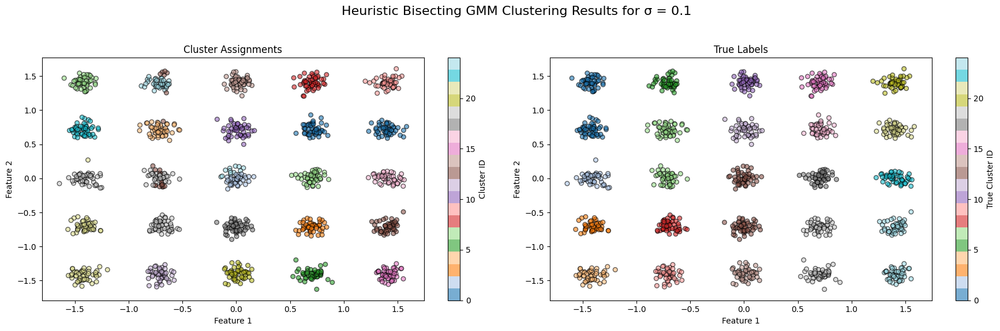

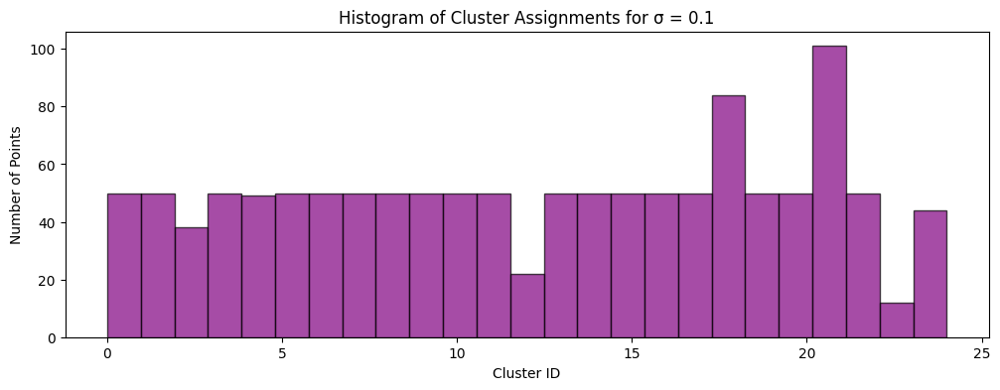


--- Testing with sigma = 0.3 ---
Initializing with a single GMM component.
Splitting cluster 0 with error 3547.34
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 493 data points.
Created sub-cluster 1 with 757 data points.
Splitting cluster 1 with error 2121.55
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 448 data points.
Created sub-cluster 1 with 309 data points.
Splitting cluster 0 with error 1414.33
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 252 data points.
Created sub-cluster 1 with 241 data points.
Splitting cluster 0 with error 1020.49
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 322 data points.
Created sub-cluster 1 with 126 data points.
Splitting cluster 0 with error 710.20
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 155 data points.
Created sub-cluster 1 with 154 data points.
Splitting cluster 2 with error 546.51
Splitting the cluster into 

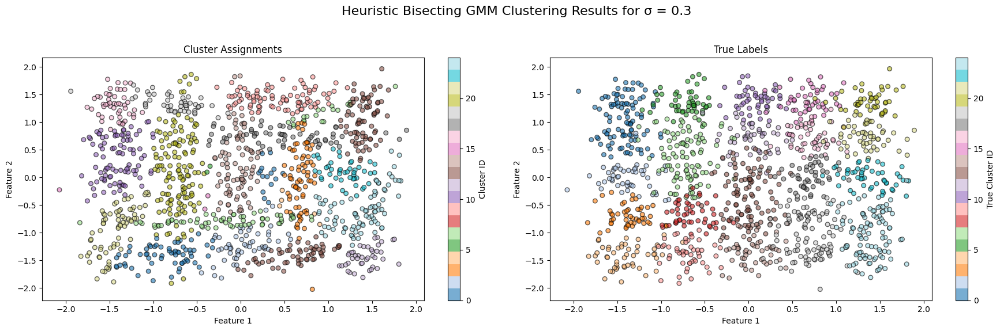

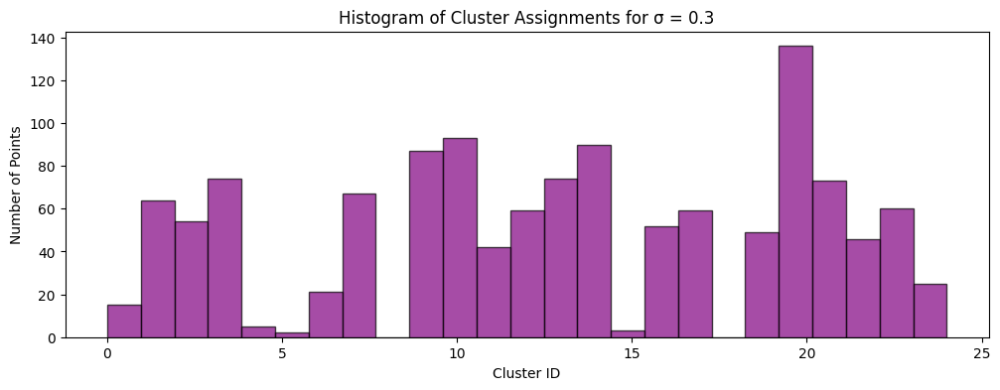


--- Testing with sigma = 0.5 ---
Initializing with a single GMM component.
Splitting cluster 0 with error 3547.34
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 575 data points.
Created sub-cluster 1 with 675 data points.
Splitting cluster 1 with error 1919.02
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 384 data points.
Created sub-cluster 1 with 291 data points.
Splitting cluster 0 with error 1677.73
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 327 data points.
Created sub-cluster 1 with 248 data points.
Splitting cluster 0 with error 895.35
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 210 data points.
Created sub-cluster 1 with 174 data points.
Splitting cluster 1 with error 747.36
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 271 data points.
Created sub-cluster 1 with 56 data points.
Splitting cluster 0 with error 651.95
Splitting the cluster into tw

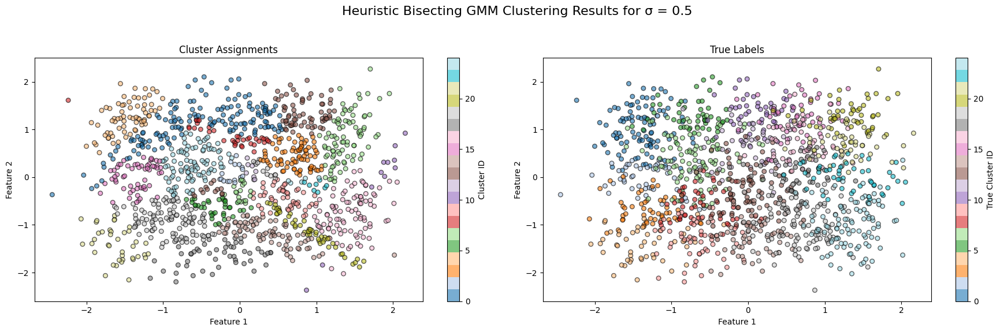

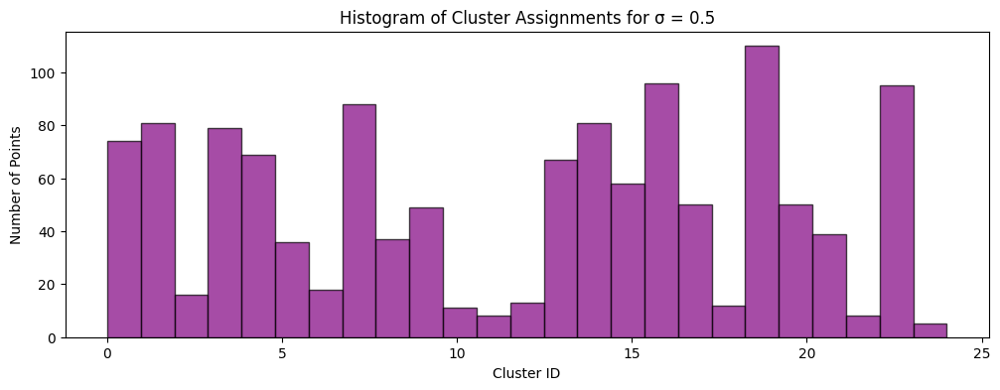


--- Testing with sigma = 0.7 ---
Initializing with a single GMM component.
Splitting cluster 0 with error 3547.34
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 588 data points.
Created sub-cluster 1 with 662 data points.
Splitting cluster 1 with error 1903.60
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 292 data points.
Created sub-cluster 1 with 370 data points.
Splitting cluster 0 with error 1748.49
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 342 data points.
Created sub-cluster 1 with 246 data points.
Splitting cluster 1 with error 835.53
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 258 data points.
Created sub-cluster 1 with 112 data points.
Splitting cluster 1 with error 809.71
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 213 data points.
Created sub-cluster 1 with 129 data points.
Splitting cluster 0 with error 678.47
Splitting the cluster into t

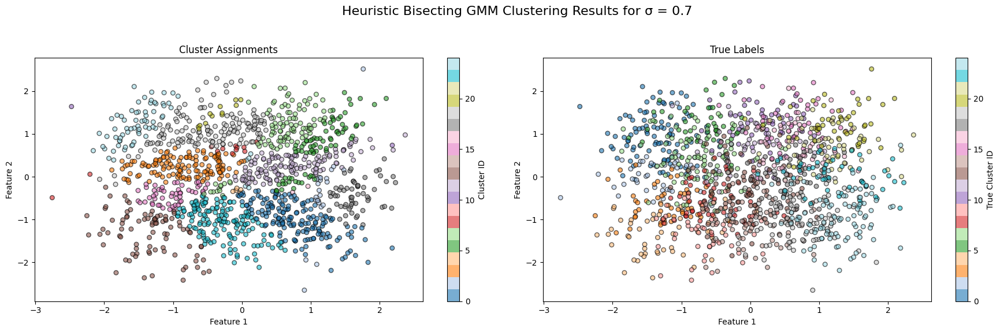

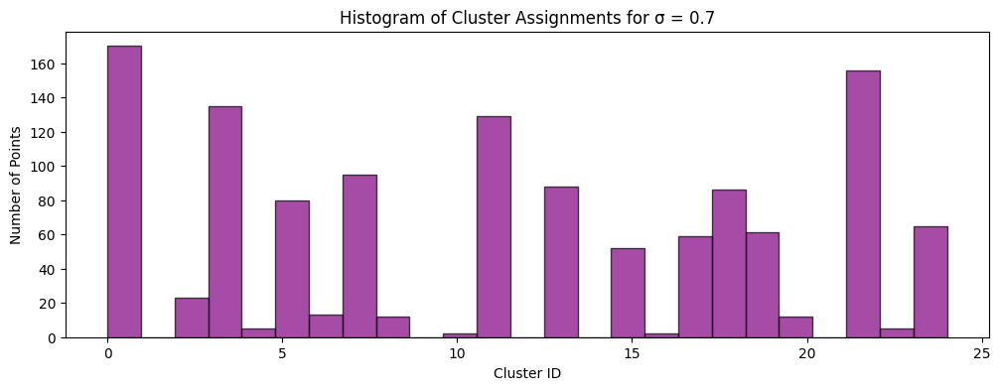


--- Testing with sigma = 1.0 ---
Initializing with a single GMM component.
Splitting cluster 0 with error 3547.34
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 493 data points.
Created sub-cluster 1 with 757 data points.
Splitting cluster 1 with error 2180.78
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 202 data points.
Created sub-cluster 1 with 555 data points.
Splitting cluster 0 with error 1559.91
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 280 data points.
Created sub-cluster 1 with 213 data points.
Splitting cluster 1 with error 1330.38
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 240 data points.
Created sub-cluster 1 with 315 data points.
Splitting cluster 4 with error 762.59
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 131 data points.
Created sub-cluster 1 with 184 data points.
Splitting cluster 1 with error 685.57
Splitting the cluster into 

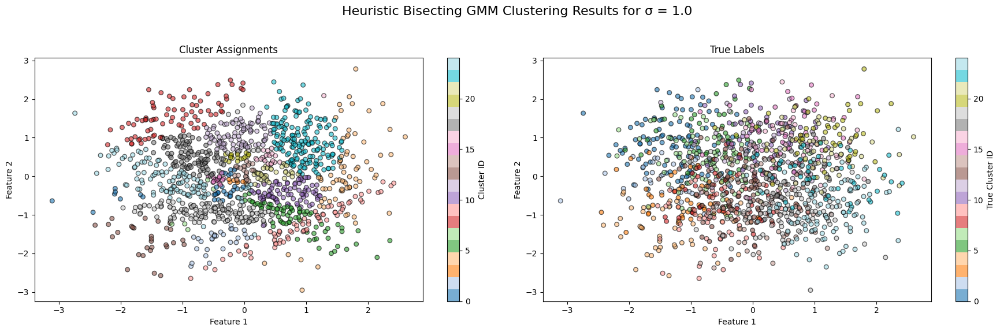

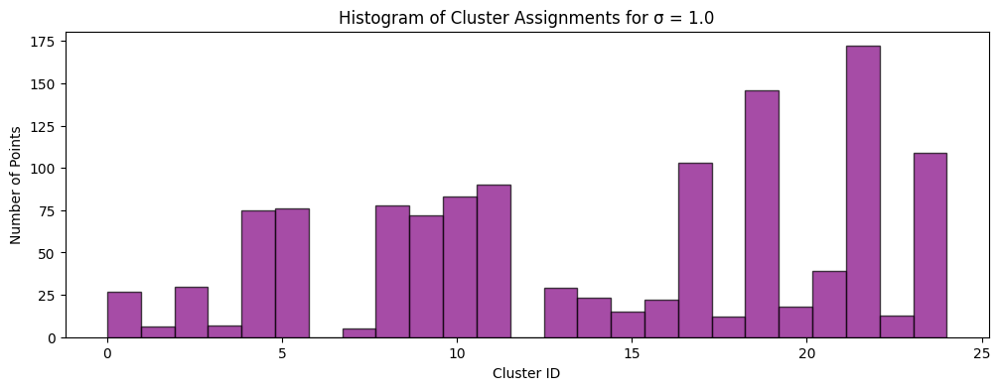


--- Summary of Clustering Performance ---
σ	ARI		Error
0.1	0.9065		1042.96
0.3	0.4386		3118.81
0.5	0.2558		3333.33
0.7	0.1653		3419.08
1.0	0.1082		3479.78


In [ ]:
# ---------------------------------
# Testing Framework for Different Sigma Values
# ---------------------------------
def run_heuristic_bisecting_gmm_tests():
    # Define sigma values to test
    sigma_values = [0.1, 0.3, 0.5, 0.7, 1.0]
    k_star = 25  # Desired number of clusters
    responsibility_threshold = 0.6  # Threshold for splitting

    # Initialize results storage
    results = {}

    for sigma in sigma_values:
        print(f"\n--- Testing with sigma = {sigma} ---")

        # Generate synthetic dataset
        X, y_true, centers = generate_grid_data(grid_size=5, points_per_cluster=50, sigma=sigma, random_state=42)

        # Scale the dataset
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X)

        # Apply Heuristic Bisecting GMM Clustering
        labels, means, error_total = heuristic_bisecting_gmm_clustering(
            X_scaled, k_star=k_star, responsibility_threshold=responsibility_threshold
        )

        # Evaluate Clustering Performance
        ari = adjusted_rand_score(y_true, labels)
        print(f"Adjusted Rand Index (ARI): {ari:.4f}")
        print(f"Total Negative Log-Likelihood Error: {error_total:.2f}")

        # Store results
        results[sigma] = {
            'labels': labels,
            'means': means,
            'error_total': error_total,
            'ari': ari,
            'X': X_scaled,
            'y_true': y_true
        }

        # Visualization of Clustering Results
        plt.figure(figsize=(18, 6))
        plt.suptitle(f"Heuristic Bisecting GMM Clustering Results for σ = {sigma}", fontsize=16)

        # Scatter Plot with Cluster Assignments
        plt.subplot(1, 2, 1)
        scatter = plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=labels, cmap='tab20', s=30, alpha=0.6, edgecolor='k')
        plt.title("Cluster Assignments")
        plt.xlabel("Feature 1")
        plt.ylabel("Feature 2")
        plt.colorbar(scatter, label="Cluster ID")

        # Scatter Plot with True Labels
        plt.subplot(1, 2, 2)
        scatter_true = plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=y_true, cmap='tab20', s=30, alpha=0.6, edgecolor='k')
        plt.title("True Labels")
        plt.xlabel("Feature 1")
        plt.ylabel("Feature 2")
        plt.colorbar(scatter_true, label="True Cluster ID")

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

        # Histogram of Cluster Assignments
        plt.figure(figsize=(12, 4))
        plt.hist(labels, bins=k_star, color='purple', alpha=0.7, edgecolor='black')
        plt.title(f"Histogram of Cluster Assignments for σ = {sigma}")
        plt.xlabel("Cluster ID")
        plt.ylabel("Number of Points")
        plt.show()

    # Summary of Results
    print("\n--- Summary of Clustering Performance ---")
    print("σ\tARI\t\tError")
    for sigma in sigma_values:
        ari = results[sigma]['ari']
        error = results[sigma]['error_total']
        print(f"{sigma}\t{ari:.4f}\t\t{error:.2f}")

    return results

# ---------------------------------
# Main Execution
# ---------------------------------
if __name__ == "__main__":
    clustering_results = run_heuristic_bisecting_gmm_tests()


Initializing with a single GMM component.
Splitting cluster 0 with error 4413.24
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 500 data points.
Created sub-cluster 1 with 750 data points.
Splitting cluster 1 with error 2594.03
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 450 data points.
Created sub-cluster 1 with 300 data points.
Splitting cluster 0 with error 1753.75
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 250 data points.
Created sub-cluster 1 with 250 data points.
Splitting cluster 0 with error 1307.94
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 150 data points.
Created sub-cluster 1 with 300 data points.
Splitting cluster 0 with error 880.40
Splitting the cluster into two sub-clusters.
Created sub-cluster 0 with 100 data points.
Created sub-cluster 1 with 200 data points.
Splitting cluster 3 with error 703.24
Splitting the cluster into two sub-clusters.
Created sub-clus

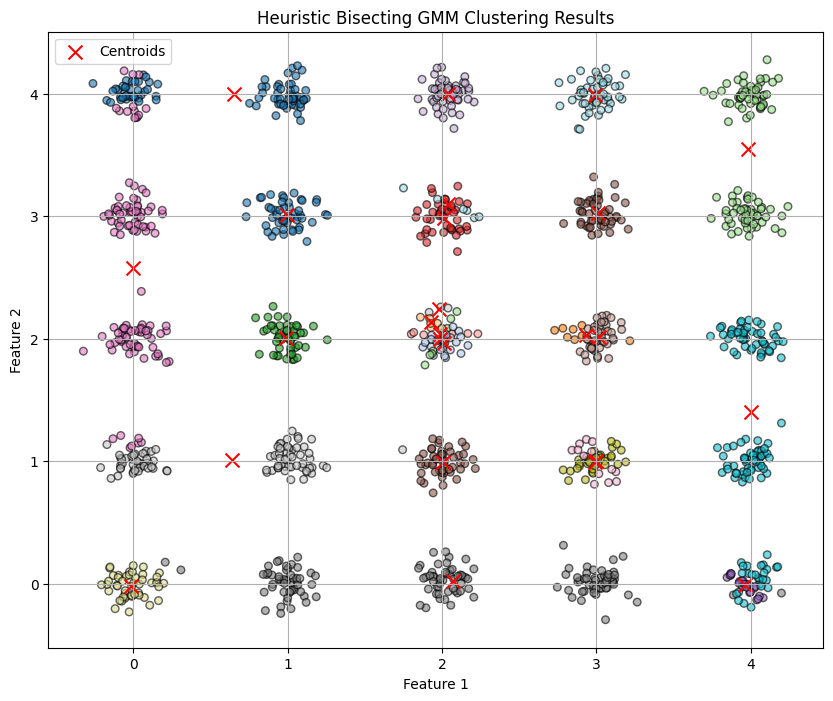

Adjusted Rand Index (ARI): 0.64


In [ ]:
# Main Execution for Heuristic Bisecting GMM Clustering
if __name__ == "__main__":
    # Generate a synthetic dataset
    X, y_true, centers = generate_grid_data(grid_size=5, points_per_cluster=50, sigma=0.1, random_state=42)

    # Perform heuristic bisecting GMM clustering
    labels, means, total_error = heuristic_bisecting_gmm_clustering(
        X, k_star=25, responsibility_threshold=0.6, max_iters=100, tolerance=1e-4
    )

    # Visualization of clustering results
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(X[:, 0], X[:, 1], c=labels, cmap='tab20', s=30, alpha=0.6, edgecolor='k')
    plt.scatter(means[:, 0], means[:, 1], c='red', marker='x', s=100, label='Centroids')
    plt.title("Heuristic Bisecting GMM Clustering Results")
    plt.xlabel("Feature 1")
    plt.ylabel("Feature 2")
    plt.legend()
    plt.grid(True)
    plt.show()

    # Optional: Compute and display Adjusted Rand Score
    ari = adjusted_rand_score(y_true, labels)
    print(f"Adjusted Rand Index (ARI): {ari:.2f}")


### References

- A. Likas et al., "[The global k-means algorithm](https://hal.inria.fr/inria-00321515/document)," *Pattern Recognition*, 2003.

- G. Vardakas et al., "[Global k-means++: an effective relaxation of the global k-means clustering algorithm](https://arxiv.org/pdf/2211.12271)," 2022.

1. **Scikit-learn Documentation**
   - **Gaussian Mixture Models:** [GaussianMixture](https://scikit-learn.org/stable/modules/generated/sklearn.mixture.GaussianMixture.html)
   - **K-Means Clustering:** [KMeans](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)
   - **Pairwise Distances:** [pairwise_distances_argmin_min](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.pairwise_distances_argmin_min.html)
   - **StandardScaler:** [StandardScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html)

2. **Matplotlib Documentation**
   - **Ellipse Patch:** [matplotlib.patches.Ellipse](https://matplotlib.org/stable/api/_as_gen/matplotlib.patches.Ellipse.html)
   - **Plotting Basics:** [Matplotlib Pyplot Tutorial](https://matplotlib.org/stable/tutorials/introductory/pyplot.html)

3. **NumPy Documentation**
   - **NumPy Reference:** [NumPy Documentation](https://numpy.org/doc/)

4. **Gaussian Mixture Models**
   - **Book Reference:** Bishop, C. M. (2006). *Pattern Recognition and Machine Learning*. Springer. [Chapter 9: Mixture Models and EM](https://www.cs.toronto.edu/~vmnih/docs/Bishop.pdf)

5. **K-Means Clustering**
   - **Original Paper:** MacQueen, J. (1967). "Some Methods for Classification and Analysis of Multivariate Observations." *Proceedings of the Fifth Berkeley Symposium on Mathematical Statistics and Probability*, Volume 1: Statistics, pp. 281–297.

6. **Bisecting K-Means**
   - **Research Paper:** Jain, A. K. (2010). "Data clustering: 50 years beyond K-means." *Pattern Recognition Letters*, 31(8), 651-666.

7. **Expectation-Maximization Algorithm**
   - **Foundational Paper:** Dempster, A. P., Laird, N. M., & Rubin, D. B. (1977). "Maximum likelihood from incomplete data via the EM algorithm." *Journal of the Royal Statistical Society: Series B (Methodological)*, 39(1), 1-38.

8. **Scikit-image Documentation**
   - **Data Module:** [skimage.data](https://scikit-image.org/docs/stable/api/skimage.data.html)

9. **Tutorials and Guides**
   - **Clustering Tutorial:** [Scikit-learn Clustering](https://scikit-learn.org/stable/modules/clustering.html)
   - **Gaussian Mixture Models Explained:** [Understanding GMM](https://towardsdatascience.com/gaussian-mixture-models-gmm-explained-in-plain-english-5f4d0b9e61dc)
   - **K-Means Clustering Example:** [K-Means Tutorial on GeeksforGeeks](https://www.geeksforgeeks.org/python-k-means-clustering-example/)

10. **Additional Resources**
    - **Sklearn EM Algorithm Overview:** [EM Algorithm in Scikit-learn](https://scikit-learn.org/stable/modules/mixture.html#mixture-models)
    - **Mathematical Background on Eigen Decomposition:** [Eigenvalues and Eigenvectors](https://numpy.org/doc/stable/reference/generated/numpy.linalg.eigh.html)




## Exercise 5 - [10%]

Given a dataset $X = \{x_1,...,x_N\}$, $x_i \in \mathbb{R}^d$ and a distance measure computed by the function $dist(x_i, x_j) : X \times X \mapsto \mathbb{R}$, one can define a procedure that *reweights* the distances as:
$$
    dist'(x_i, x_j) = w_{ij} * dist(x_i, x_j)
$$
where $w_{ij} \in \mathbb{R}^+$. The aim is to bring datapoints that are related closer and to distanciate others that are less related.

* **Kernels:** A typical low-level approach used is by employing a kernel, e.g. the RBF-kernel (radial basis function)
$$
     w_{ij} := 1 / (1+RBFkernel(x_i, x_j)) = 1 / (1 + \exp\{-\gamma \Vert x_i - x_j \Vert^2_2\})
$$
where $\gamma = \frac{1}{2\sigma^2}$.

* **Cluster-based:** Alternatively, cluster-based high-level approaches can be employed. The idea is that we could cluster the dataset and exploit its cluster structure to determine a better $w_{ij}$.
    * Flat clustering (e.g. $k$-means): Generate one or more clustering results and compute the frequency the two datapoints $x_i$ and $x_j$ get clustered together.
    * Hierarchical clustering (e.g. HAC or bisecting $k$-means): Given the learned cluster hierarchy, we could define the proximity between two datapoints $x_i$ and $x_j$ based on the depth in the hierarchy (let that be $h_{ij}$) at which they get separated.
    * Incremental clustering (e.g. global $k$-means): (deliberately not explained how this would work).
    
For this exercise, you will need to:

a) Implement the above concepts and approaches: the simple kernel-based approach, and the three cluster-based approaches. For the incremental clustering one, you will need to devise a way to build a meaningful measure.

b) Use generated synthetic data, like those in the previous exercise, to demonstrate the correctness of your implementation and the behavior of the approaches.


## Exercise 5 - [10%]
### **a) Implementing Distance Reweighting Approaches**

In this part, we'll implement two main strategies to reweight distances in a dataset:

1. **Kernel-Based Approach (RBF Kernel)**
2. **Cluster-Based Approaches:**
   - **Flat Clustering (k-means)**
   - **Hierarchical Clustering ( Agglomerative)**
   - **Incremental Clustering (Global k-means )**

#### **1. Kernel-Based Approach (RBF Kernel)**

The Radial Basis Function (RBF) kernel assigns higher weights to closer points and lower weights to distant ones.


- **Distance Calculation:** We compute the pairwise squared Euclidean distances between all datapoints using pairwise_distances.
- **RBF Kernel Application:** The RBF kernel formula transforms these distances into weights. The parameter 𝛾 controls the sensitivity; higher 𝛾 values lead to sharper distinctions between close and distant points.
- **Visualization:** The weight matrix 𝑊 is visualized using a heatmap, where warmer colors indicate higher weights (closer datapoints).


#### **2. Cluster-Based Approaches**
**a. Flat Clustering (k-means)**

Here, we use k-means to cluster the data and assign weights based on how often two points are in the same cluster across multiple runs.

- **Multiple Runs:** The function runs k-means clustering n_runs times to capture the variability in cluster assignments.
- **Co-occurrence Matrix:** For each run, it increments the co-occurrence count for pairs of datapoints that are assigned to the same cluster.
- **Normalization:** The co-occurrence counts are normalized by the number of runs to obtain frequencies between 0 and 1.
- **Visualization:** The weight matrix 𝑊 is visualized, where higher weights indicate higher co-occurrence frequencies.

**b. Hierarchical Clustering (Agglomerative)**
Using hierarchical clustering, we define weights based on the level at which two points are separated in the cluster hierarchy.

Hierarchical Clustering: The linkage function constructs the hierarchical clustering tree using the specified linkage method (e.g., Ward's method).
Cluster Formation: The fcluster function cuts the dendrogram at the given threshold to form flat clusters.
Weight Assignment: The compute_cluster_weights function assigns a weight of 1 to pairs within the same cluster and 0 otherwise.
Visualization: The weight matrix
𝑊 is visualized, showing distinct blocks for clusters.

**c. Incremental Clustering (Global k-means)**

we'll implement a heuristic inspired by global k-means, where clusters are incrementally added based on minimizing inertia.


In [205]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances, adjusted_rand_score
from scipy.cluster.hierarchy import linkage, fcluster
from sklearn.metrics import pairwise_distances_argmin_min

# -------------------------
# a . Reweighting Functions
# -------------------------

def rbf_kernel_reweight(X, gamma=1.0):

    pairwise_sq_dists = pairwise_distances(X, X, metric='sqeuclidean')
    W = 1 / (1 + np.exp(-gamma * pairwise_sq_dists))
    return W

def flat_clustering_reweight(X, k=3, n_runs=10):
    n_samples = X.shape[0]
    co_occurrence = np.zeros((n_samples, n_samples))

    for run in range(n_runs):
        kmeans = KMeans(n_clusters=k, random_state=None)
        labels = kmeans.fit_predict(X)
        for i in range(n_samples):
            co_occurrence[i, labels == labels[i]] += 1

    # Normalize the co-occurrence matrix
    W = co_occurrence / n_runs
    return W

def hierarchical_clustering_reweight(X, method="ward", threshold=7, criterion="distance"):
    Z = linkage(X, method=method)
    clusters = fcluster(Z, t=threshold, criterion=criterion)
    W = compute_cluster_weights(clusters, len(X))
    return W

def compute_cluster_weights(clusters, n_points):
    W = np.zeros((n_points, n_points))
    for i in range(n_points):
        same_cluster = (clusters == clusters[i])
        W[i, same_cluster] = 1
        W[i, ~same_cluster] = 0
    return W

def global_kmeans_reweight(X, max_clusters=3):
    kmeans = KMeans(n_clusters=max_clusters, random_state=42)
    labels = kmeans.fit_predict(X)

    # Compute the weight matrix based on cluster assignments
    W = np.zeros((X.shape[0], X.shape[0]))
    for i in range(X.shape[0]):
        W[i, labels == labels[i]] = 1
        W[i, labels != labels[i]] = 0.5  # Heuristic
    return W

def incremental_clustering_reweight(X, max_clusters=3, candidate_size=50):
    n_samples = X.shape[0]
    labels = np.zeros(n_samples, dtype=int)
    centroids = [np.mean(X, axis=0)]  # Initialize with the overall mean

    for k in range(1, max_clusters):
        best_inertia = float('inf')
        best_centroid = None
        best_labels = None

        # Sample candidate points
        candidate_indices = np.random.choice(n_samples, size=min(candidate_size, n_samples), replace=False)
        for idx in candidate_indices:
            temp_centroids = centroids + [X[idx]]
            temp_centroids_array = np.array(temp_centroids)
            temp_labels, _ = pairwise_distances_argmin_min(X, temp_centroids_array)
            inertia = np.sum((X - temp_centroids_array[temp_labels])**2)
            if inertia < best_inertia:
                best_inertia = inertia
                best_centroid = X[idx]
                best_labels = temp_labels.copy()
                best_centroids = temp_centroids.copy()

        if best_centroid is not None:
            centroids = best_centroids
            labels = best_labels
        else:
            print("No improvement found. Stopping early.")
            break

    # Compute the weight matrix based on cluster assignments
    W = np.zeros((n_samples, n_samples))
    for i in range(n_samples):
        W[i, labels == labels[i]] = 1
        W[i, labels != labels[i]] = 0.5  # Heuristic
    return W



### **b) Demonstrating the Approaches with Synthetic Data**

In [206]:

# ----------------------------
# B .Visualization Functions
# -------------------------

def visualize_weights(X, W, title):
    plt.figure(figsize=(6, 5))
    plt.imshow(W, cmap='hot', interpolation='nearest')
    plt.title(title)
    plt.colorbar(label='Weight')
    plt.xlabel('Data Point Index')
    plt.ylabel('Data Point Index')
    plt.show()

def visualize_distance_matrices(X, original_distances, weighted_distances, title_original='Original Distances', title_weighted='Weighted Distances'):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    im0 = axes[0].imshow(original_distances, cmap='viridis', aspect='auto')
    axes[0].set_title(title_original)
    plt.colorbar(im0, ax=axes[0], fraction=0.046, pad=0.04, label='Distance')

    im1 = axes[1].imshow(weighted_distances, cmap='viridis', aspect='auto')
    axes[1].set_title(title_weighted)
    plt.colorbar(im1, ax=axes[1], fraction=0.046, pad=0.04, label='Weighted Distance')

    plt.tight_layout()
    plt.show()

In [207]:
# -----------------------
# Testing Framework
# -----------------------

def run_reweighting_experiments():
    # Define sigma values to test
    sigma_values = [0.1, 0.3, 0.5, 0.7, 1.0]
    k_clusters = 3  # Number of clusters for clustering-based methods
    n_runs_kmeans = 10  # Number of runs for flat clustering reweighting

    # Initialize results storage
    results = {}

    for sigma in sigma_values:
        print(f"\n--- Testing with sigma = {sigma} ---")

        # Step 1: Generate synthetic data
        X, y_true = make_blobs(n_samples=200, centers=k_clusters, cluster_std=sigma, random_state=42)

        # Step 2: Scale the data
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X)

        # Step 3: Compute the original distance matrix
        original_distances = pairwise_distances(X_scaled, metric='euclidean')

        # Step 4: Apply RBF Kernel Reweighting
        gamma = 1.0  # Parameter for RBF kernel
        W_rbf = rbf_kernel_reweight(X_scaled, gamma=gamma)
        weighted_distances_rbf = W_rbf * original_distances
        visualize_distance_matrices(X_scaled, original_distances, weighted_distances_rbf,
                                    title_original='Original Distances (RBF)',
                                    title_weighted='Weighted Distances (RBF Kernel)')
        visualize_weights(X_scaled, W_rbf, "RBF Kernel Weight Matrix")

        # Step 5: Apply Flat Clustering Reweighting (k-means)
        W_flat = flat_clustering_reweight(X_scaled, k=k_clusters, n_runs=n_runs_kmeans)
        weighted_distances_flat = W_flat * original_distances
        visualize_distance_matrices(X_scaled, original_distances, weighted_distances_flat,
                                    title_original='Original Distances (Flat Clustering)',
                                    title_weighted='Weighted Distances (Flat Clustering)')
        visualize_weights(X_scaled, W_flat, "Flat Clustering Weight Matrix")

        # Step 6: Apply Hierarchical Clustering Reweighting
        # Define threshold based on linkage to achieve k_clusters
        method = "ward"
        Z = linkage(X_scaled, method=method)
        # Determine the threshold that results in k_clusters
        clusters = fcluster(Z, t=k_clusters, criterion='maxclust')
        W_hier = compute_cluster_weights(clusters, len(X))
        weighted_distances_hier = W_hier * original_distances
        visualize_distance_matrices(X_scaled, original_distances, weighted_distances_hier,
                                    title_original='Original Distances (Hierarchical Clustering)',
                                    title_weighted='Weighted Distances (Hierarchical Clustering)')
        visualize_weights(X_scaled, W_hier, "Hierarchical Clustering Weight Matrix")

        # Step 7: Apply Global k-means Reweighting
        W_global = global_kmeans_reweight(X_scaled, max_clusters=k_clusters)
        weighted_distances_global = W_global * original_distances
        visualize_distance_matrices(X_scaled, original_distances, weighted_distances_global,
                                    title_original='Original Distances (Global k-means)',
                                    title_weighted='Weighted Distances (Global k-means)')
        visualize_weights(X_scaled, W_global, "Global k-means Weight Matrix")

        # Step 8: Apply Incremental Clustering Reweighting
        W_incremental = incremental_clustering_reweight(X_scaled, max_clusters=k_clusters, candidate_size=50)
        weighted_distances_incremental = W_incremental * original_distances
        visualize_distance_matrices(X_scaled, original_distances, weighted_distances_incremental,
                                    title_original='Original Distances (Incremental Clustering)',
                                    title_weighted='Weighted Distances (Incremental Clustering)')
        visualize_weights(X_scaled, W_incremental, "Incremental Clustering Weight Matrix")

        # Step 9: Store the results
        results[sigma] = {
            'X': X_scaled,
            'y_true': y_true,
            'W_rbf': W_rbf,
            'W_flat': W_flat,
            'W_hier': W_hier,
            'W_global': W_global,
            'W_incremental': W_incremental,
            'original_distances': original_distances,
            'weighted_distances_rbf': weighted_distances_rbf,
            'weighted_distances_flat': weighted_distances_flat,
            'weighted_distances_hier': weighted_distances_hier,
            'weighted_distances_global': weighted_distances_global,
            'weighted_distances_incremental': weighted_distances_incremental
        }

    # Optional: Further analysis like clustering on weighted distances can be added here
from sklearn.metrics import adjusted_rand_score

def validate_weighted_clustering(X, y_true, W, method="kmeans", n_clusters=3):
    # Compute weighted distance matrix
    weighted_distances = W * pairwise_distances(X)

    if method == "kmeans":
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        labels = kmeans.fit_predict(weighted_distances)
    elif method == "hierarchical":
        Z = linkage(weighted_distances, method="ward")
        labels = fcluster(Z, t=n_clusters, criterion="maxclust")
    else:
        raise ValueError("Unsupported method. Choose 'kmeans' or 'hierarchical'.")

    # Evaluate clustering using ARI
    score = adjusted_rand_score(y_true, labels)
    return score

    # Summary of Results
    print("\n--- Summary of Reweighting Approaches ---")
    print("Sigma\tRBF Mean\tFlat Mean\tHier Mean\tGlobal Mean\tIncremental Mean")
    for sigma in sigma_values:
        mean_rbf = np.mean(results[sigma]['W_rbf'])
        mean_flat = np.mean(results[sigma]['W_flat'])
        mean_hier = np.mean(results[sigma]['W_hier'])
        mean_global = np.mean(results[sigma]['W_global'])
        mean_incremental = np.mean(results[sigma]['W_incremental'])
        print(f"{sigma}\t{mean_rbf:.4f}\t\t{mean_flat:.4f}\t\t{mean_hier:.4f}\t\t{mean_global:.4f}\t\t{mean_incremental:.4f}")

    return results


--- Testing with sigma = 0.1 ---


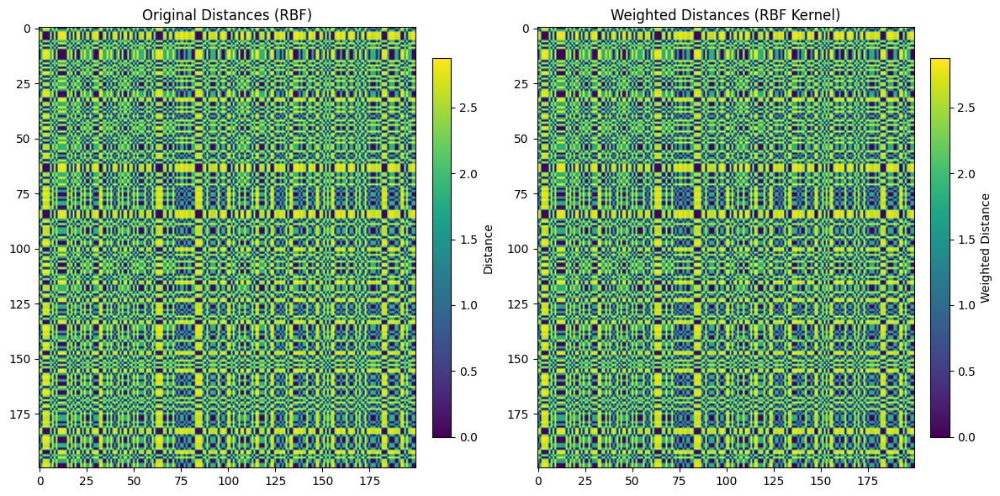

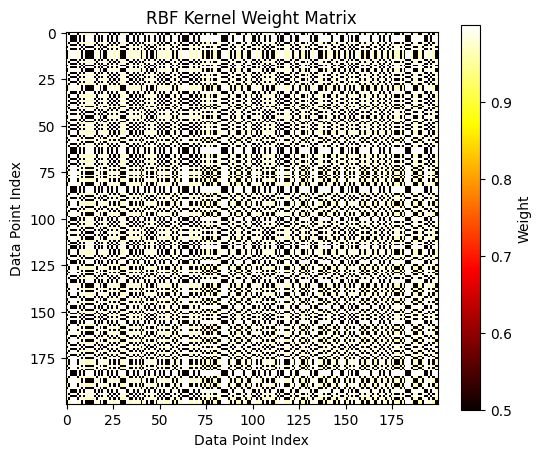

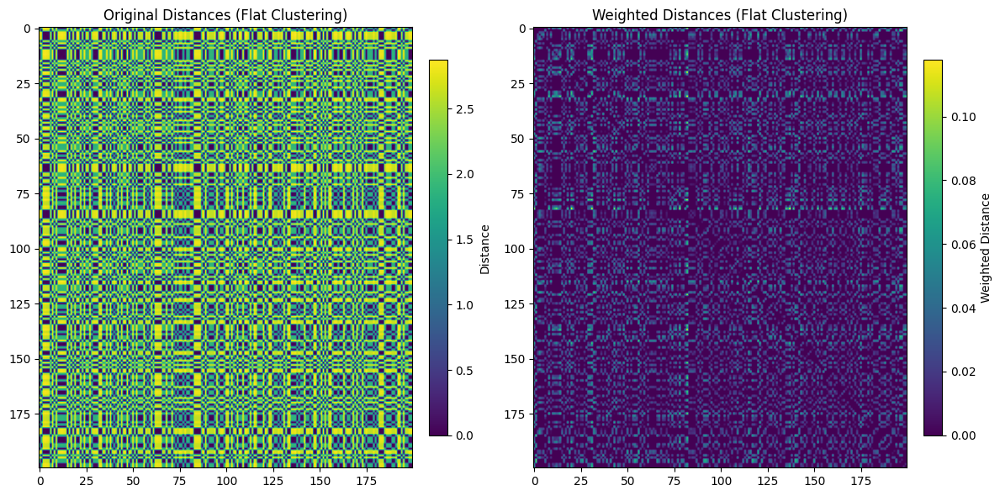

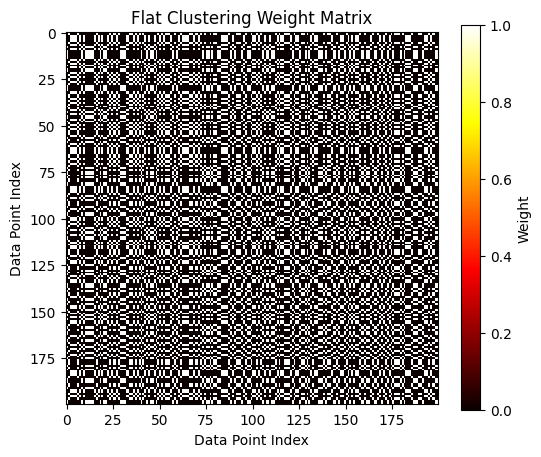

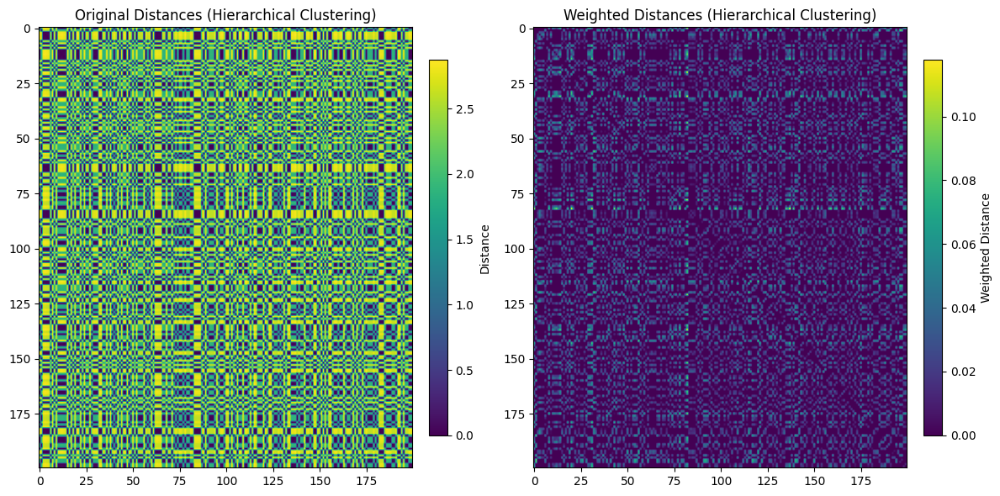

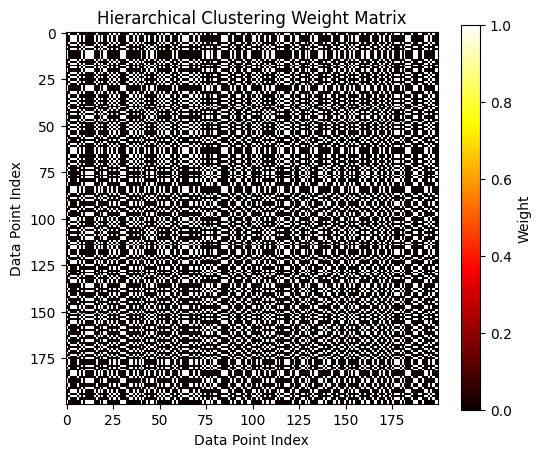

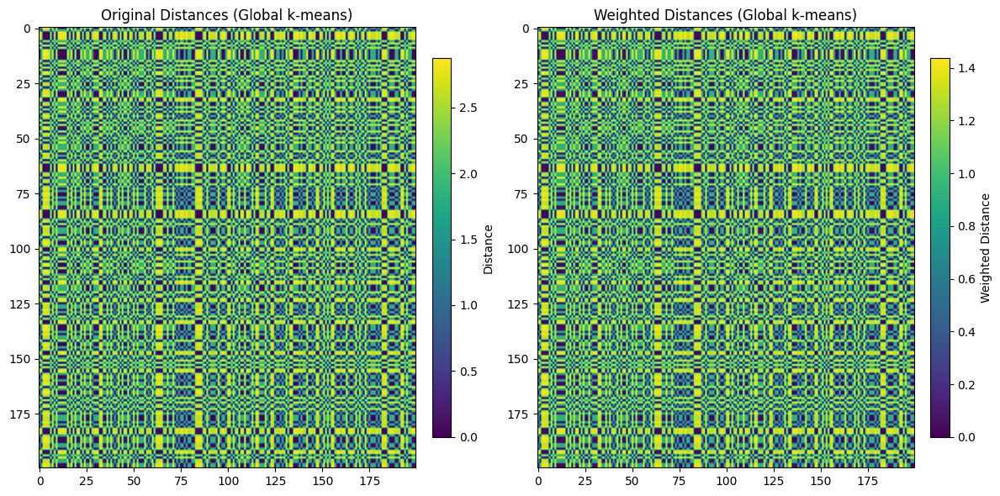

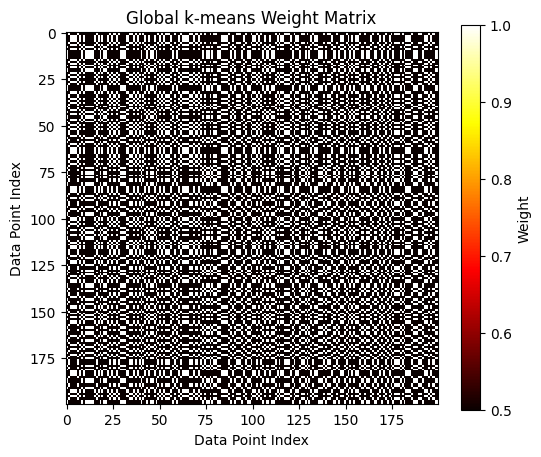

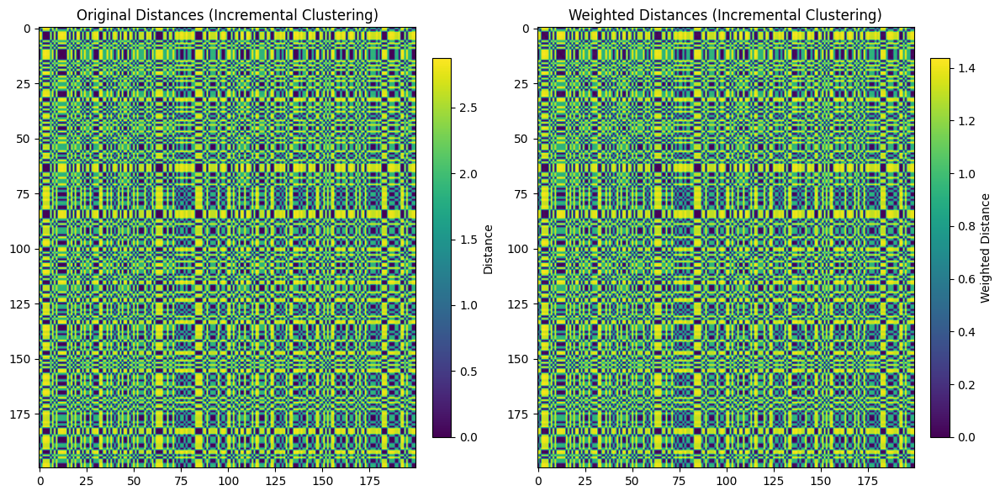

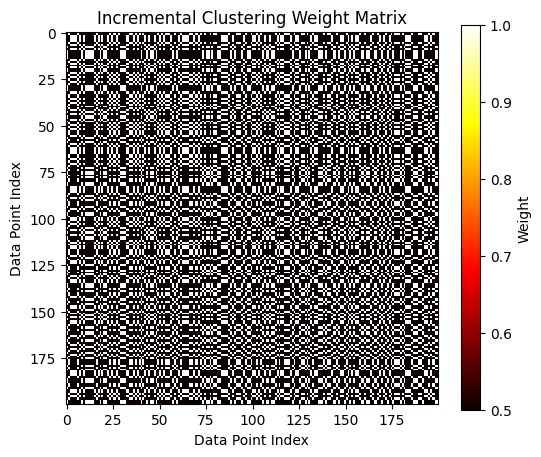


--- Testing with sigma = 0.3 ---


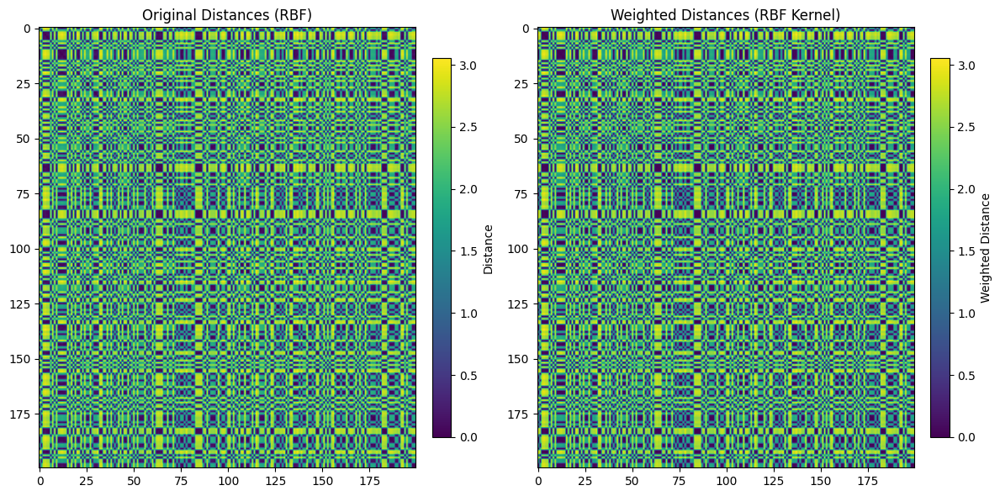

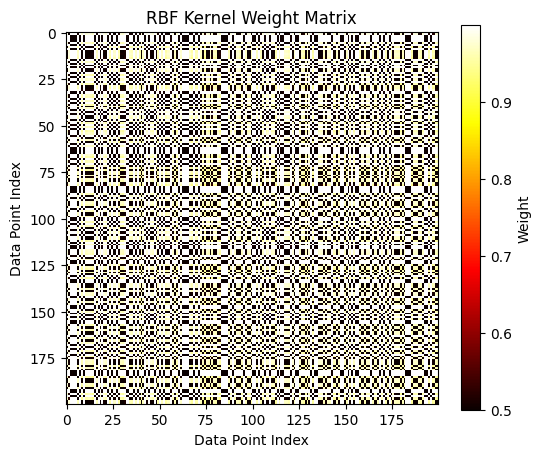

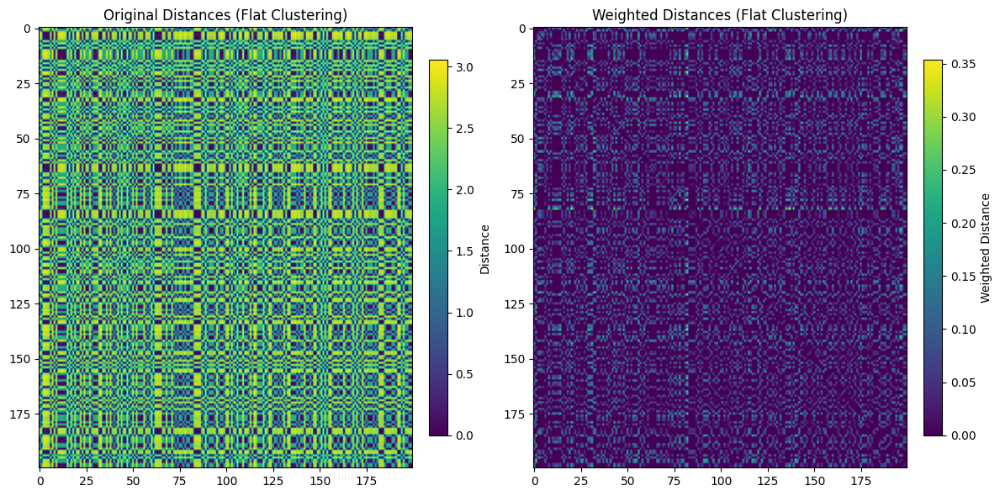

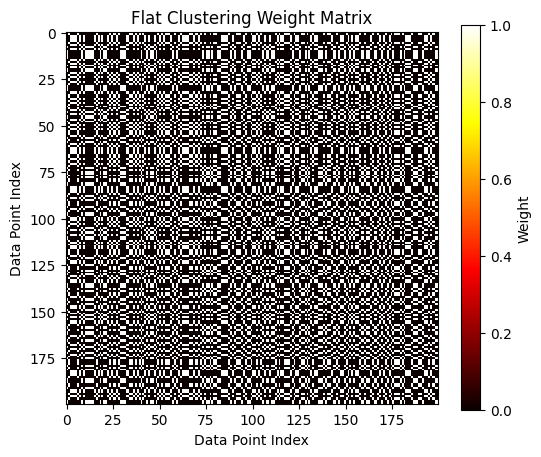

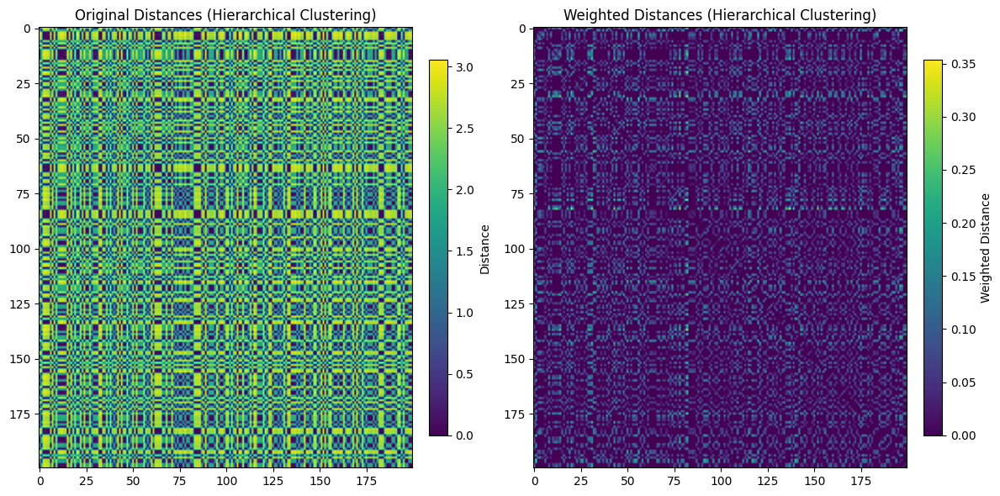

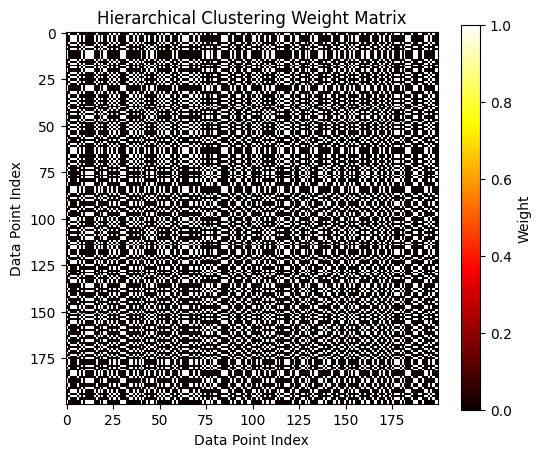

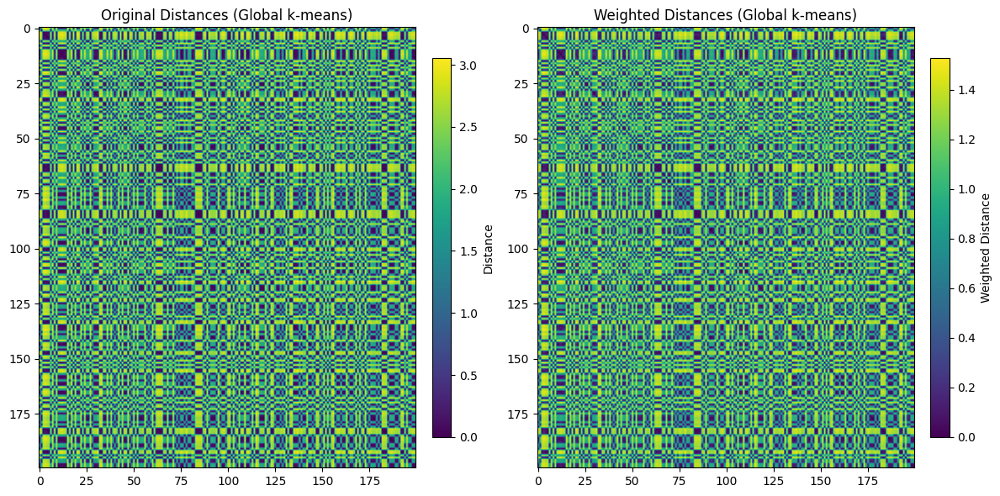

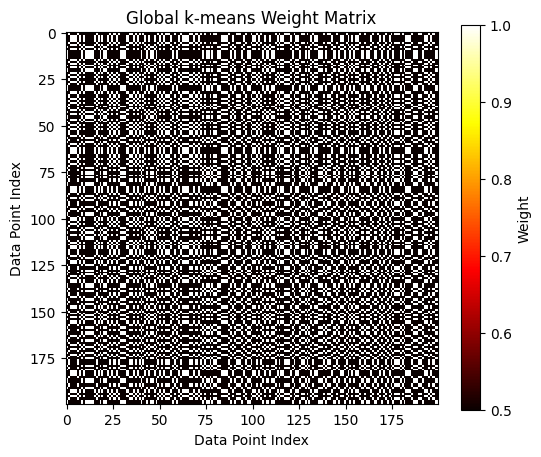

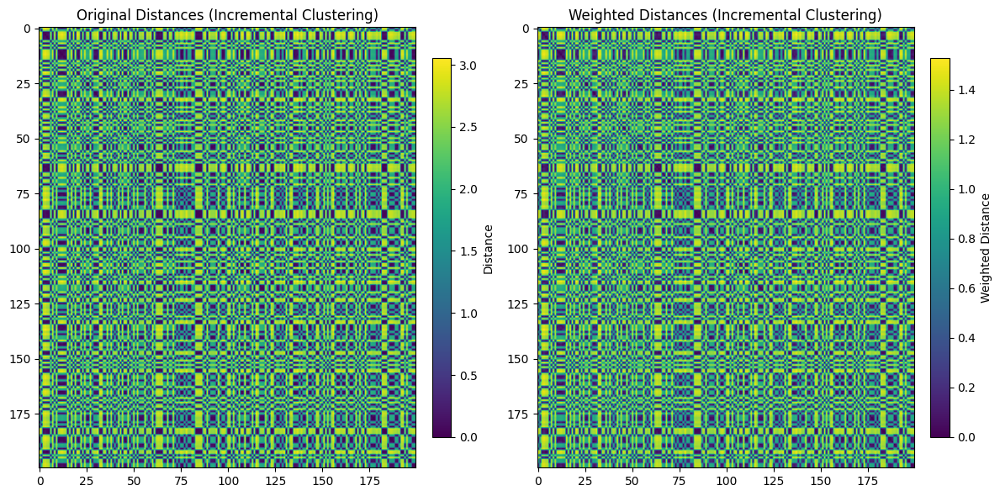

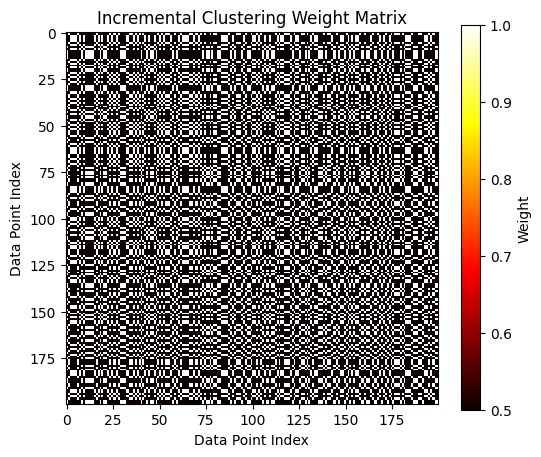


--- Testing with sigma = 0.5 ---


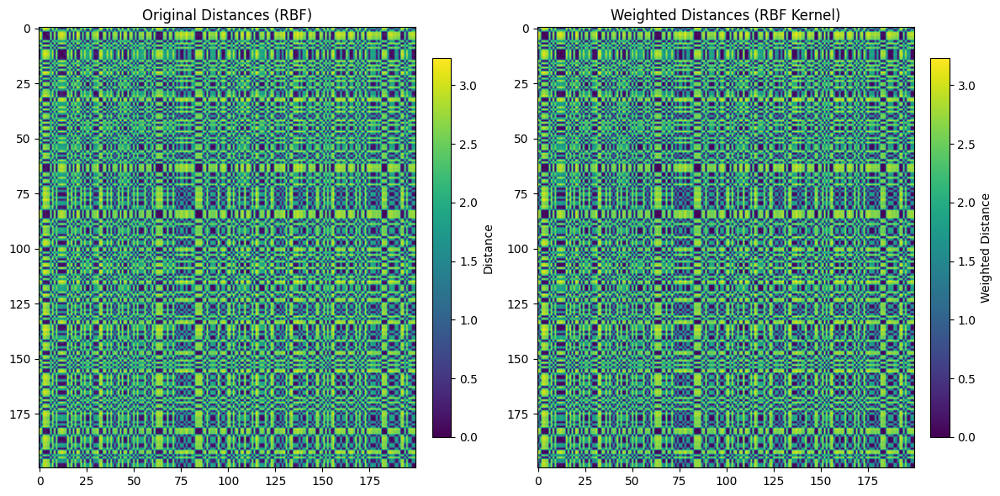

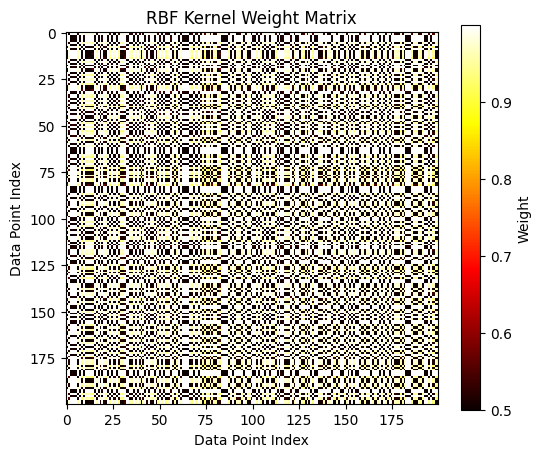

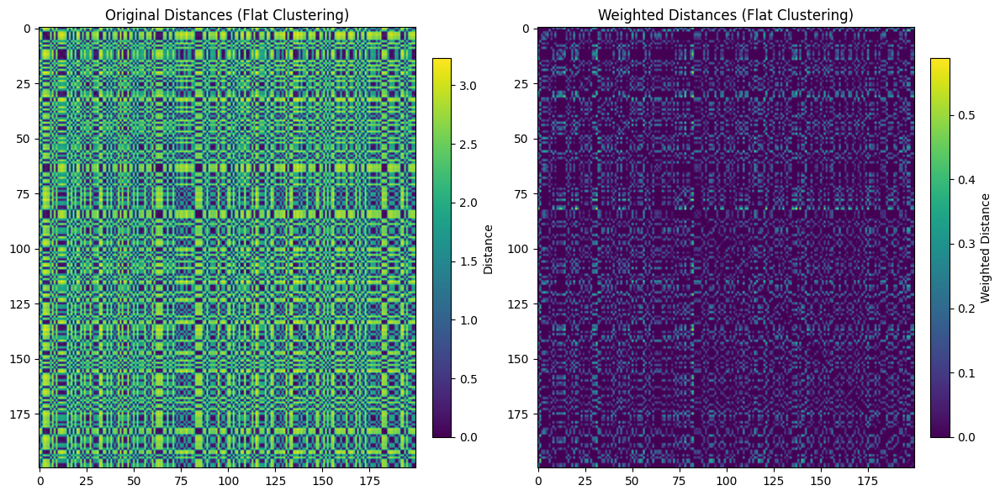

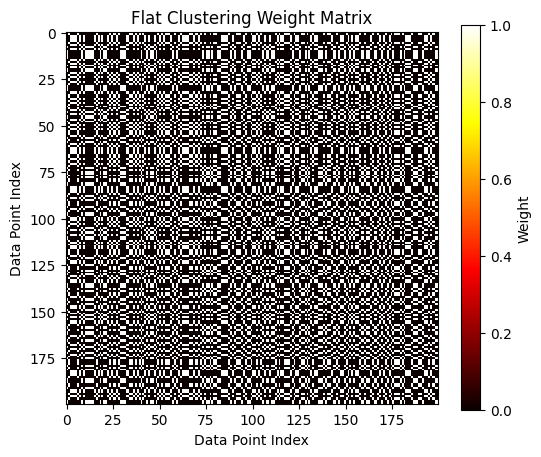

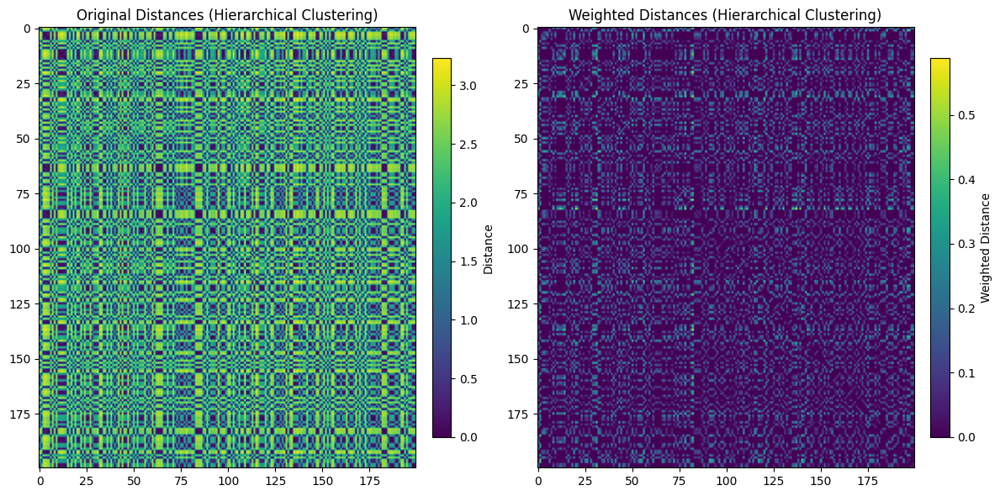

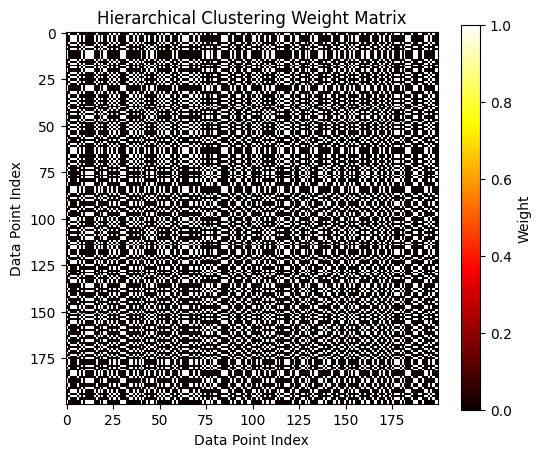

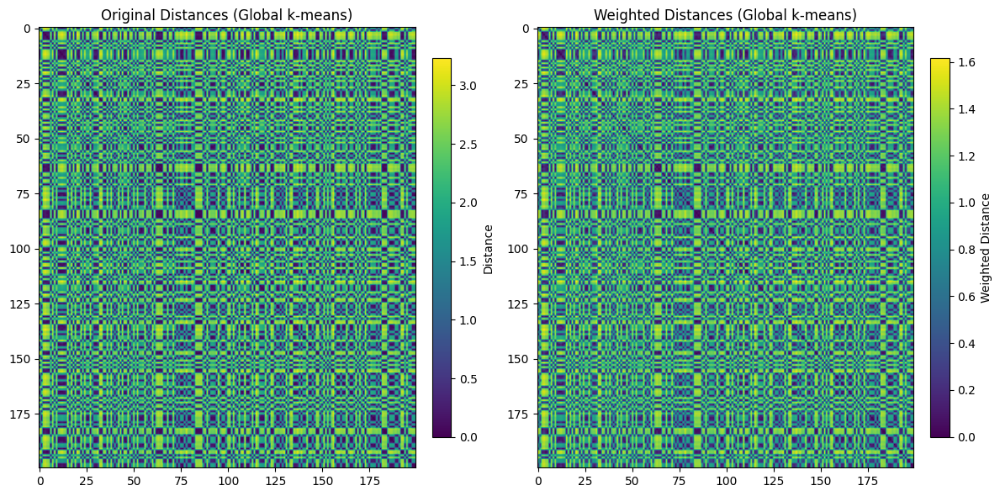

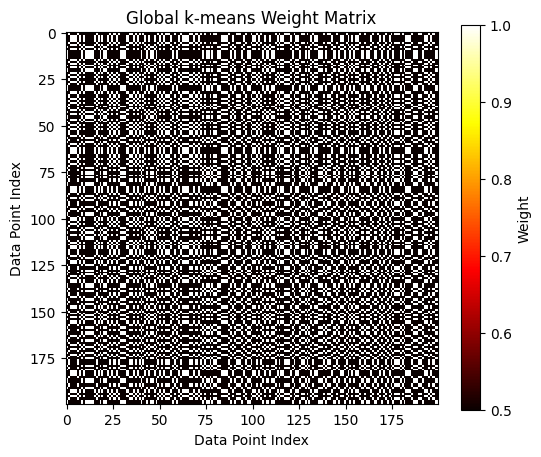

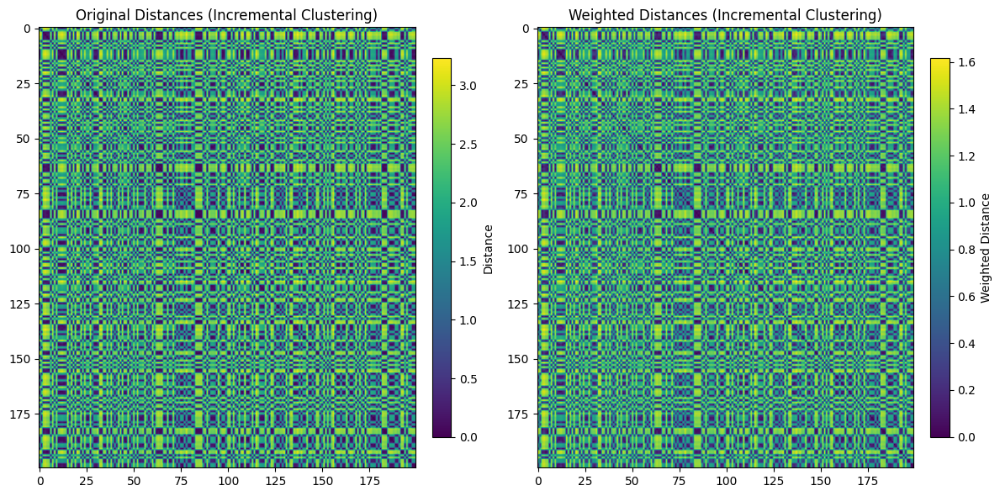

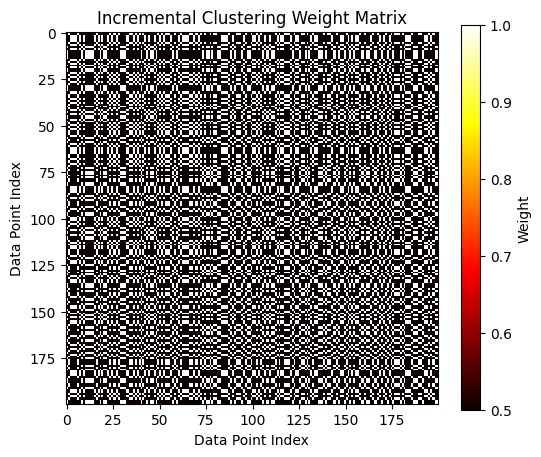


--- Testing with sigma = 0.7 ---


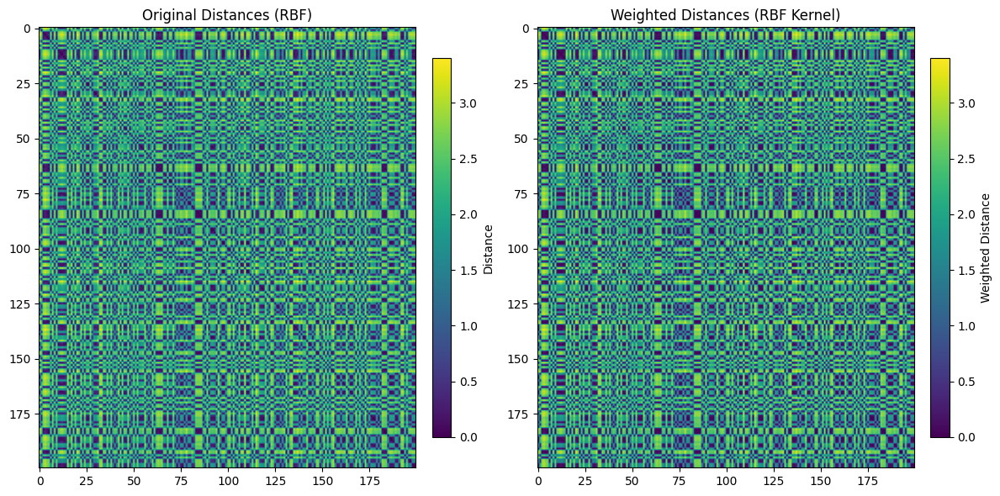

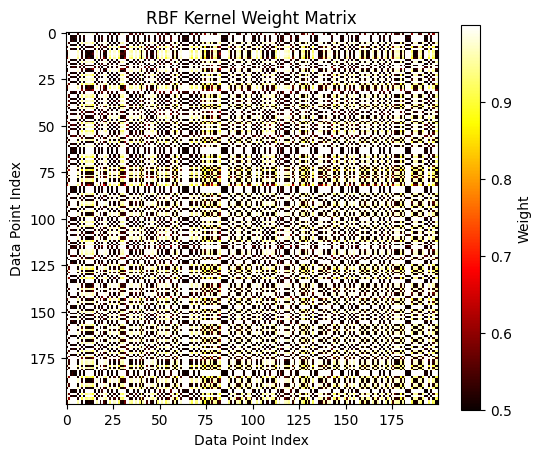

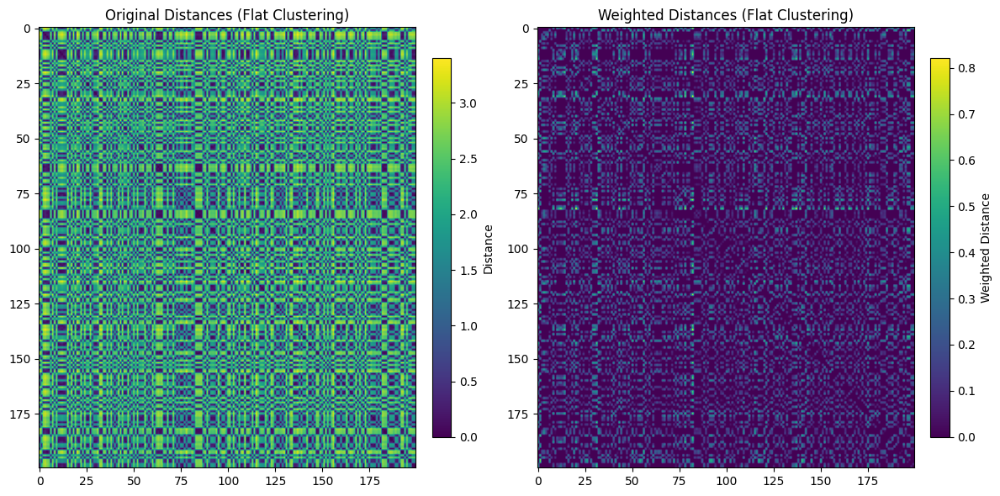

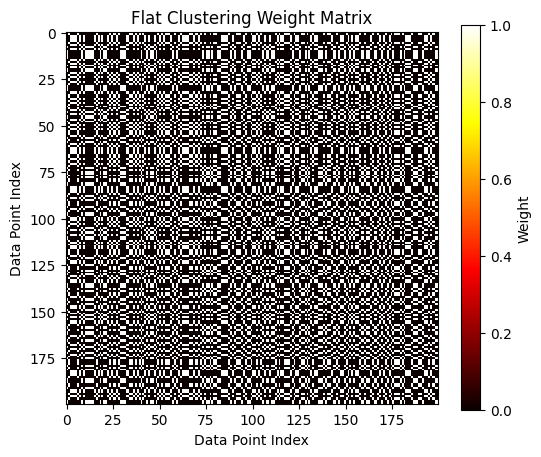

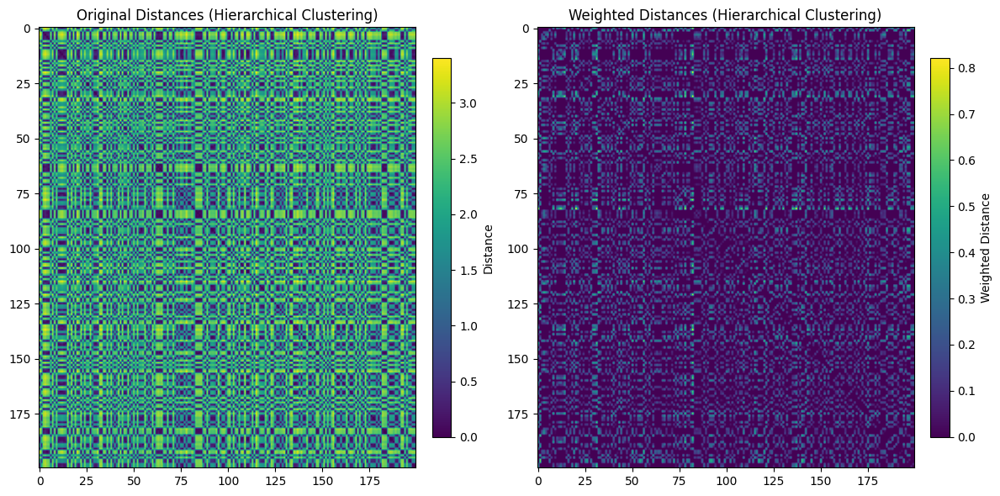

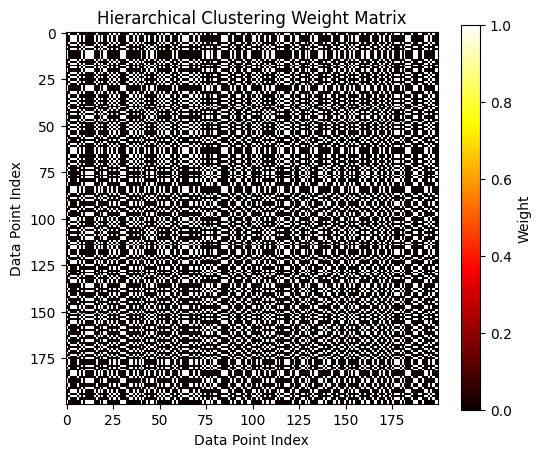

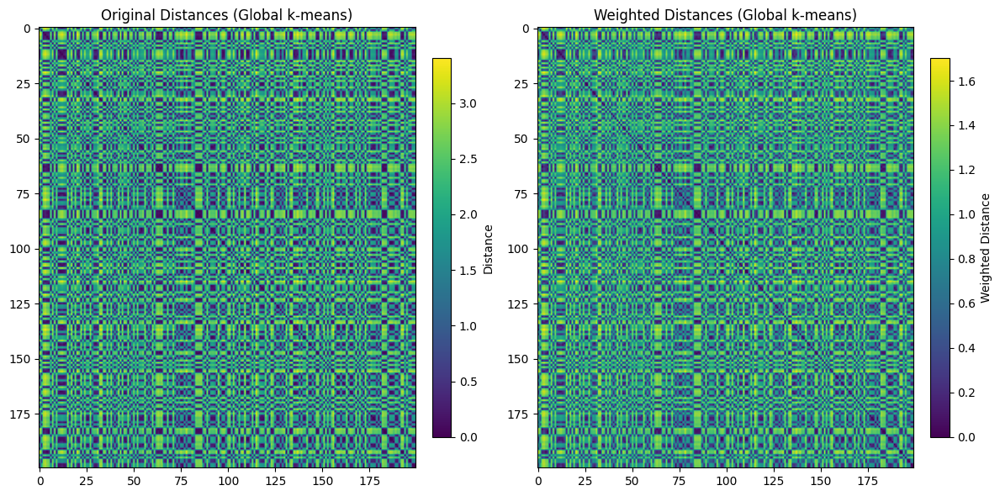

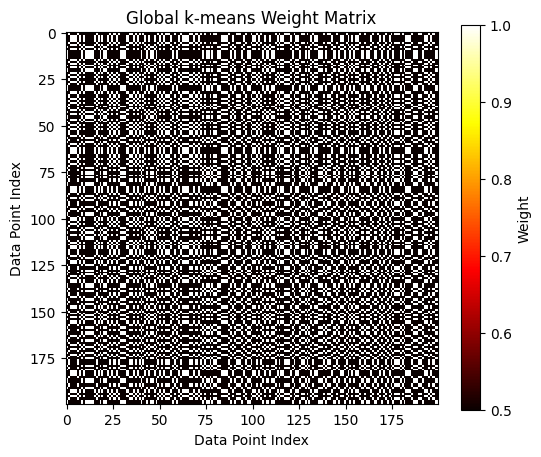

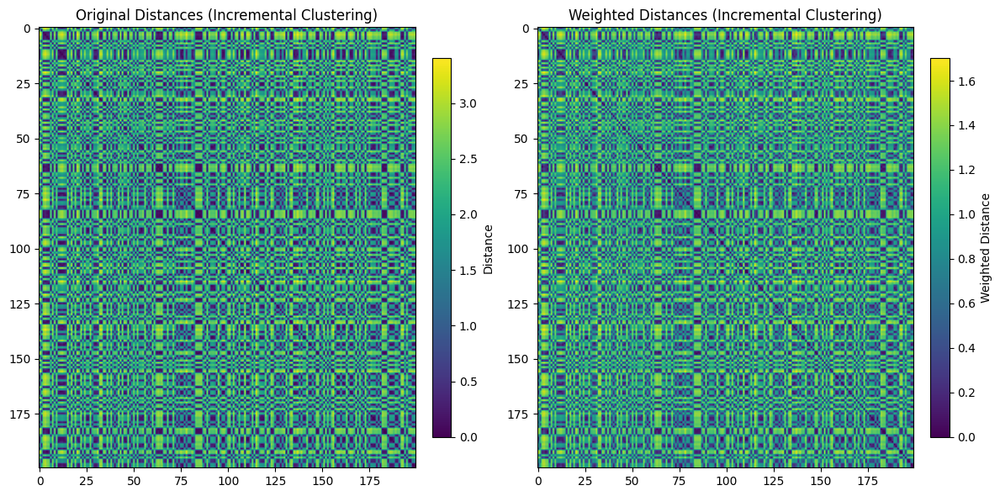

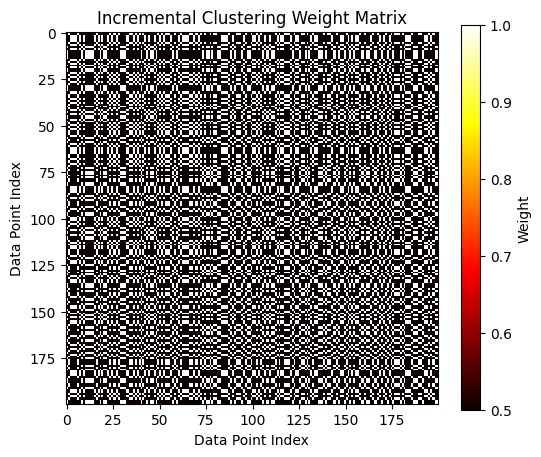


--- Testing with sigma = 1.0 ---


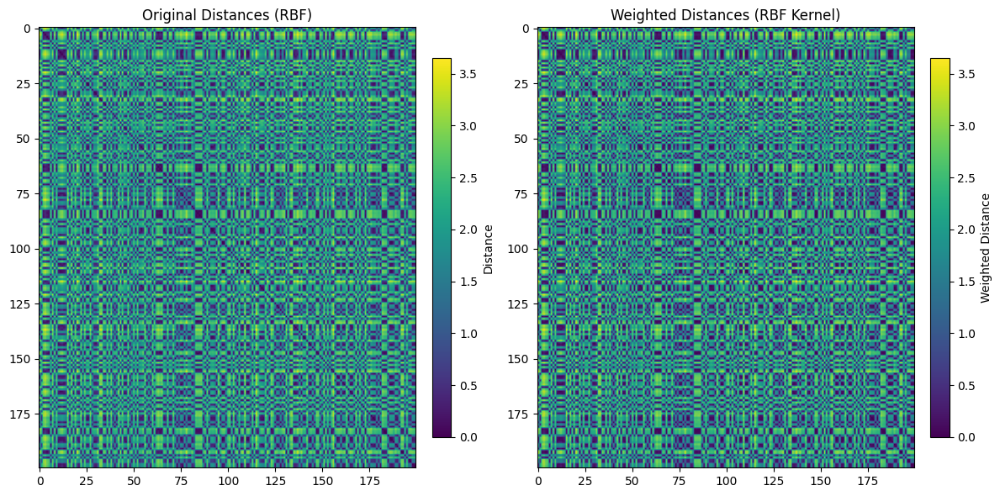

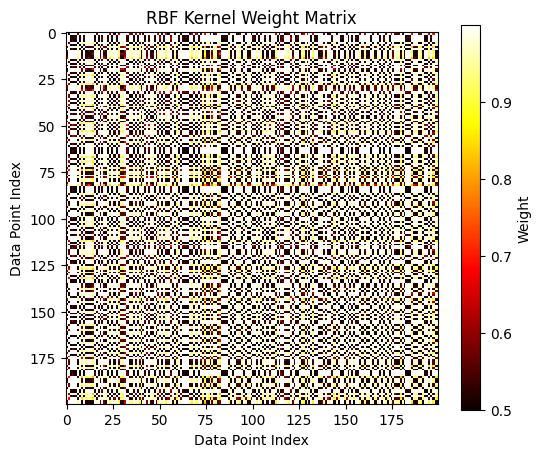

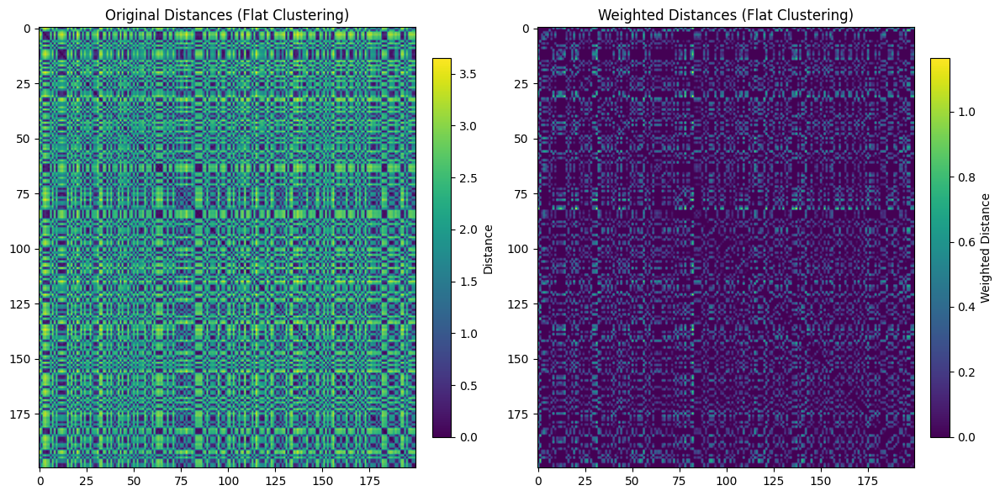

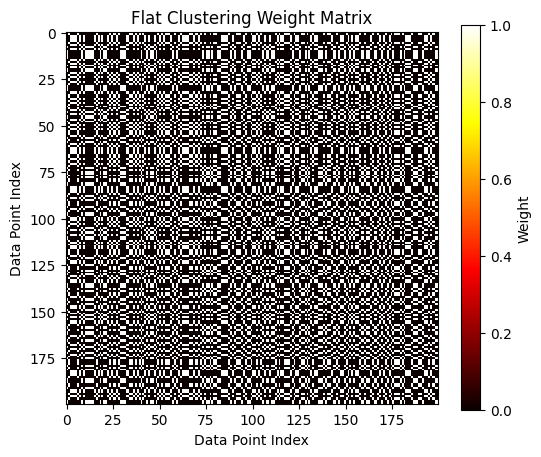

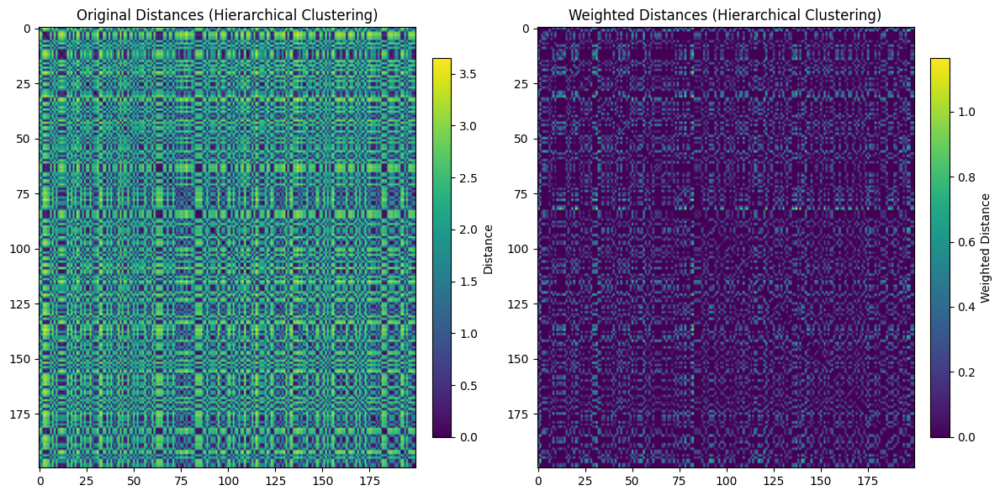

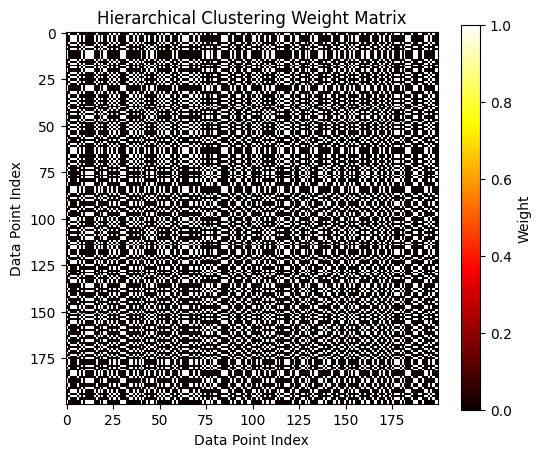

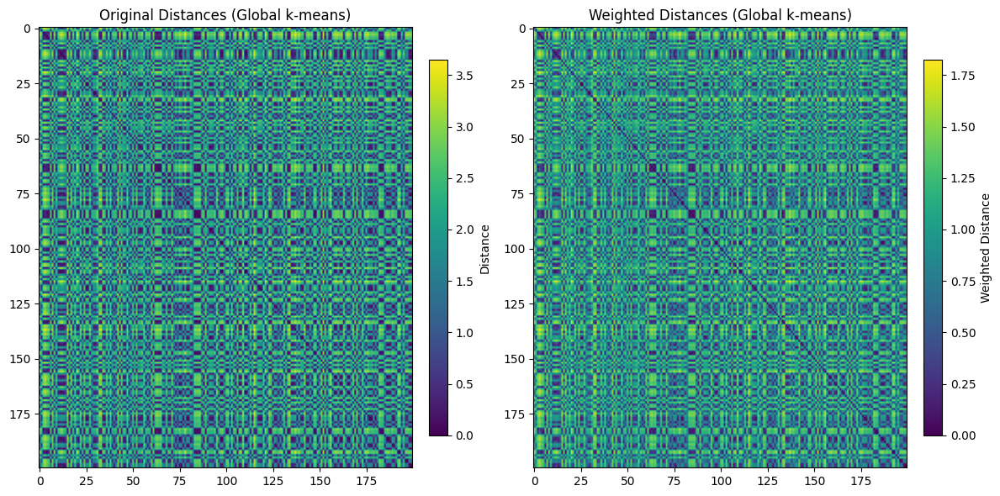

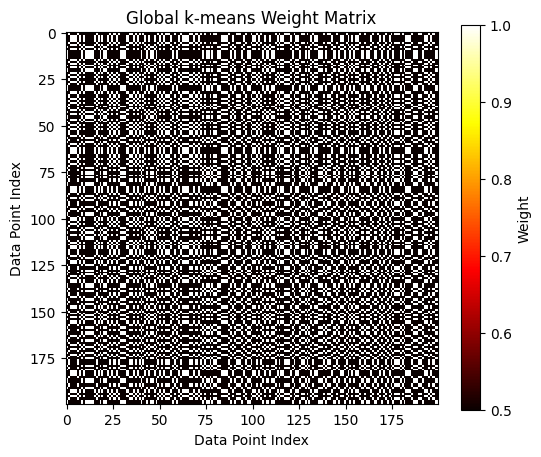

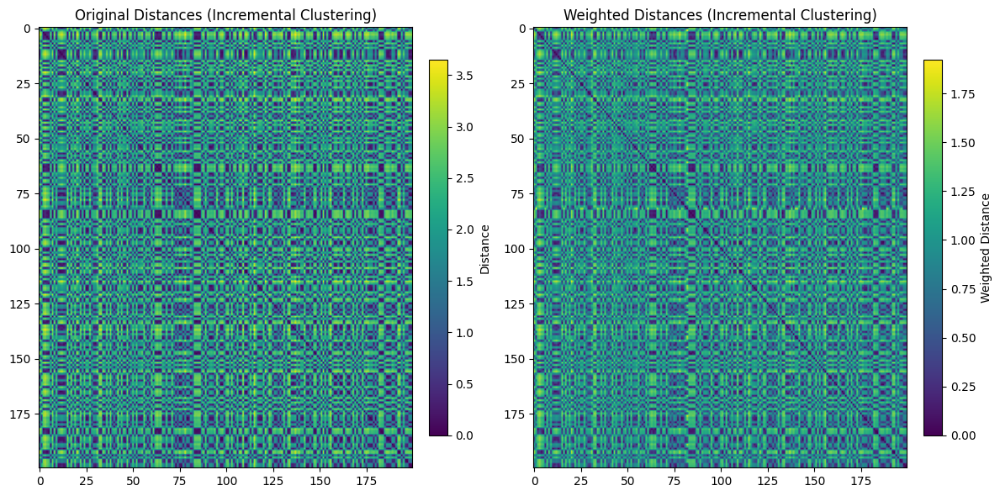

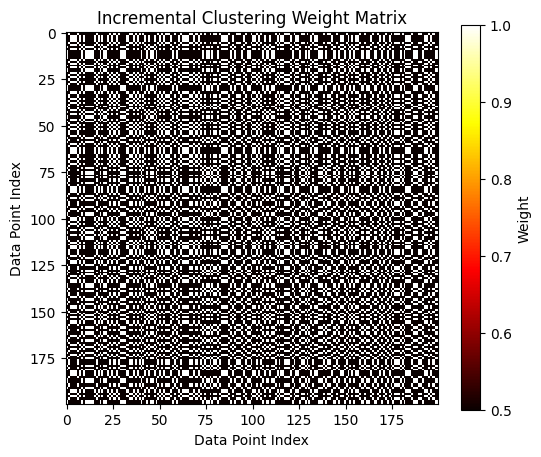

In [208]:
if __name__ == "__main__":
    clustering_results = run_reweighting_experiments()

### **Comparison of Methods**
- **Weighted vs. Original Distances**:
  - For all methods, weighted distances were compared with the original distances.
  - The RBF kernel created smooth transitions between points, while clustering methods emphasized clear group boundaries.
  - Global k-means produced slightly fuzzier groupings compared to other clustering methods.

#### Observations:
- The **RBF kernel** is great for smoothly adjusting weights based on point-to-point similarity.
- **Clustering-based methods** are better for capturing clear group structures.
- **Global k-means** is an alternative but takes longer and may not produce sharp clusters.

Each method works best depending on the goal: smooth adjustments (RBF) vs. defining groups (clustering).